## Main code to download images

In [2]:
#Import requirements
from bs4 import BeautifulSoup
import urllib
import wget
import re
from robobrowser import RoboBrowser
import pandas as pd
import warnings
warnings.filterwarnings("ignore")
import zipfile  


## 1. Read tables from CRTS of all the objects

In [ ]:
df_light_curves.head() #muestra la tabla
ra_col = df_light_curves['ra']
dec_col = df_light_curves['dec']
for index, row in df_light_curves.iterrows():
    #x = np.array([row['ra'], row['dec']])
    ra_coord = row['ra']
    dec_coord = row['dec']
    str_query = str(ra_coord) + ' ' + str(dec_coord) #input para buscar


## 2. Query search on Data Release 3

In [3]:
CRTS_DR3_beta_url = 'http://crts.iucaa.in/crts/'
new_CRTS_DR3_beta_url = 'http://crts.iucaa.in/CRTS/'
DR3 = urllib.request.urlopen(CRTS_DR3_beta_url).read()
soup_DR3 = BeautifulSoup(DR3, "lxml")
print(type(soup_DR3))

<class 'bs4.BeautifulSoup'>


In [ ]:
#Define subsample of objects for each class
list_of_classes = []
list_of_crds = []
#### CSS telescope ####
#SN: 
str_of_crds = '142.63453' + ' ' + '20.60814'
list_of_crds.append(str_of_crds)
object_class = 'SN'
list_of_classes.append(object_class)
#CV:
str_of_crds = '157.35429' + ' ' + '61.47645'
list_of_crds.append(str_of_crds)
object_class = 'CV'
list_of_classes.append(object_class)
#BZ:
str_of_crds = '342.49855' + ' ' + '-12.85467'
list_of_crds.append(str_of_crds)
object_class = 'BZ'
list_of_classes.append(object_class)
#AGN:
str_of_crds = '24.14416' + ' ' + '19.57569'
list_of_crds.append(str_of_crds)
object_class = 'AGN'
list_of_classes.append(object_class)
#FLARES:
str_of_crds = '352.68174' + ' ' + '14.08518'
list_of_crds.append(str_of_crds)
object_class = 'FLARES'
list_of_classes.append(object_class)
#OTHER: 
str_of_crds = '80.22595' + ' ' + '21.99364'
list_of_crds.append(str_of_crds)
object_class = 'OTHER'
list_of_classes.append(object_class)
print(list_of_classes, list_of_crds)

In [4]:
import os
def makedir(outdir):
    if not os.path.exists(outdir):
        os.makedirs(outdir)

In [5]:
#do this for each TO
browser = RoboBrowser()
browser.open(CRTS_DR3_beta_url)
form = browser.get_form(action='/CRTS/imaging')
# print(form)
def download_images_per_object (crds_RA, crds_DEC, obj_class, object_id):
    #crdsRA/DEC must be a string 
    #form['imaging-search-query'].value = '332.64277 -22.66323' #'X' + ' ' + 'Y'
    form['imaging-search-query'].value = crds_RA + ' ' + crds_DEC
    form['imaging-search-radius'].value = '0.1'
    browser.submit_form(form) 
    #search: se actualiza la variable de browser 
    #duda: hay una forma de pedir la nueva url de esa pagina?

    #Find all the "values" or images for that object
    num = browser.find("div", {"class" : "Found"})
    complete_string = num.getText()
    total = [int(s) for s in complete_string.split() if s.isdigit()] #extraer el numero que corresponde a las ims
    list_of_numbers = list(range(0, int(total[0])-1))
    str_list_values = []
    for i in range(int(total[0])):
        a = i
        str_list_values.append(str(a))
    
    #extract information from the table
    #browser_html_code = browser.parsed() #type: <class 'bs4.element.ResultSet'>
    #first_element = browser_html_code[0] #type: <class 'bs4.element.Tag'>
    #text = first_element.getText()

    #x = browser.find("div", {"id" : "outTable"})
    #select only the table 
    read_table = browser.find("table", {"class" : "sortable"})  #type: <class 'bs4.element.Tag'>
    string_all_rows_table = read_table.getText()
    #print('what I found:', string_all_rows_table)
    list_all_rows_table = string_all_rows_table.strip().split()
    data_information = list_all_rows_table[4:]
    #extract info from each column
    center_ra_list = data_information[::4]
    center_dec_list = data_information[1::4] 
    obs_date_list = data_information[2::4]
    file_name_list = data_information[3::4]
    #create dataframe
    data = {list_all_rows_table[0] : center_ra_list, list_all_rows_table[1] : center_dec_list, 
        list_all_rows_table[2] : obs_date_list, list_all_rows_table[3] : file_name_list}
    df_per_object = pd.DataFrame(data)
    df_per_object = df_per_object.sort_values('OBS-DATE')
    df_per_object.head()
    #df_per_object.to_pickle(complete_path + file_name[0:-4] + '.pkl')
    #print('html code:', browser.parsed()) #lo que está viendo de html

    #Proceed to download all the images of the object 
    print('*************')
    new_form = browser.get_form(action='/crts/download')
    print(new_form)
    # image = browser.get_form(class_='imaging-search-query')
    #print(image)
    # extraer todos los values con browser.find

    #new_form['downloadSelector'] = ['49','2'] #chulear el que tenga ese value
    new_form['downloadSelector'] = str_list_values
    browser.submit_form(new_form) #queda con un click here to download/se actualiza la pagina

    #se abre otra pagina
    link =browser.find("a", { "class" : "downloadLink" })
    download_zip = link.get('href')
    base_url = 'http://crts.iucaa.in'
    download_zip = base_url + download_zip
    data_dir = '/home/oem/Documentos/Astronomy/CRTS/Data/'
    #object_class = obj_class
    #file_name = 'first_object.zip'
    file_name = object_id 
    complete_path = data_dir + obj_class + '/' + file_name + '.zip'
    wget.download(download_zip, complete_path)  
    makedir(complete_path[0:-4])
    zip = zipfile.ZipFile(complete_path)  
    zip.extractall(complete_path[0:-4])  
    #print(download_zip)
    #save DF file with metadata
    df_per_object.to_pickle(complete_path[0:-4] + '/' + file_name + '.pkl')
    return df_per_object

 

In [ ]:
cont = 0
for object_class in list_of_classes:
    download_images_per_object(list_of_crds[cont], object_class, 'first_object')
    cont = cont + 1

## 3. Read fits images

In [3]:
from astropy.io import fits
from astropy import wcs
import sys
import os
import glob
import cv2
import gzip
import numpy as np
import pandas as pd
# Set up matplotlib and use a nicer set of plot parameters
%config InlineBackend.rc = {}
import matplotlib
#matplotlib.rc_file("../../templates/matplotlibrc")
import matplotlib.pyplot as plt
%matplotlib inline
from matplotlib.colors import LogNorm

In [ ]:
out_dir = '/home/oem/Documentos/Astronomy/CRTS/Data/'
object_class = 'SN'
file_name = 'first_object.zip'
complete_path = out_dir + object_class + '/'
path_to_file = complete_path + file_name[0:-4] + '/'
df_per_object = pd.read_pickle(path_to_file + 'first_object.pkl')
df_per_object = df_per_object.sort_values('OBS-DATE')

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 29.10521228  92.68075646]]
Date of observation: 2004-01-28
Pixel coordinates: [[ 60.02257106  59.98735701]]


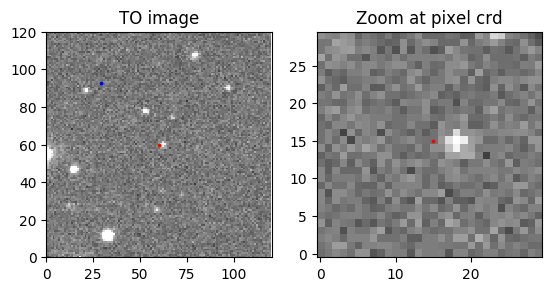

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 14.25244311  93.60345635]]
Date of observation: 2004-01-28
Pixel coordinates: [[ 60.02256929  59.98735704]]


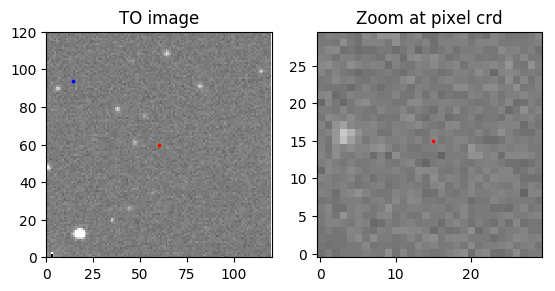

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  9.15597781  91.08339696]]
Date of observation: 2004-01-28
Pixel coordinates: [[ 60.0225711   59.98735657]]


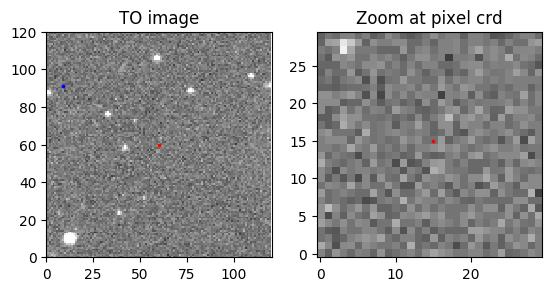

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 22.10238562  91.37247473]]
Date of observation: 2004-01-28
Pixel coordinates: [[ 60.02257172  59.9873587 ]]


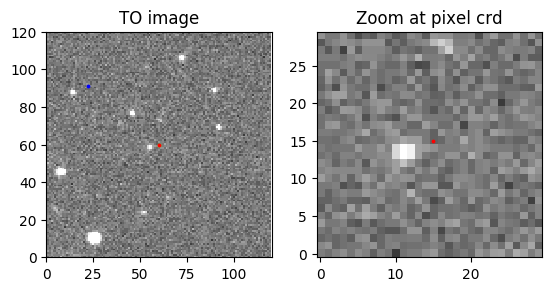

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 31.86370567  74.18405107]]
Date of observation: 2004-02-13
Pixel coordinates: [[ 60.02260239  59.98743523]]


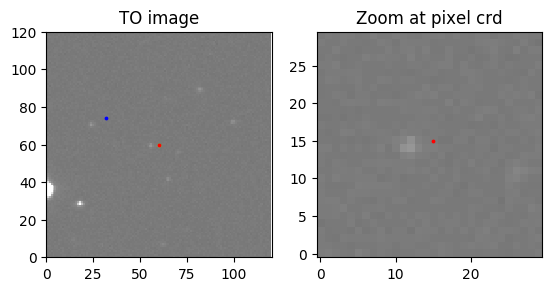

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 35.25259816  74.78719916]]
Date of observation: 2004-02-13
Pixel coordinates: [[ 60.02259886  59.98742511]]


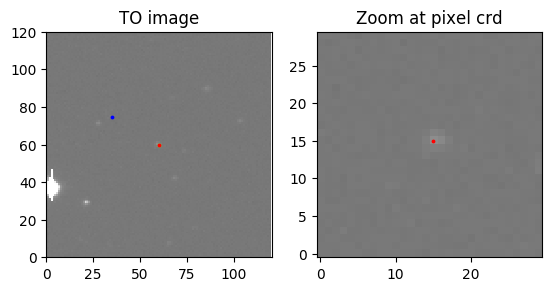

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 20.60578859  75.33120266]]
Date of observation: 2004-02-13
Pixel coordinates: [[ 60.02258306  59.98736015]]


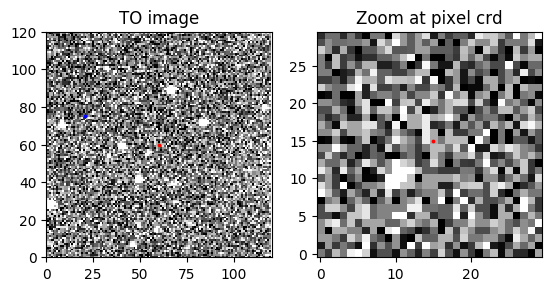

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 19.39056833  75.70532519]]
Date of observation: 2004-02-13
Pixel coordinates: [[ 60.02259536  59.98741837]]


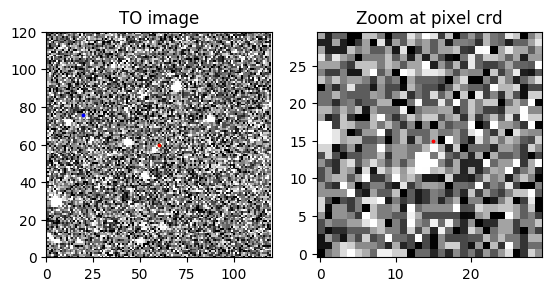

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 24.90558702   6.8176564 ]]
Date of observation: 2004-04-14
Pixel coordinates: [[ 60.02635312  69.98695808]]


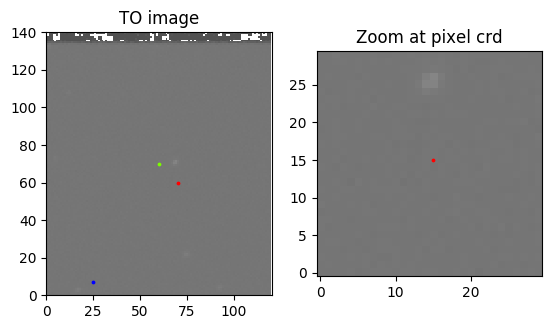

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 41.0990916   4.4087044]]
Date of observation: 2004-04-14
Pixel coordinates: [[ 60.02635882  69.98696521]]


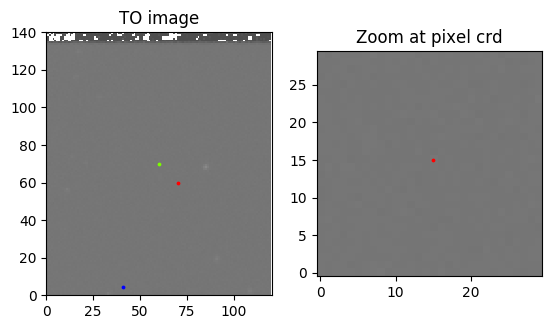

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 31.81138896   8.88751739]]
Date of observation: 2004-04-14
Pixel coordinates: [[ 60.02634585  69.98694425]]


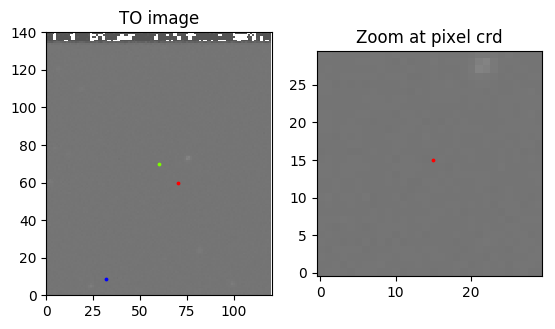

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 44.40877017   8.18661261]]
Date of observation: 2004-04-14
Pixel coordinates: [[ 60.02634926  69.98695145]]


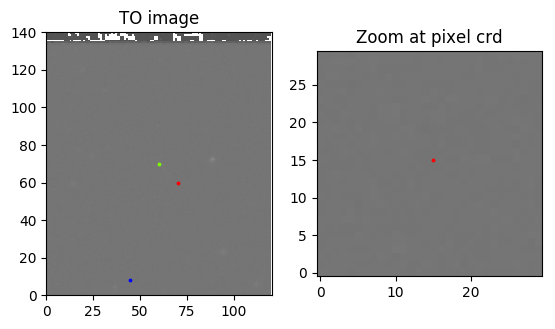

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 11.97410705  69.62482765]]
Date of observation: 2004-05-03
Pixel coordinates: [[ 60.02260857  59.98745328]]


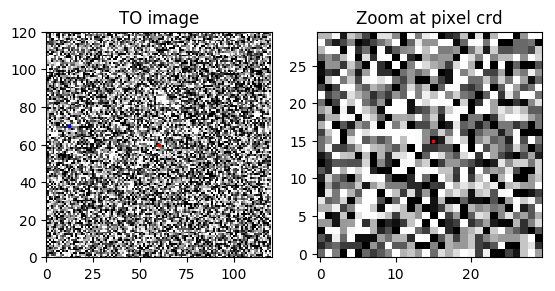

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 19.39200527  68.67099068]]
Date of observation: 2004-05-03
Pixel coordinates: [[ 60.02261077  59.9874579 ]]


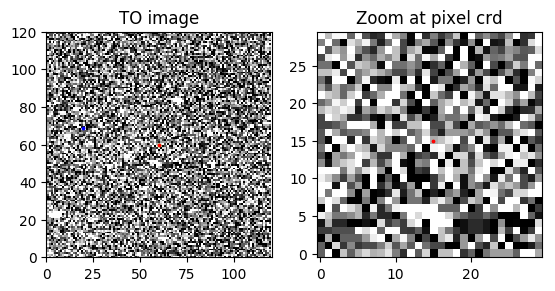

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 10.96831379  68.29479221]]
Date of observation: 2004-05-03
Pixel coordinates: [[ 60.02261352  59.98746158]]


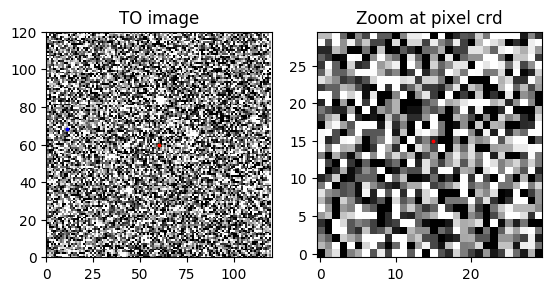

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 19.63351524  67.36439028]]
Date of observation: 2004-05-03
Pixel coordinates: [[ 60.02261433  59.98746644]]


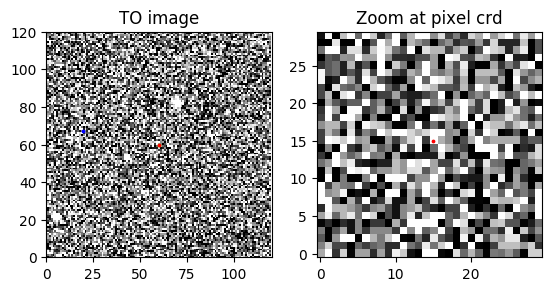

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 28.76269511  60.31030445]]
Date of observation: 2004-12-02
Pixel coordinates: [[ 60.02545451  67.98688509]]


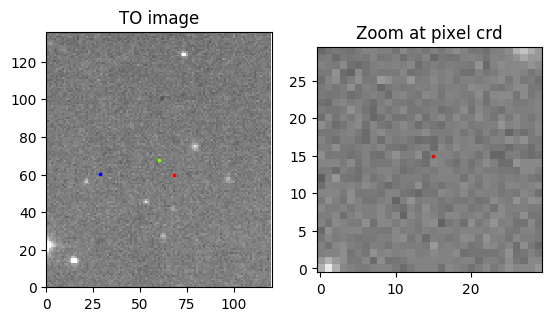

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 19.89311654  55.51773815]]
Date of observation: 2004-12-02
Pixel coordinates: [[ 60.02545804  67.98688554]]


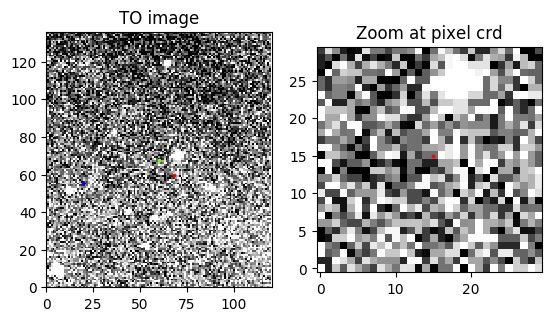

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 22.93879805  60.95104719]]
Date of observation: 2004-12-02
Pixel coordinates: [[ 60.02545215  67.98688167]]


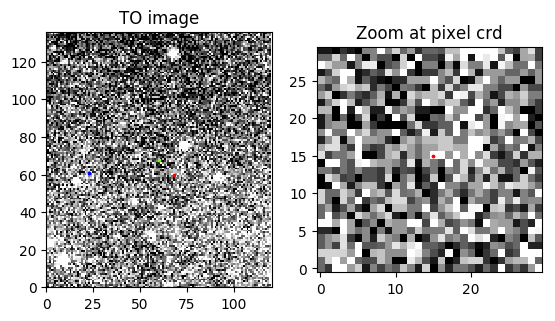

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 12.36582374  57.45460747]]
Date of observation: 2004-12-02
Pixel coordinates: [[ 60.02545515  67.98688407]]


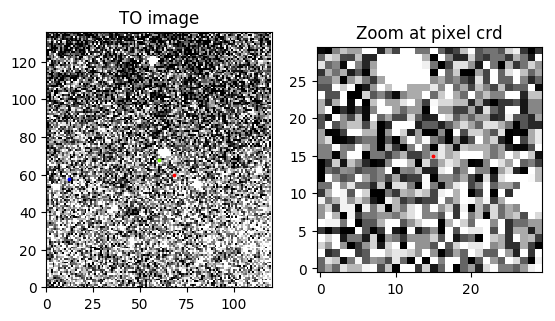

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 28.3494393   50.91197866]]
Date of observation: 2004-12-11
Pixel coordinates: [[ 60.02254629  59.9872843 ]]


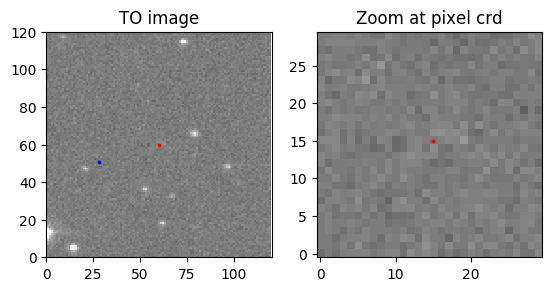

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 34.65977961  55.43569238]]
Date of observation: 2004-12-11
Pixel coordinates: [[ 60.02254115  59.98727766]]


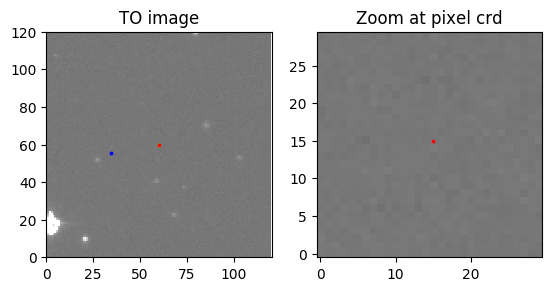

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 14.94606618  52.46926229]]
Date of observation: 2004-12-11
Pixel coordinates: [[ 60.02254511  59.98728103]]


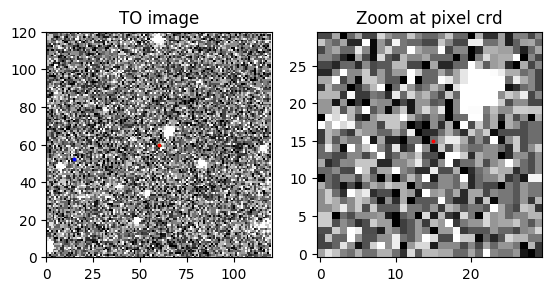

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 18.8924028   57.92466252]]
Date of observation: 2004-12-11
Pixel coordinates: [[ 60.02253846  59.9872753 ]]


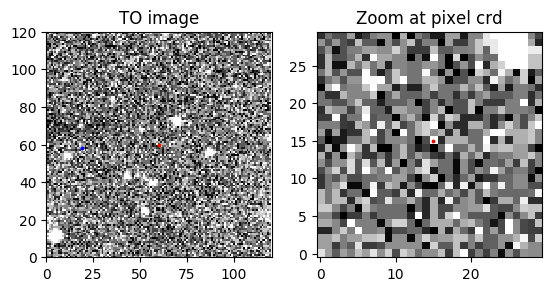

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  13.08670265  112.44694891]]
Date of observation: 2004-12-21
Pixel coordinates: [[ 60.02249967  59.98728433]]


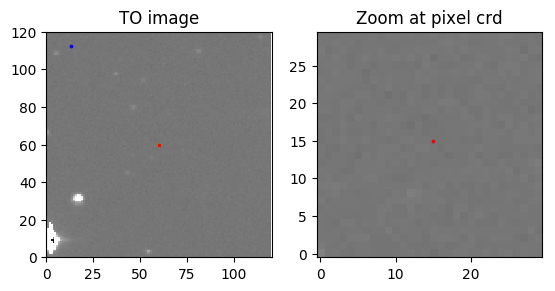

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  20.25151382  105.74201977]]
Date of observation: 2004-12-21
Pixel coordinates: [[ 60.02250654  59.98729151]]


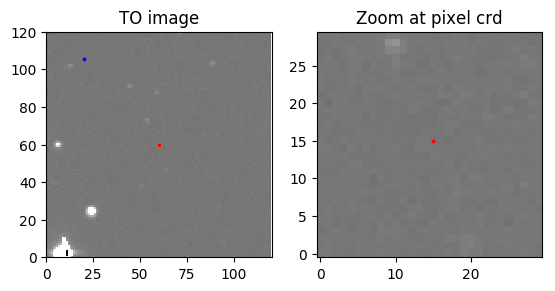

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  21.48458986  110.05799546]]
Date of observation: 2004-12-21
Pixel coordinates: [[ 60.02250275  59.9872866 ]]


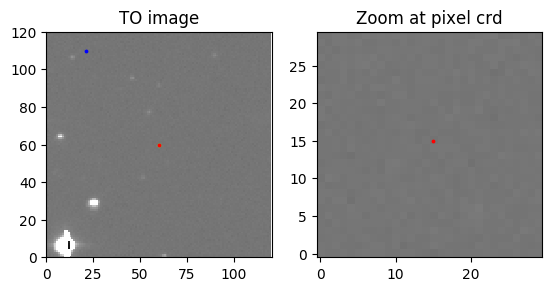

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  11.36200644  107.87607048]]
Date of observation: 2004-12-21
Pixel coordinates: [[ 60.02250493  59.98728942]]


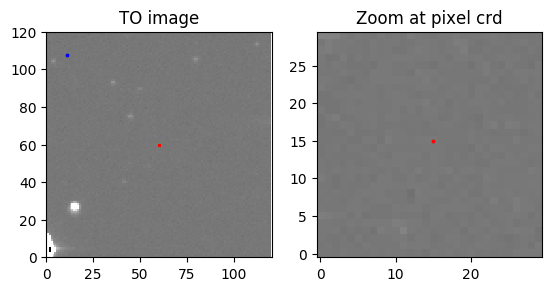

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 20.01642955  90.83903558]]
Date of observation: 2005-01-15
Pixel coordinates: [[ 60.02251501  59.98728202]]


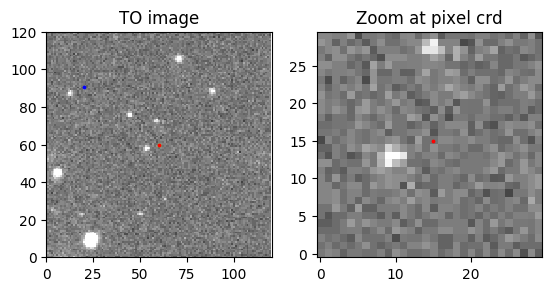

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 24.36449649  85.88472781]]
Date of observation: 2005-01-15
Pixel coordinates: [[ 60.0225198   59.98728759]]


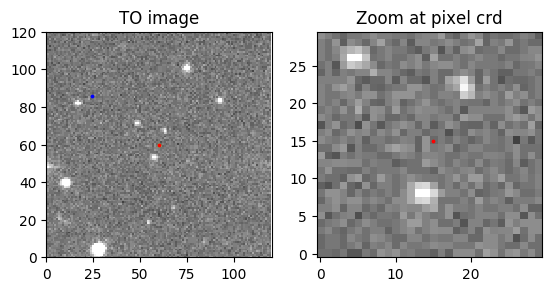

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 16.14320378  86.12965762]]
Date of observation: 2005-01-15
Pixel coordinates: [[ 60.02251936  59.98728535]]


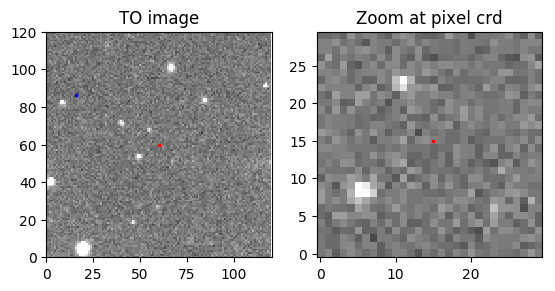

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 26.80130046  88.20962236]]
Date of observation: 2005-01-15
Pixel coordinates: [[ 60.02251685  59.98728215]]


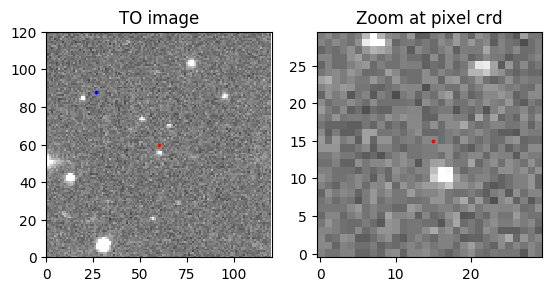

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 31.2230923   61.20522782]]
Date of observation: 2005-02-01
Pixel coordinates: [[ 60.0226076   59.98736573]]


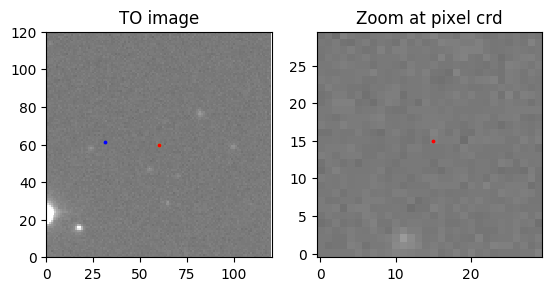

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 40.74503522  58.73186712]]
Date of observation: 2005-02-01
Pixel coordinates: [[ 60.0226106   59.98737049]]


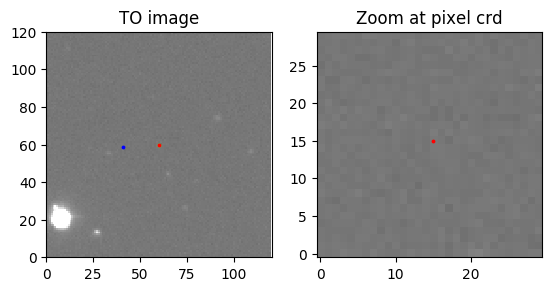

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 32.70098444  65.5411158 ]]
Date of observation: 2005-02-01
Pixel coordinates: [[ 60.02260223  59.98735827]]


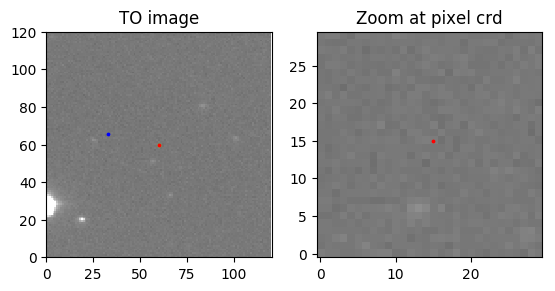

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 40.59304184  63.5980651 ]]
Date of observation: 2005-02-01
Pixel coordinates: [[ 60.02260443  59.98736307]]


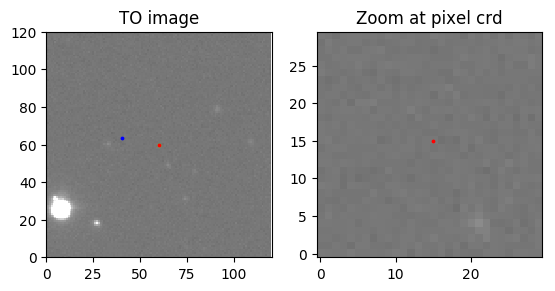

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 30.73681896  39.79159277]]
Date of observation: 2005-03-01
Pixel coordinates: [[ 60.02262223  59.98736547]]


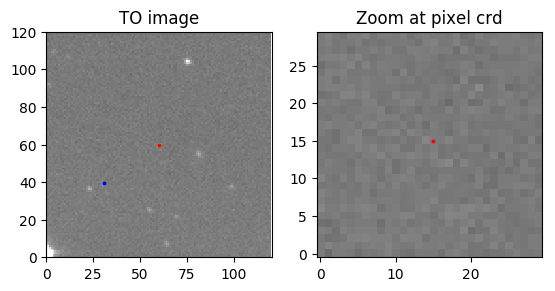

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 22.04380461  42.61674059]]
Date of observation: 2005-03-01
Pixel coordinates: [[ 60.02261936  59.98736229]]


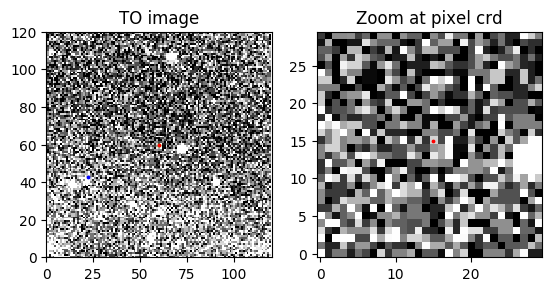

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 20.13610361  37.77420833]]
Date of observation: 2005-03-01
Pixel coordinates: [[ 60.02262459  59.98736921]]


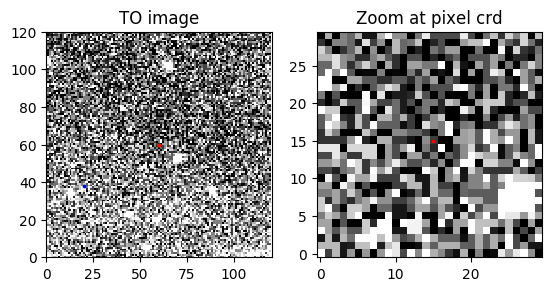

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 29.05656083  35.31875839]]
Date of observation: 2005-03-01
Pixel coordinates: [[ 60.02262713  59.98737304]]


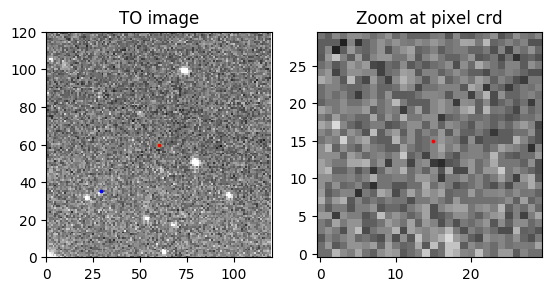

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 25.14291279  78.20997815]]
Date of observation: 2005-04-01
Pixel coordinates: [[ 60.02252684  59.98730318]]


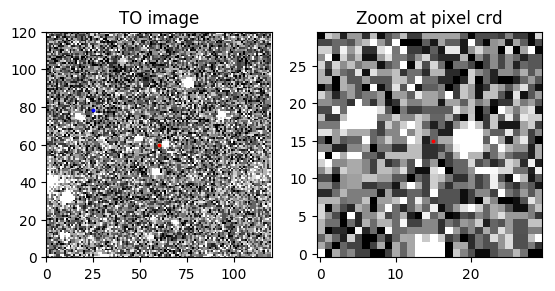

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 29.93205734  72.51447806]]
Date of observation: 2005-04-01
Pixel coordinates: [[ 60.02253449  59.98731294]]


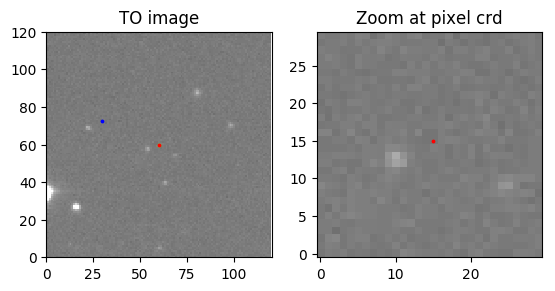

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 32.25763605  76.15449377]]
Date of observation: 2005-04-01
Pixel coordinates: [[ 60.02252921  59.98730613]]


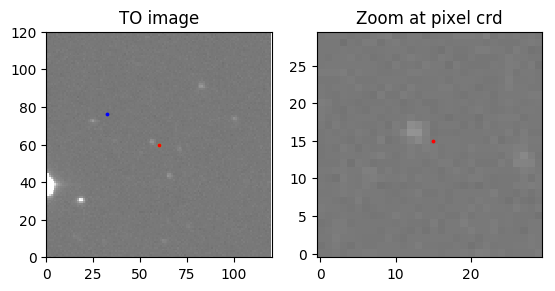

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 21.60820708  74.04450437]]
Date of observation: 2005-04-01
Pixel coordinates: [[ 60.02253198  59.98730946]]


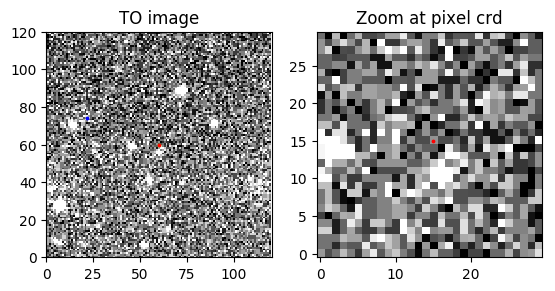

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 22.15541796  38.18862661]]
Date of observation: 2005-04-10
Pixel coordinates: [[ 60.02255978  59.98731722]]


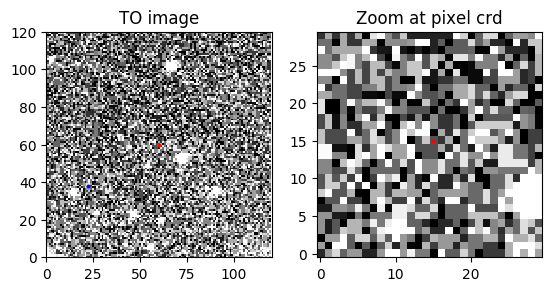

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 30.17754427  40.13290651]]
Date of observation: 2005-04-10
Pixel coordinates: [[ 60.02255796  59.98731381]]


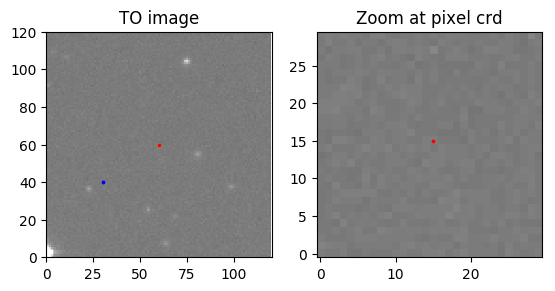

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 23.1038      42.34412053]]
Date of observation: 2005-04-10
Pixel coordinates: [[ 60.02255454  59.98730989]]


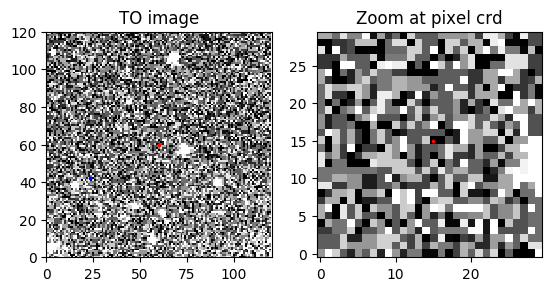

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 25.94002551   7.72350423]]
Date of observation: 2005-04-10
Pixel coordinates: [[ 60.02258244  59.98731189]]


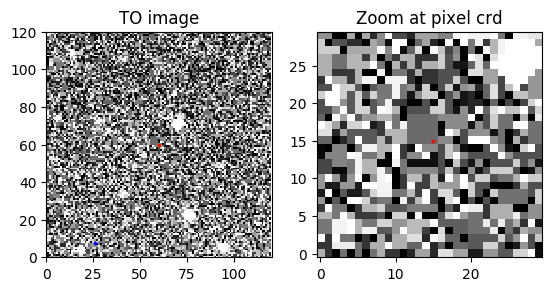

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  32.57433357  109.08331775]]
Date of observation: 2005-04-30
Pixel coordinates: [[ 60.0225186   59.98736464]]


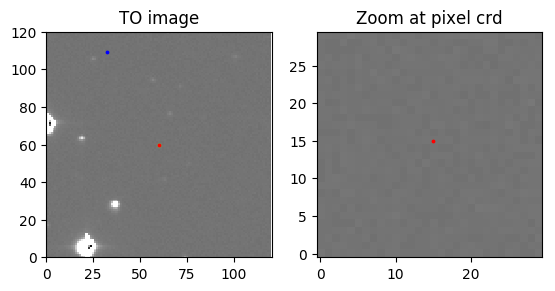

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  39.30920999  110.87283127]]
Date of observation: 2005-04-30
Pixel coordinates: [[ 60.0225141   59.98735489]]


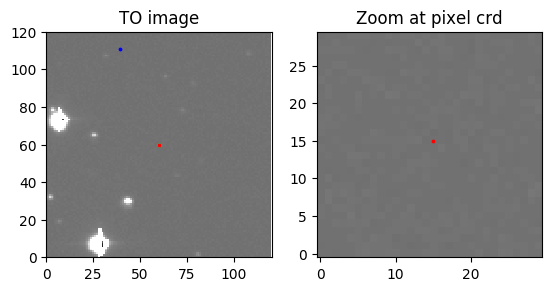

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  31.55907133  113.39162954]]
Date of observation: 2005-04-30
Pixel coordinates: [[ 60.0225114   59.98735047]]


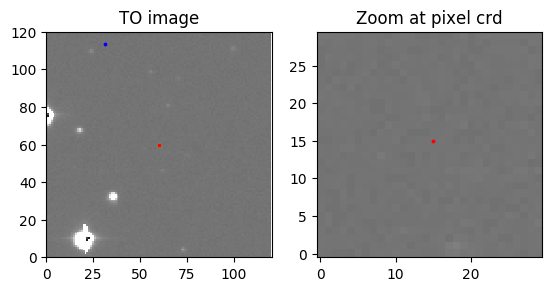

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  25.19492012  109.07904386]]
Date of observation: 2005-04-30
Pixel coordinates: [[ 60.02251683  59.98735931]]


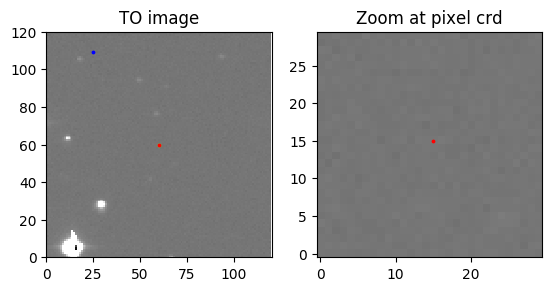

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 19.5670198  65.1770041]]
Date of observation: 2005-06-01
Pixel coordinates: [[ 60.02255263  59.98737041]]


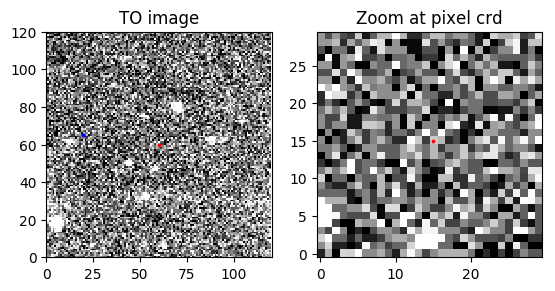

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 25.66187842  63.34304945]]
Date of observation: 2005-06-01
Pixel coordinates: [[ 60.02255605  59.98737544]]


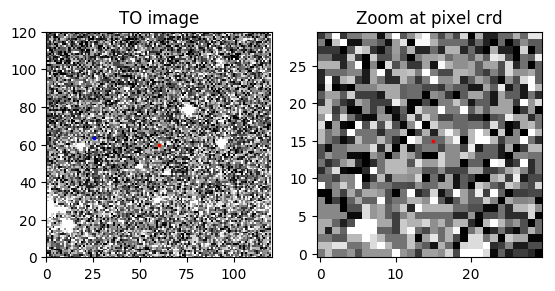

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 26.14874945  69.10181296]]
Date of observation: 2005-06-01
Pixel coordinates: [[ 60.02254781  59.9873612 ]]


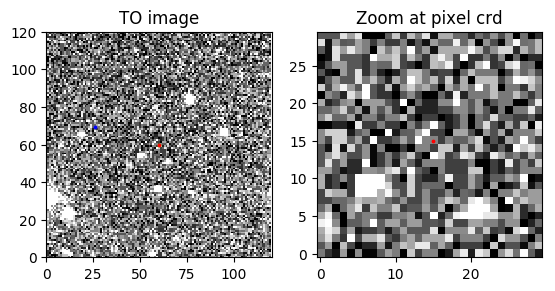

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 33.91789955  67.07477763]]
Date of observation: 2005-06-01
Pixel coordinates: [[ 60.02255117  59.98736571]]


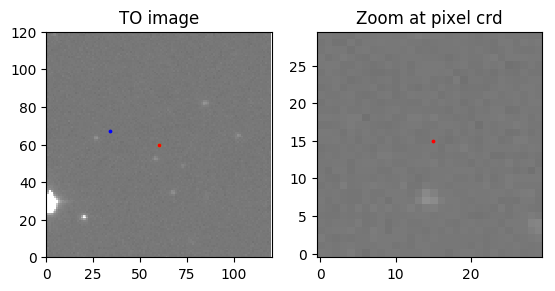

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 44.20518147  86.40578512]]
Date of observation: 2005-12-07
Pixel coordinates: [[ 60.02251222  59.98725321]]


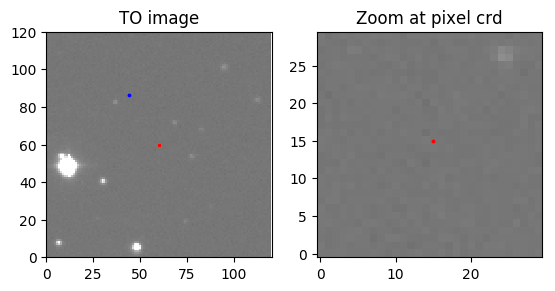

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  56.25223906  109.01900024]]
Date of observation: 2005-12-07
Pixel coordinates: [[ 60.02249714  59.98726225]]


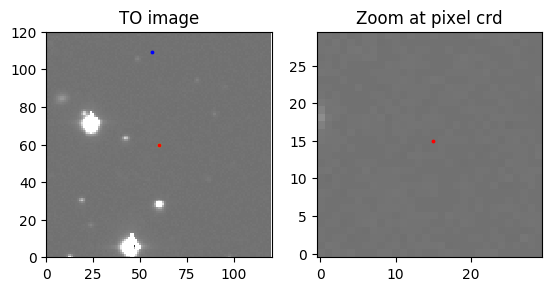

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  33.8198804  104.611077 ]]
Date of observation: 2005-12-07
Pixel coordinates: [[ 60.0225009   59.98726377]]


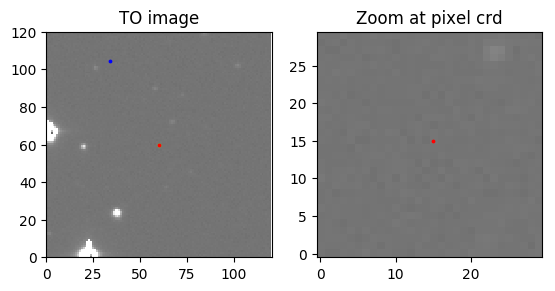

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  40.92678253  106.43826938]]
Date of observation: 2005-12-07
Pixel coordinates: [[ 60.02249737  59.98725701]]


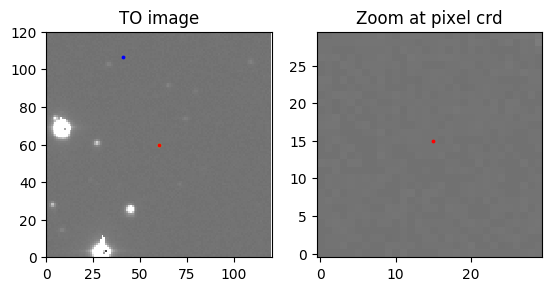

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 34.02529299  97.28187853]]
Date of observation: 2005-12-24
Pixel coordinates: [[ 60.0225076   59.98727024]]


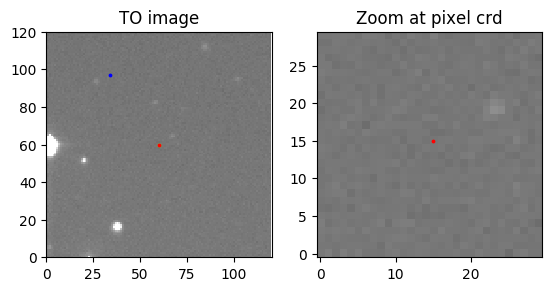

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 33.6292985   76.23176742]]
Date of observation: 2005-12-24
Pixel coordinates: [[ 60.02252188  59.98726507]]


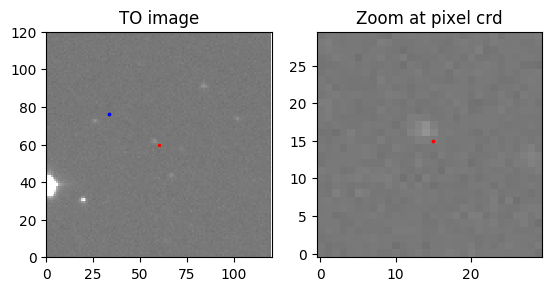

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 22.19445958  96.35638203]]
Date of observation: 2005-12-24
Pixel coordinates: [[ 60.02250971  59.98727787]]


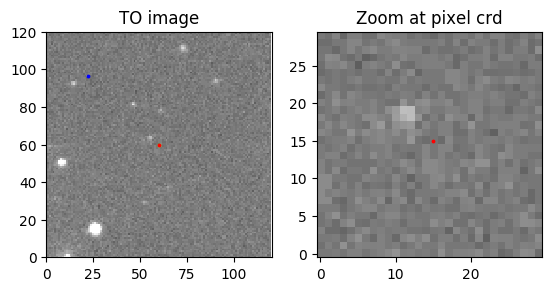

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  43.59939528  100.26914806]]
Date of observation: 2005-12-24
Pixel coordinates: [[ 60.0225063   59.98727665]]


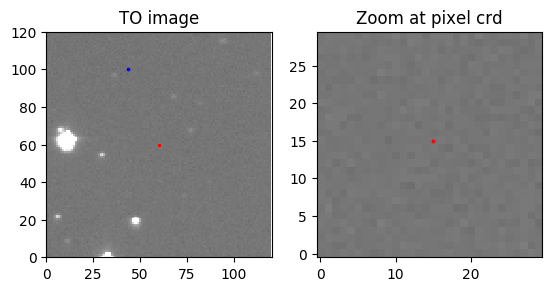

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 40.35982353  16.59315244]]
Date of observation: 2006-02-01
Pixel coordinates: [[ 60.02264498  59.98738003]]


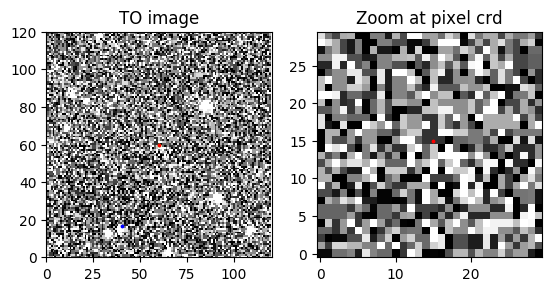

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 28.71409249   8.67994798]]
Date of observation: 2006-02-01
Pixel coordinates: [[ 60.02264791  59.98736962]]


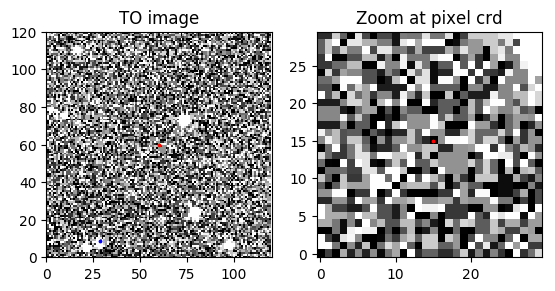

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  28.50497341  110.94117157]]
Date of observation: 2006-02-01
Pixel coordinates: [[ 60.02264401  59.98747212]]


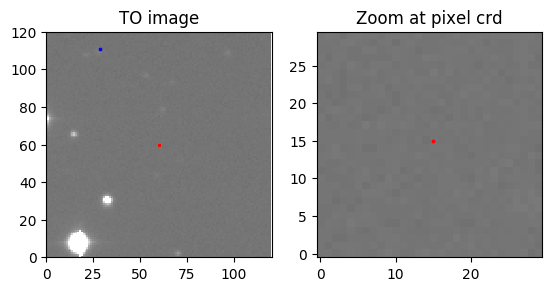

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 18.00844603  14.55905956]]
Date of observation: 2006-02-01
Pixel coordinates: [[ 60.02264752  59.98738384]]


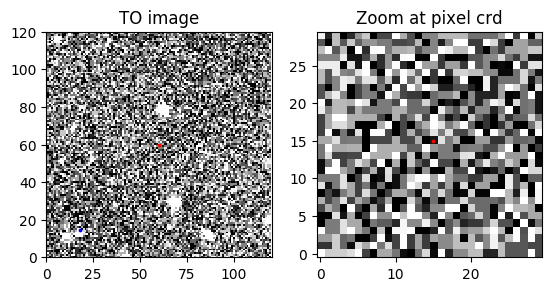

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  66.14604464  121.50725107]]
Date of observation: 2006-02-27
Pixel coordinates: [[ 60.02309282  59.98935907]]


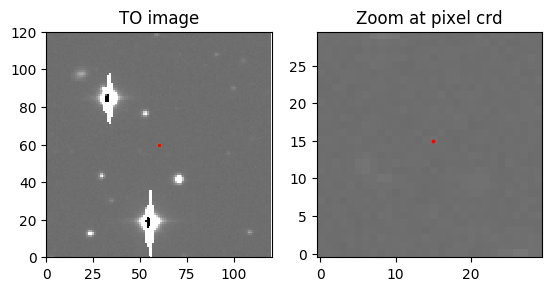

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  55.42314803  110.76568356]]
Date of observation: 2006-02-27
Pixel coordinates: [[ 60.02309778  59.98934197]]


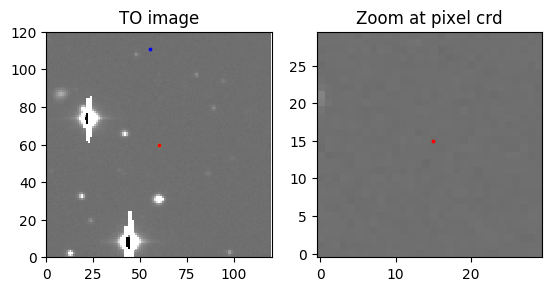

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 17.69259129  50.34322575]]
Date of observation: 2006-02-27
Pixel coordinates: [[ 60.02254849  59.98729928]]


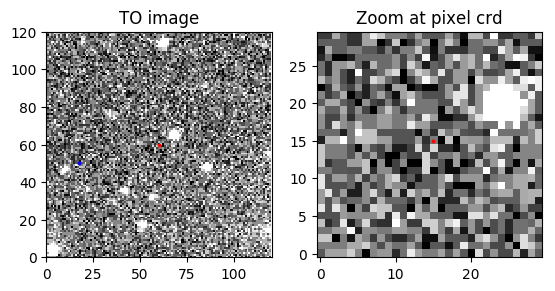

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  41.99832744  118.76361993]]
Date of observation: 2006-02-27
Pixel coordinates: [[ 60.0230967   59.98936598]]


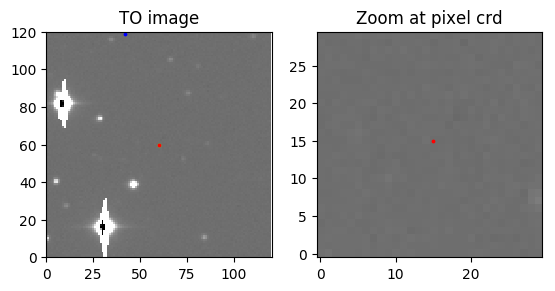

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 16.93712675  68.8451454 ]]
Date of observation: 2006-02-27
Pixel coordinates: [[ 60.02253508  59.98730181]]


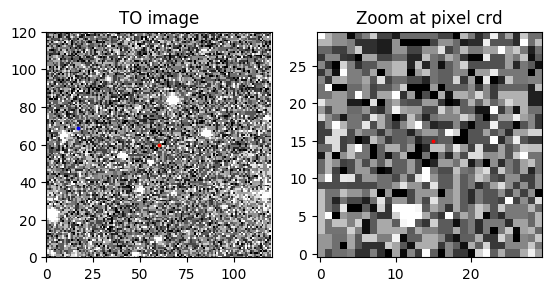

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 66.14604464   1.50725107]]
Date of observation: 2006-02-27
Pixel coordinates: [[ 60.02311171  59.98925574]]


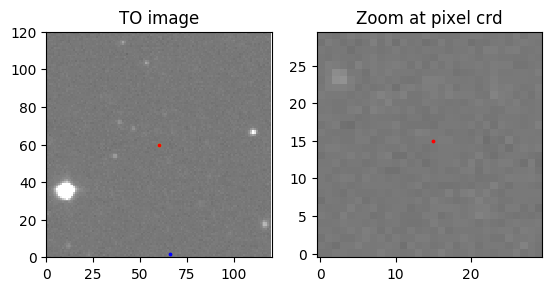

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 26.9557116   74.64371308]]
Date of observation: 2006-02-27
Pixel coordinates: [[ 60.02253336  59.98731176]]


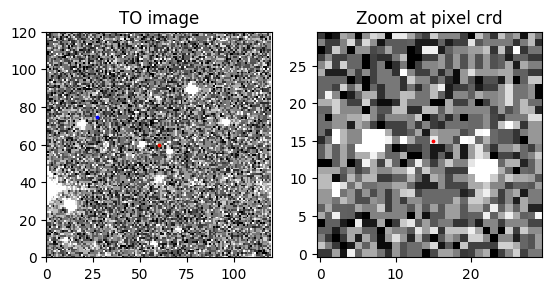

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  7.56290478  71.8471411 ]]
Date of observation: 2006-02-27
Pixel coordinates: [[ 60.02253591  59.98731475]]


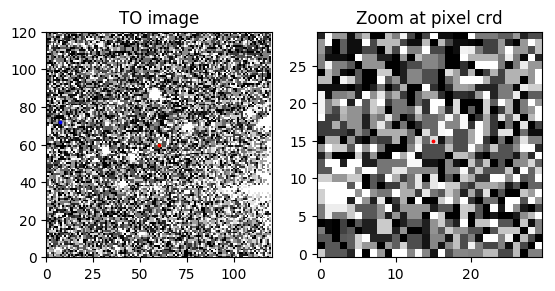

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 53.8413077  96.8291424]]
Date of observation: 2006-02-27
Pixel coordinates: [[ 60.02310885  59.98934515]]


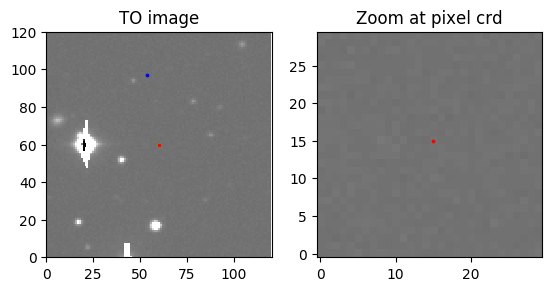

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 41.99832744  -1.23638007]]
Date of observation: 2006-02-27
Pixel coordinates: [[ 60.02311465  59.98926256]]


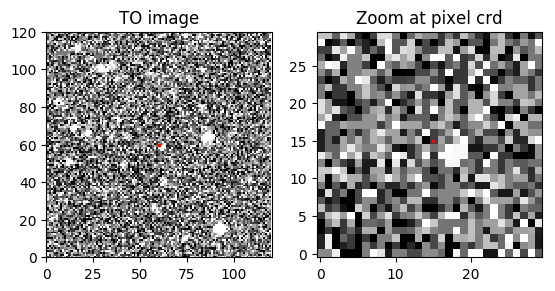

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  35.60746801  109.95340695]]
Date of observation: 2006-03-24
Pixel coordinates: [[ 60.02249956  59.98728945]]


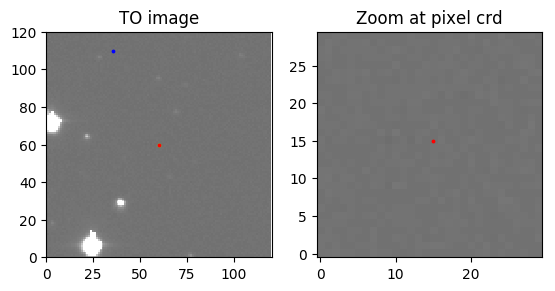

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 27.02819393  86.64875645]]
Date of observation: 2006-03-24
Pixel coordinates: [[ 60.02251405  59.98727944]]


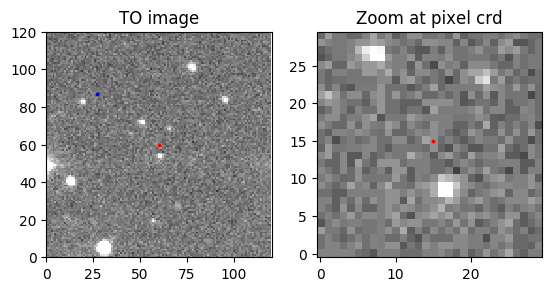

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  26.3437363   103.84575328]]
Date of observation: 2006-03-24
Pixel coordinates: [[ 60.02250232  59.9872817 ]]


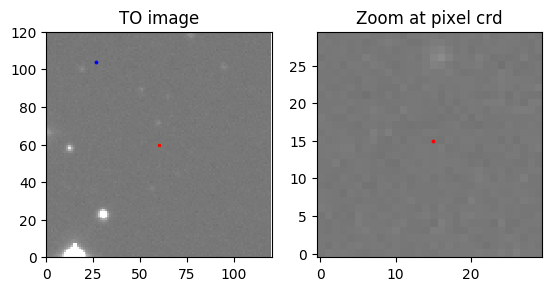

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  17.0711346   106.39881361]]
Date of observation: 2006-03-24
Pixel coordinates: [[ 60.02250225  59.98729185]]


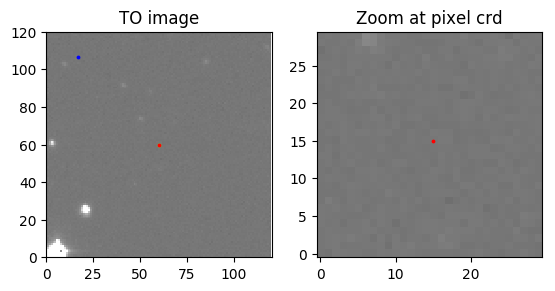

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  80.7361992   119.73525592]]
Date of observation: 2006-04-06
Pixel coordinates: [[ 60.02248657  59.98727169]]


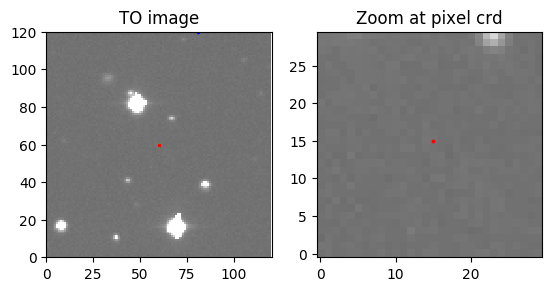

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 94.80724613  22.46535419]]
Date of observation: 2006-04-06
Pixel coordinates: [[ 60.02547175  67.98685622]]


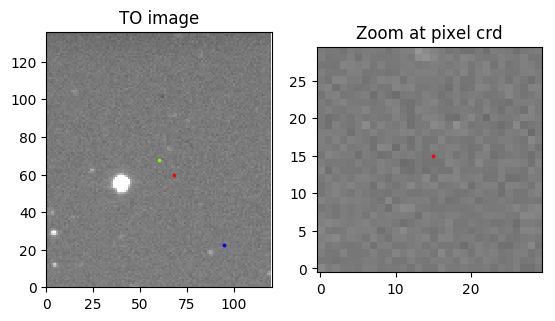

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 79.11376709  20.15771364]]
Date of observation: 2006-04-06
Pixel coordinates: [[ 60.02547372  67.98685359]]


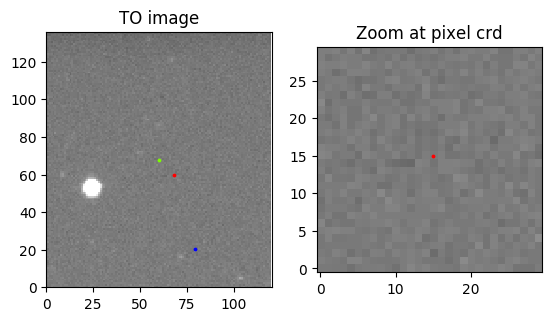

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 71.75253924  21.82378222]]
Date of observation: 2006-04-06
Pixel coordinates: [[ 60.02547364  67.9868594 ]]


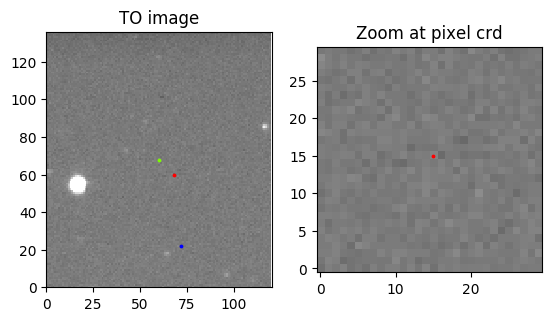

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 80.7361992   -0.26474408]]
Date of observation: 2006-04-06
Pixel coordinates: [[ 60.02549003  67.9868485 ]]


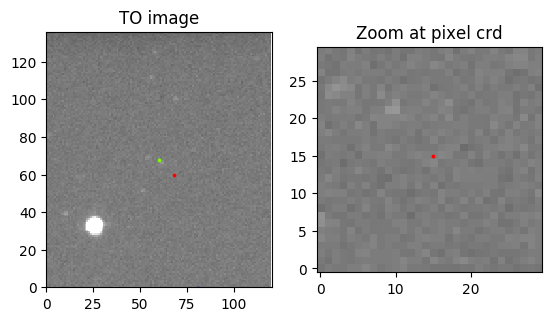

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 50.83183144  55.92230778]]
Date of observation: 2006-04-26
Pixel coordinates: [[ 60.02254882  59.98732625]]


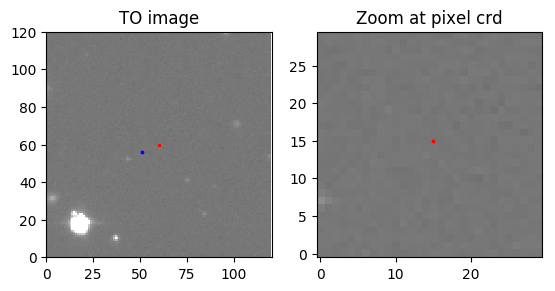

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 41.92814187  57.57627429]]
Date of observation: 2006-04-26
Pixel coordinates: [[ 60.02255266  59.98734651]]


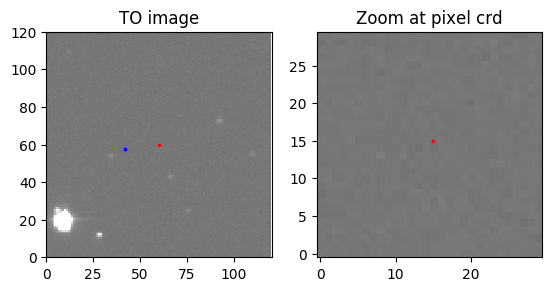

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 50.70371252  37.18510818]]
Date of observation: 2006-04-26
Pixel coordinates: [[ 60.022563    59.98732643]]


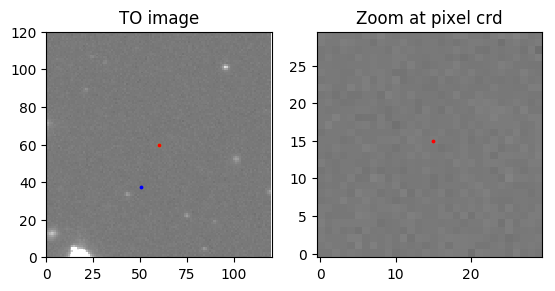

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 63.10536375  60.87893318]]
Date of observation: 2006-04-26
Pixel coordinates: [[ 60.02254916  59.98734139]]


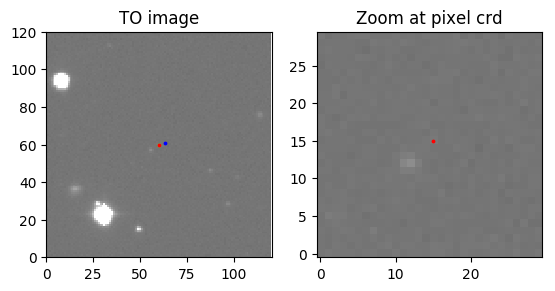

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 34.39444208  73.12185462]]
Date of observation: 2006-05-05
Pixel coordinates: [[ 60.02253289  59.98732058]]


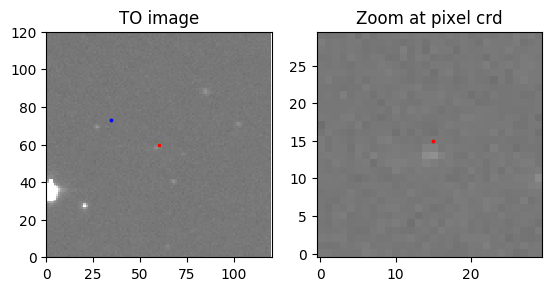

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 24.76979612  67.03571934]]
Date of observation: 2006-05-05
Pixel coordinates: [[ 60.02253472  59.98730974]]


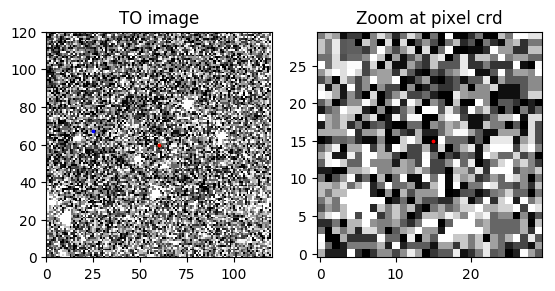

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 26.21384483  48.87740353]]
Date of observation: 2006-05-05
Pixel coordinates: [[ 60.02254786  59.98730799]]


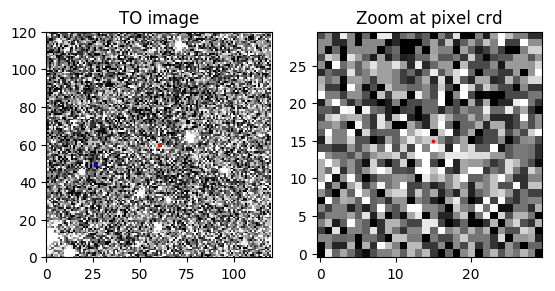

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 14.2915271   69.79630769]]
Date of observation: 2006-05-05
Pixel coordinates: [[ 60.02253685  59.98732389]]


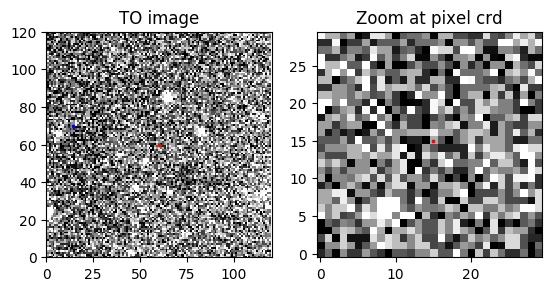

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 27.91450828  13.25952233]]
Date of observation: 2006-06-16
Pixel coordinates: [[ 60.02260249  59.98739685]]


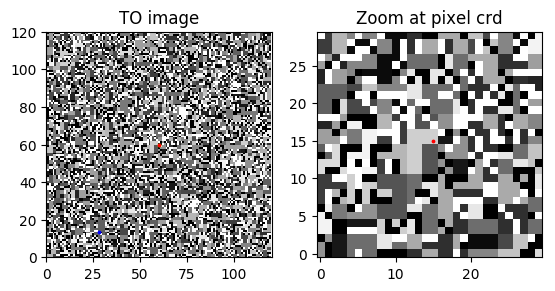

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 33.50360678   1.43585988]]
Date of observation: 2006-06-16
Pixel coordinates: [[ 60.02260987  59.98739072]]


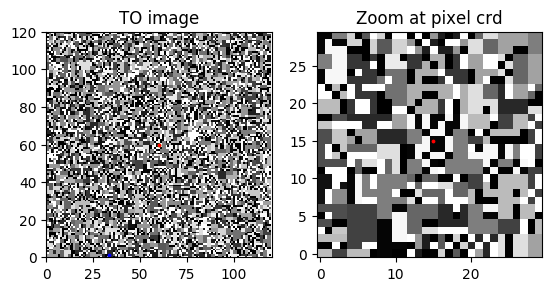

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  33.50360678  121.43585988]]
Date of observation: 2006-06-16
Pixel coordinates: [[ 60.02259202  59.98749482]]


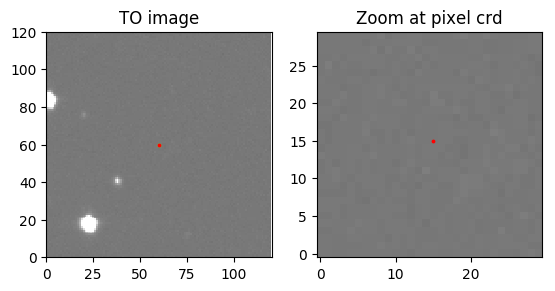

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 32.61590557   8.98817858]]
Date of observation: 2006-06-16
Pixel coordinates: [[ 60.02260442  59.9873909 ]]


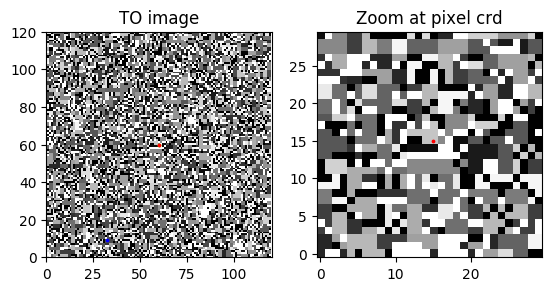

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 36.06711813  14.05658151]]
Date of observation: 2006-06-16
Pixel coordinates: [[ 60.02260111  59.98739544]]


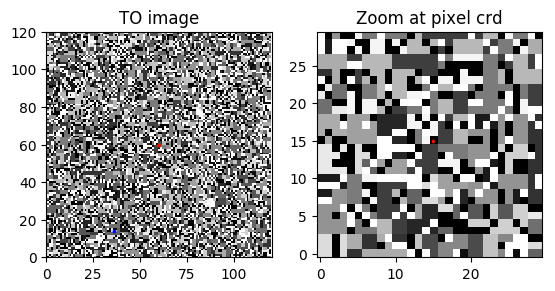

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 57.44649717  11.16355734]]
Date of observation: 2006-11-23
Pixel coordinates: [[ 60.02547429  67.98681921]]


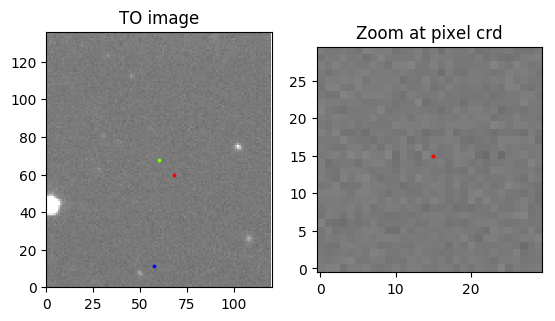

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 56.29468559  31.08679003]]
Date of observation: 2006-11-23
Pixel coordinates: [[ 60.02545878  67.98682741]]


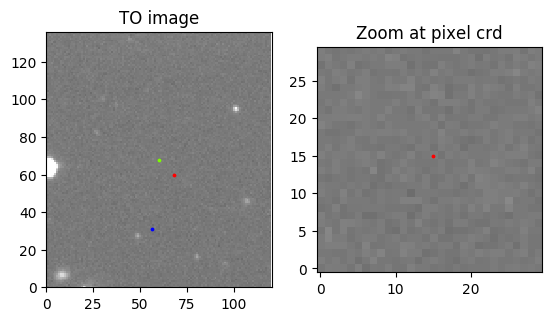

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 70.53242459  29.27060456]]
Date of observation: 2006-11-23
Pixel coordinates: [[ 60.02546078  67.98682765]]


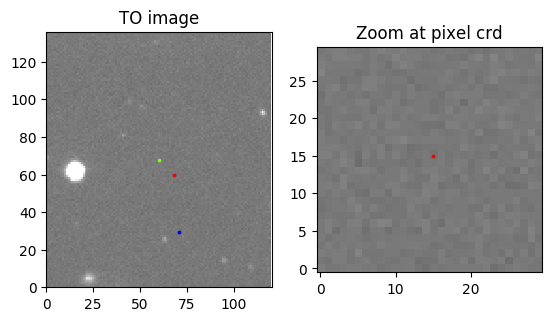

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 47.34736685  33.87523623]]
Date of observation: 2006-11-23
Pixel coordinates: [[ 60.02545686  67.98682816]]


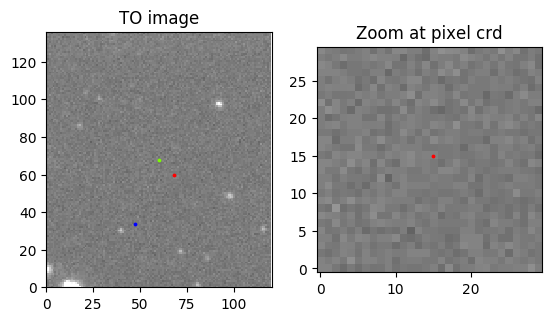

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 105.63973851   57.08812872]]
Date of observation: 2006-12-27
Pixel coordinates: [[ 60.02549415  67.98673328]]


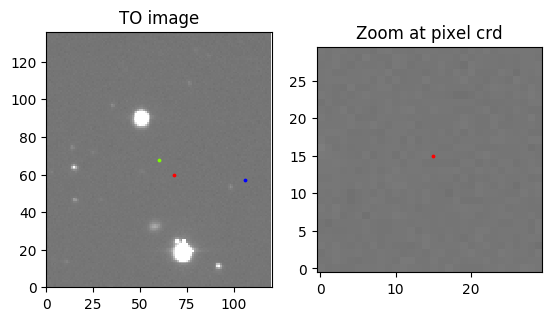

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 115.43435802   33.00643458]]
Date of observation: 2006-12-27
Pixel coordinates: [[ 60.02551466  67.98672596]]


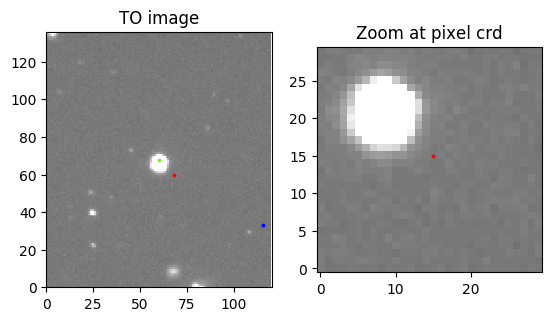

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 108.13539442   51.02738982]]
Date of observation: 2006-12-27
Pixel coordinates: [[ 60.02550218  67.98673426]]


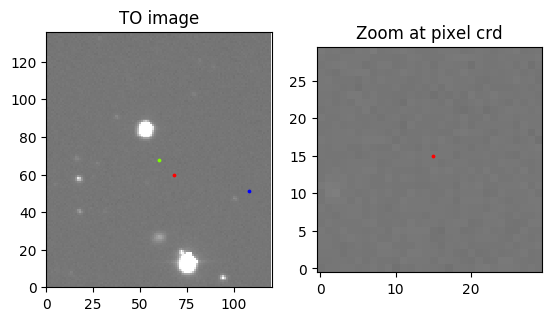

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 13.2462455   54.30154519]]
Date of observation: 2006-12-27
Pixel coordinates: [[ 60.02544593  67.98684129]]


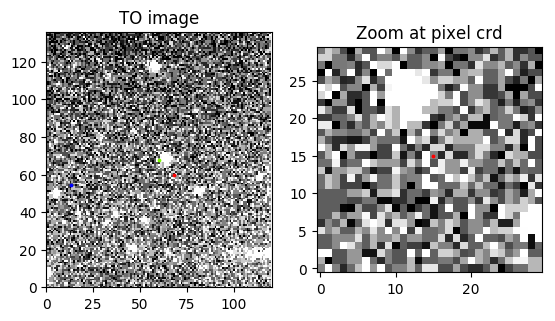

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  8.47750043  40.05454951]]
Date of observation: 2007-01-15
Pixel coordinates: [[ 60.02545662  67.98683552]]


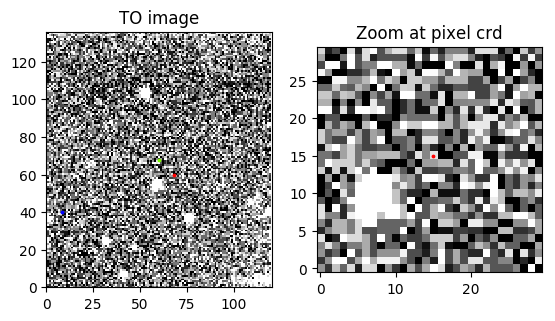

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 29.50332509  39.35803751]]
Date of observation: 2007-01-15
Pixel coordinates: [[ 60.02545389  67.98683153]]


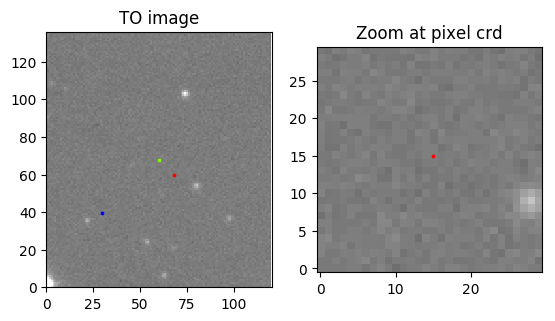

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  5.80645362  42.82122654]]
Date of observation: 2007-01-15
Pixel coordinates: [[ 60.02545232  67.98683244]]


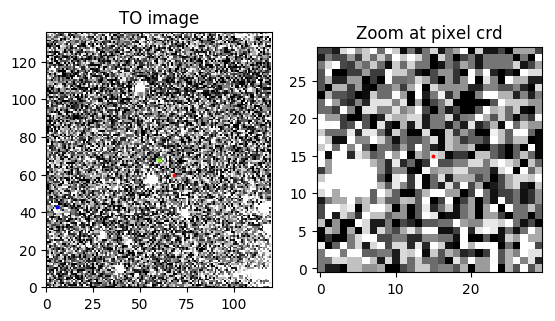

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 13.91066083  20.45552415]]
Date of observation: 2007-01-15
Pixel coordinates: [[ 60.0254702   67.98682636]]


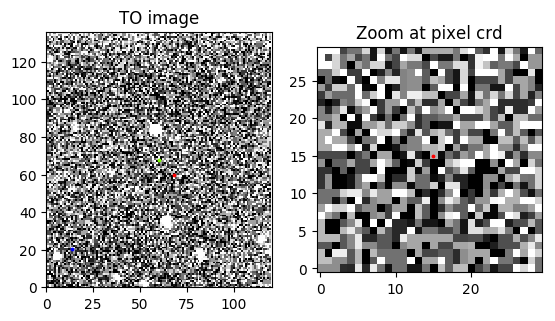

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 64.96119902  89.22140868]]
Date of observation: 2007-01-29
Pixel coordinates: [[ 60.02250925  59.98725975]]


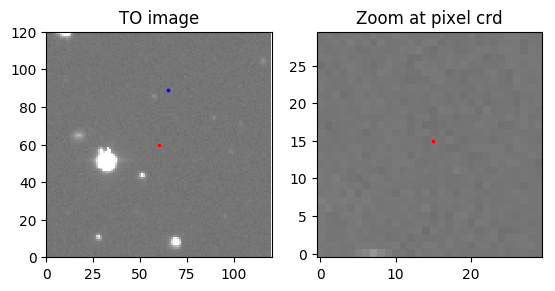

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  64.53148292  107.07312683]]
Date of observation: 2007-01-29
Pixel coordinates: [[ 60.02249753  59.98726324]]


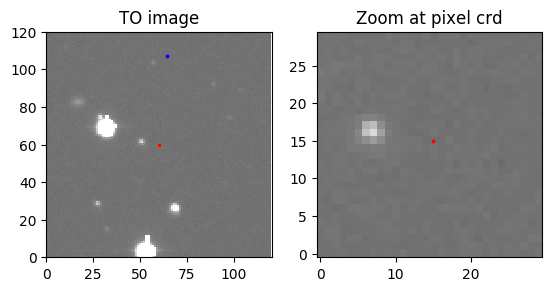

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  54.92587268  111.50395281]]
Date of observation: 2007-01-29
Pixel coordinates: [[ 60.02249515  59.98726897]]


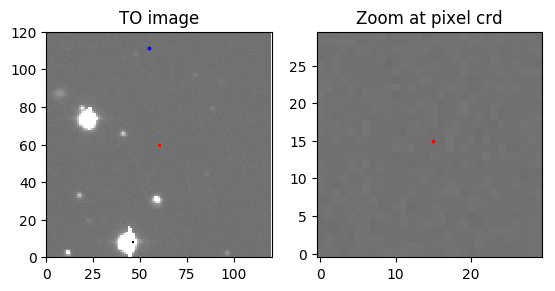

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  74.78136223  108.84208044]]
Date of observation: 2007-01-29
Pixel coordinates: [[ 60.02249766  59.98727045]]


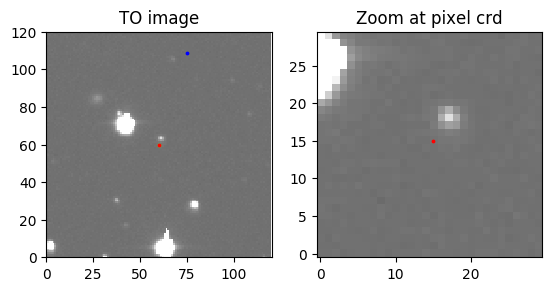

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 82.84582196  82.42175404]]
Date of observation: 2007-02-10
Pixel coordinates: [[ 60.02251415  59.98726072]]


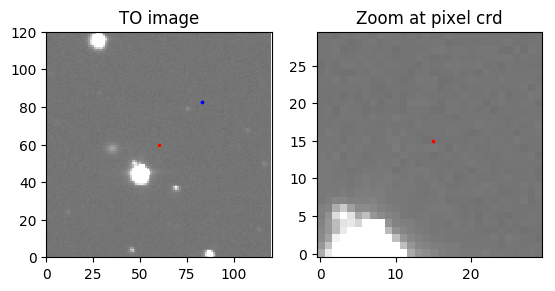

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  83.69544469  102.22126477]]
Date of observation: 2007-02-10
Pixel coordinates: [[ 60.0224997   59.98726432]]


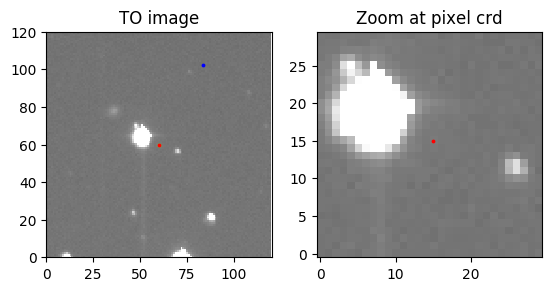

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  93.05011384  101.78575162]]
Date of observation: 2007-02-10
Pixel coordinates: [[ 60.02250297  59.98727341]]


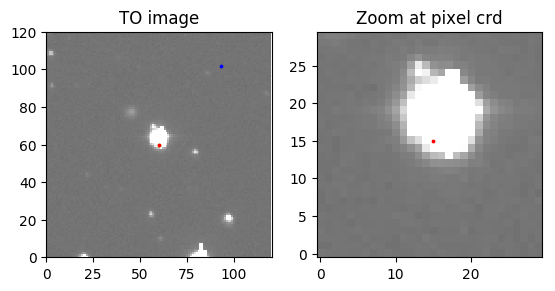

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  70.87854183  105.48449595]]
Date of observation: 2007-02-10
Pixel coordinates: [[ 60.02249907  59.98727224]]


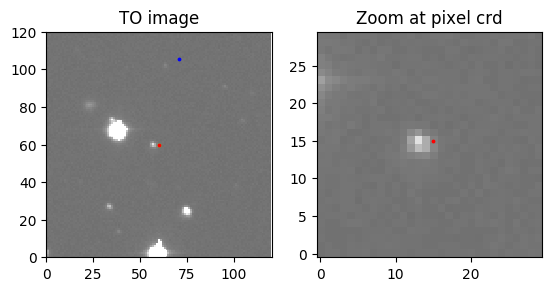

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  45.44539746  113.16928585]]
Date of observation: 2007-02-19
Pixel coordinates: [[ 60.02248678  59.98724811]]


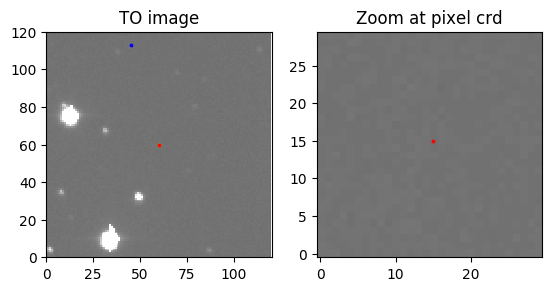

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  56.01630585  113.76338304]]
Date of observation: 2007-02-19
Pixel coordinates: [[ 60.02248656  59.98724567]]


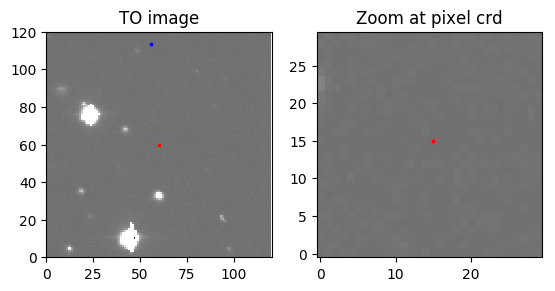

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  64.87423423  110.22226734]]
Date of observation: 2007-02-19
Pixel coordinates: [[ 60.02248884  59.98724883]]


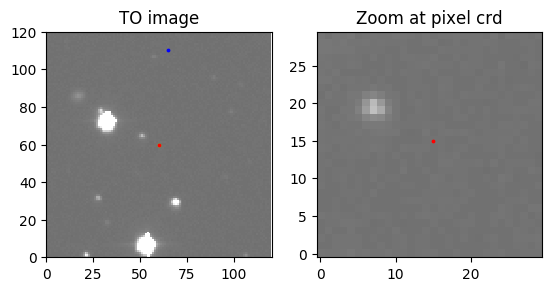

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 55.00411929  90.47454293]]
Date of observation: 2007-02-19
Pixel coordinates: [[ 60.02250143  59.98723925]]


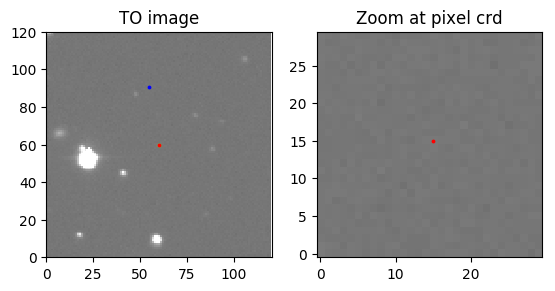

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  79.04258025  110.82585247]]
Date of observation: 2007-02-25
Pixel coordinates: [[ 60.02248923  59.98724646]]


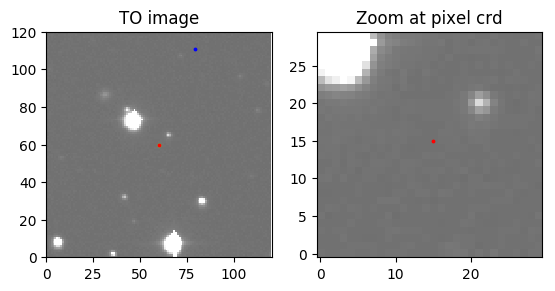

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 70.27160475  94.73241621]]
Date of observation: 2007-02-25
Pixel coordinates: [[ 60.02250076  59.98723871]]


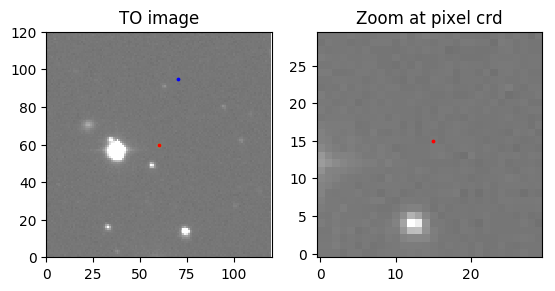

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  64.73560821  113.70032577]]
Date of observation: 2007-02-25
Pixel coordinates: [[ 60.02248697  59.98724565]]


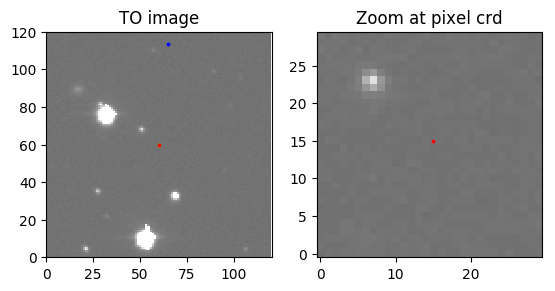

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  57.65190563  116.46425297]]
Date of observation: 2007-02-25
Pixel coordinates: [[ 60.02248469  59.9872465 ]]


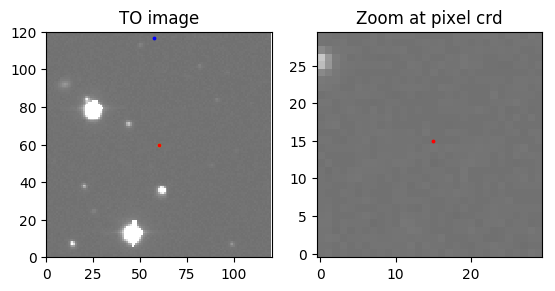

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  70.43185832  116.00534375]]
Date of observation: 2007-03-15
Pixel coordinates: [[ 60.02249518  59.98729103]]


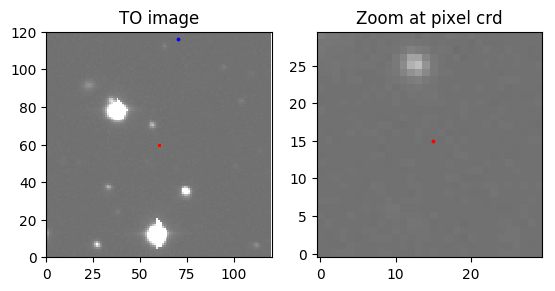

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  58.42456539  120.13801545]]
Date of observation: 2007-03-15
Pixel coordinates: [[ 60.0224946   59.98730154]]


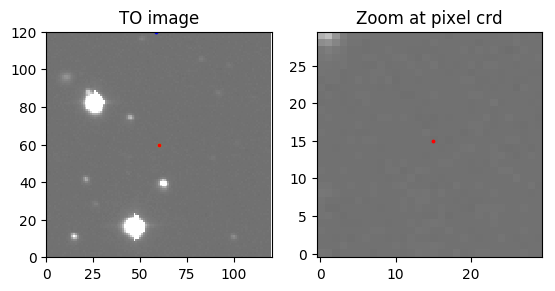

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 58.42456539   0.13801545]]
Date of observation: 2007-03-15
Pixel coordinates: [[ 60.02550246  67.98688229]]


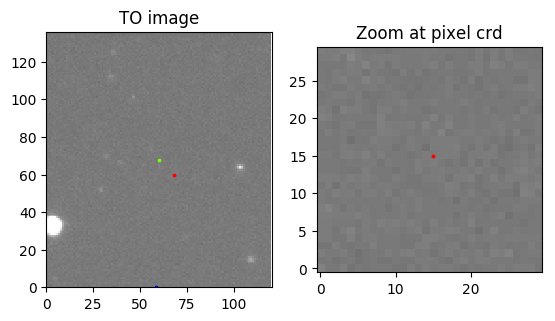

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 70.08213092  96.5293259 ]]
Date of observation: 2007-03-15
Pixel coordinates: [[ 60.02250938  59.98728839]]


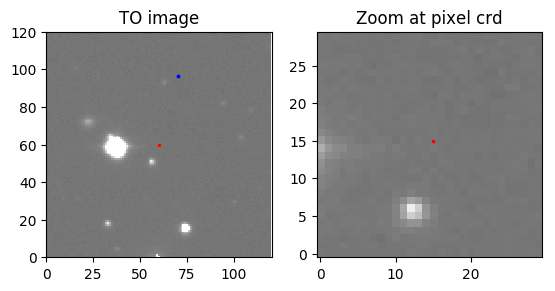

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  78.3656597   115.64778629]]
Date of observation: 2007-03-15
Pixel coordinates: [[ 60.02249847  59.98730339]]


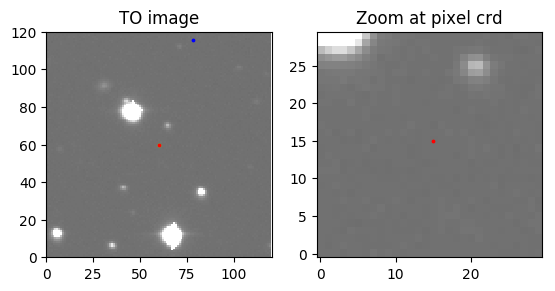

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 25.9108026   32.15901808]]
Date of observation: 2007-03-26
Pixel coordinates: [[ 60.02546115  67.98685026]]


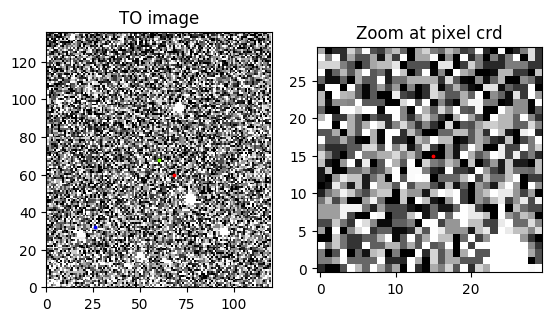

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 37.2276169   26.34911281]]
Date of observation: 2007-03-26
Pixel coordinates: [[ 60.02547052  67.98686103]]


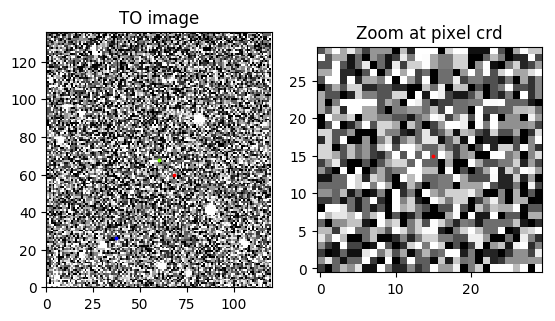

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 16.25477929  31.7895883 ]]
Date of observation: 2007-03-26
Pixel coordinates: [[ 60.0254653   67.98685823]]


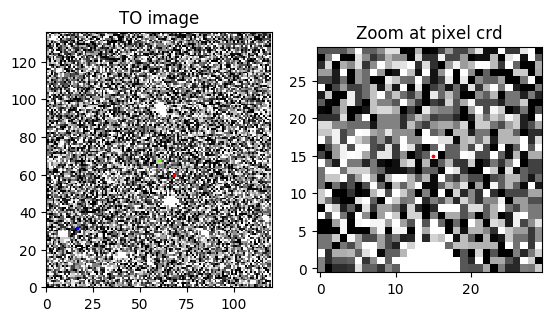

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 28.24137457  10.17224362]]
Date of observation: 2007-03-26
Pixel coordinates: [[ 60.02547952  67.98684613]]


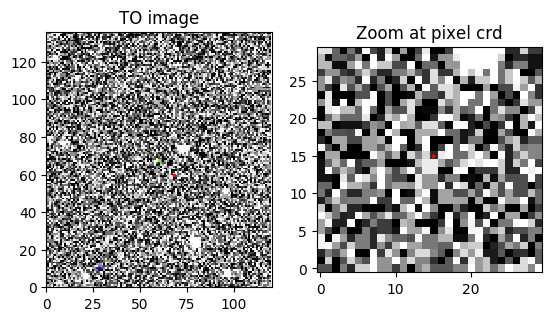

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[   1.9282942   114.17809442]]
Date of observation: 2007-04-24
Pixel coordinates: [[ 60.02256078  59.98735829]]


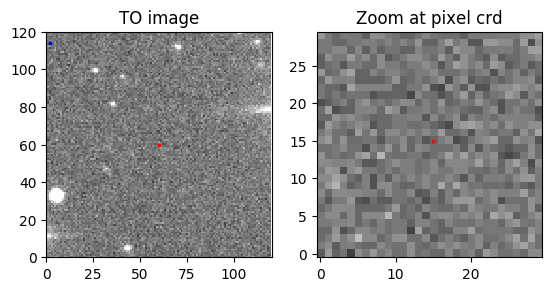

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 108.86497406   16.8773214 ]]
Date of observation: 2007-04-24
Pixel coordinates: [[ 60.02262043  59.98716987]]


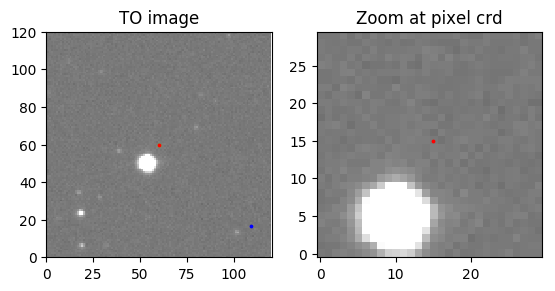

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 13.48929285  11.80391404]]
Date of observation: 2007-04-24
Pixel coordinates: [[ 60.02256813  59.98726952]]


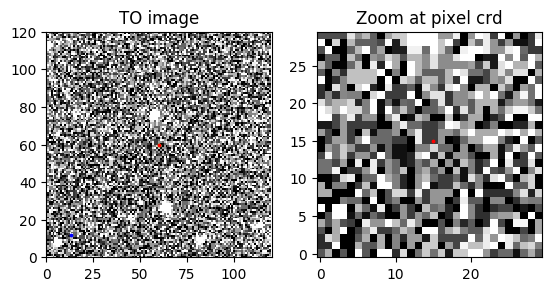

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 120.16053234   14.74273396]]
Date of observation: 2007-04-24
Pixel coordinates: [[ 60.02261891  59.98715859]]


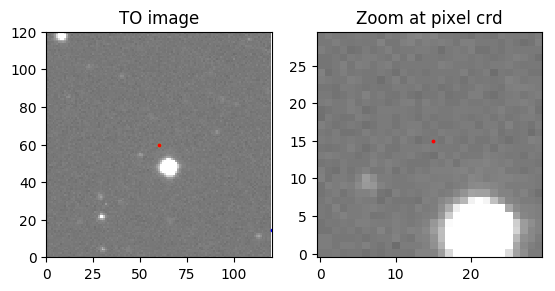

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  0.16053234  14.74273396]]
Date of observation: 2007-04-24
Pixel coordinates: [[ 60.0225627   59.98725601]]


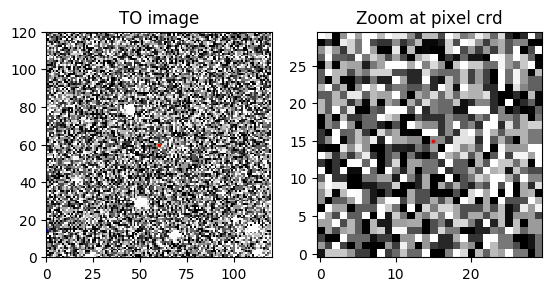

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 121.9282942   114.17809442]]
Date of observation: 2007-04-24
Pixel coordinates: [[ 60.02261655  59.98726099]]


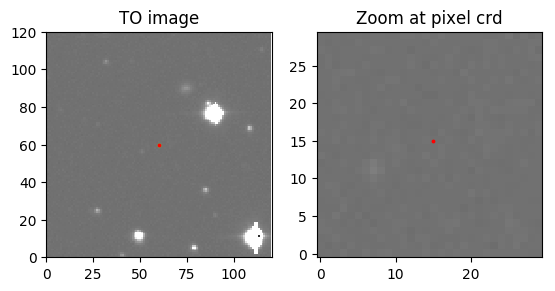

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 23.49913154  20.88434443]]
Date of observation: 2007-05-10
Pixel coordinates: [[ 60.02256941  59.9873017 ]]


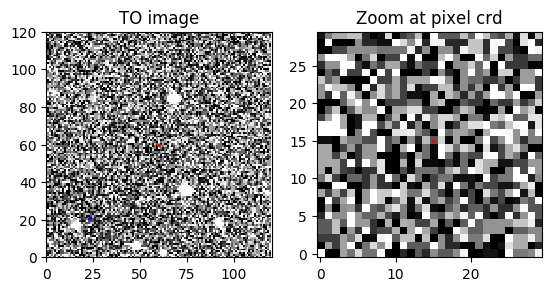

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 37.68407026  22.40692123]]
Date of observation: 2007-05-10
Pixel coordinates: [[ 60.02257253  59.98731673]]


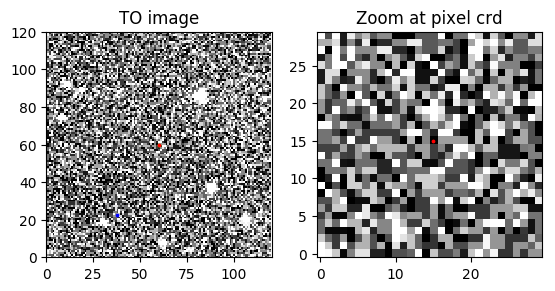

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 25.69154612   1.83628649]]
Date of observation: 2007-05-10
Pixel coordinates: [[ 60.02258374  59.9872995 ]]


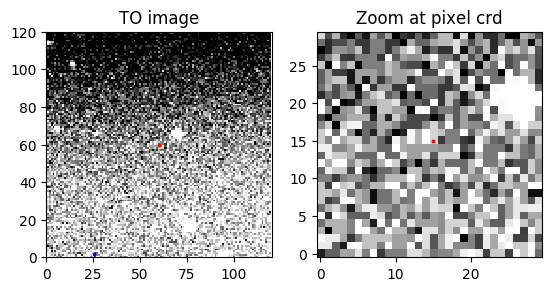

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  25.69154612  121.83628649]]
Date of observation: 2007-05-10
Pixel coordinates: [[ 60.02256654  59.98740373]]


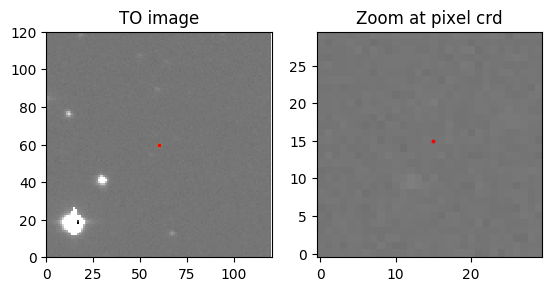

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 15.14723869  25.58270373]]
Date of observation: 2007-05-10
Pixel coordinates: [[ 60.02256924  59.98731305]]


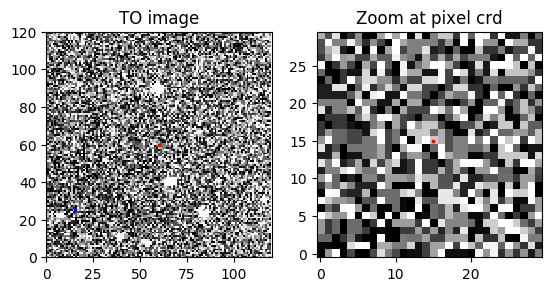

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 22.95168798  55.44504561]]
Date of observation: 2007-05-16
Pixel coordinates: [[ 60.02254836  59.98732055]]


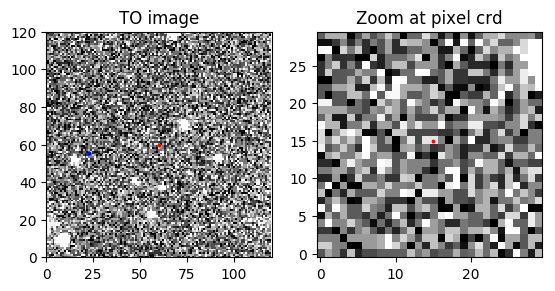

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 24.94659624  36.4406404 ]]
Date of observation: 2007-05-16
Pixel coordinates: [[ 60.0225626   59.98732054]]


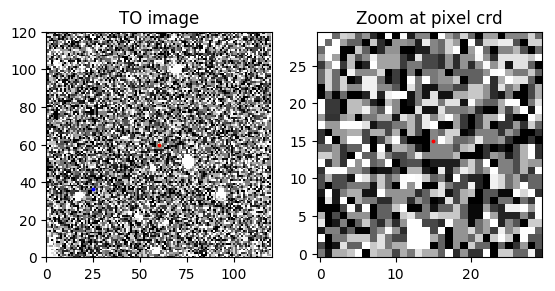

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 13.67808715  60.18793318]]
Date of observation: 2007-05-16
Pixel coordinates: [[ 60.02254766  59.98733432]]


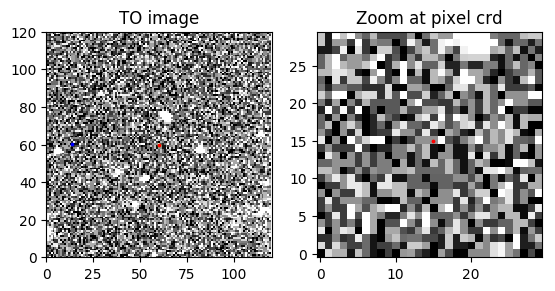

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 33.08930115  57.10847964]]
Date of observation: 2007-05-16
Pixel coordinates: [[ 60.02255158  59.98733967]]


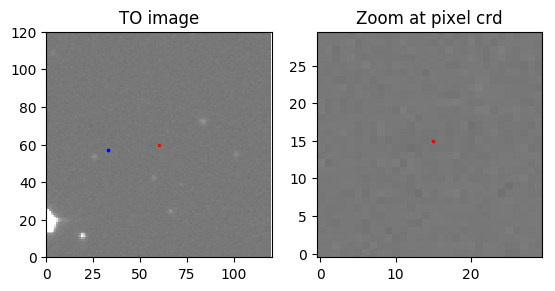

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 71.11528189  93.9588057 ]]
Date of observation: 2007-06-24
Pixel coordinates: [[ 60.0226032   59.98745546]]


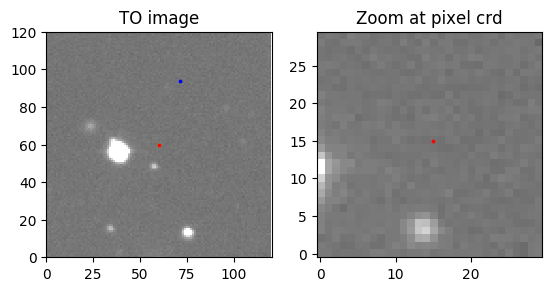

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 60.56251624  88.85417616]]
Date of observation: 2007-06-24
Pixel coordinates: [[ 60.02260142  59.98743711]]


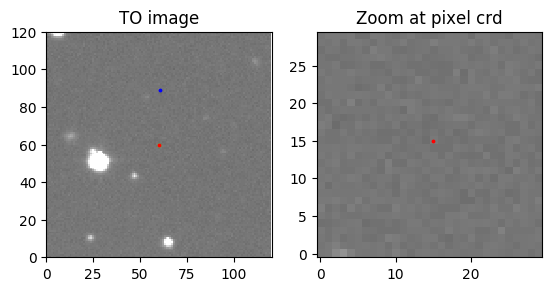

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 48.65707441  96.31943429]]
Date of observation: 2007-06-24
Pixel coordinates: [[ 60.02259824  59.98745034]]


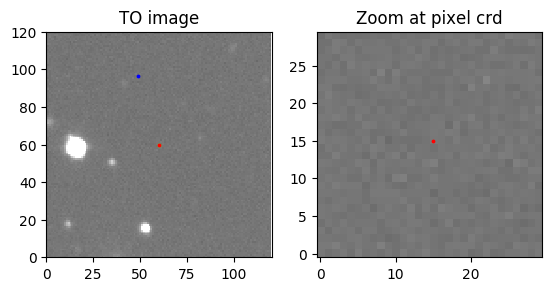

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 60.02110609  70.45614917]]
Date of observation: 2007-06-24
Pixel coordinates: [[ 60.02261588  59.98743525]]


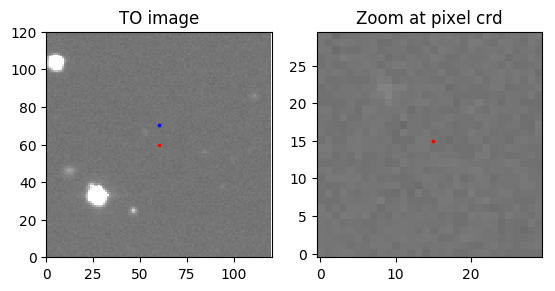

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 40.86620437  -1.62766915]]
Date of observation: 2007-12-17
Pixel coordinates: [[ 59.97478787  67.98738852]]


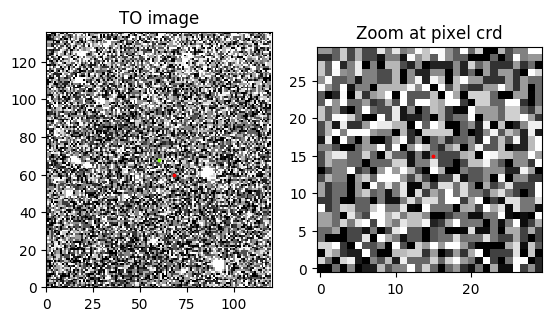

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  29.52032112  102.06910274]]
Date of observation: 2007-12-17
Pixel coordinates: [[ 59.97779981  59.98774451]]


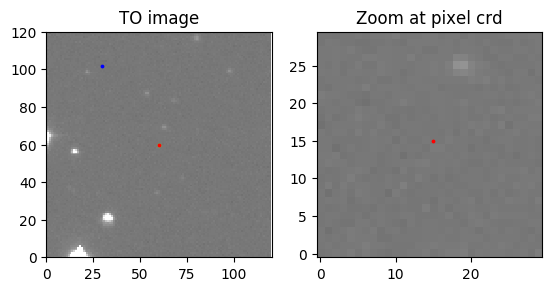

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  40.86620437  118.37233085]]
Date of observation: 2007-12-17
Pixel coordinates: [[ 59.97781184  59.98774744]]


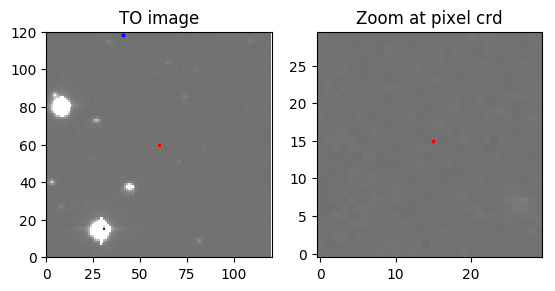

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 19.1127468    3.90363631]]
Date of observation: 2007-12-17
Pixel coordinates: [[ 59.97479138  67.98739189]]


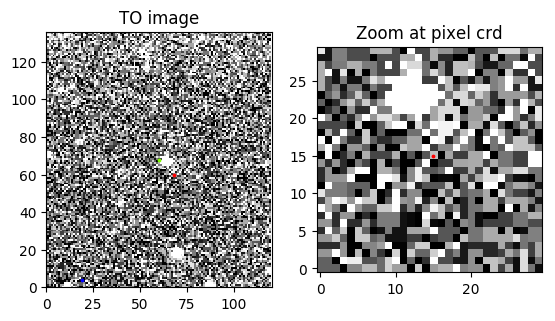

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  26.31308807  121.96815039]]
Date of observation: 2007-12-17
Pixel coordinates: [[ 59.97781345  59.98775146]]


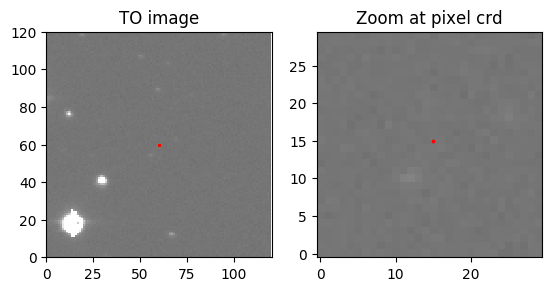

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 26.31308807   1.96815039]]
Date of observation: 2007-12-17
Pixel coordinates: [[ 59.97478869  67.98739294]]


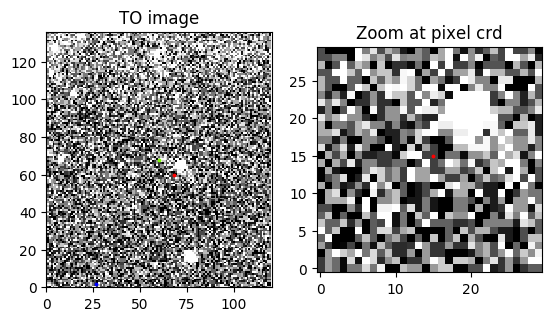

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 26.42232958  26.00020444]]
Date of observation: 2008-01-13
Pixel coordinates: [[ 59.97480692  67.98740246]]


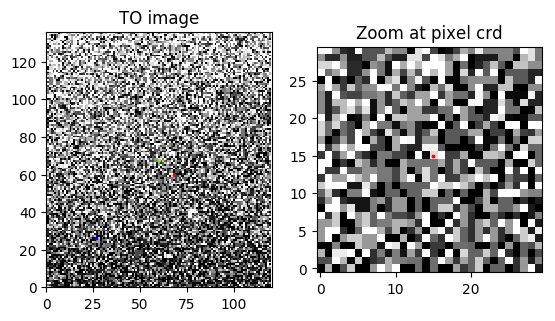

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 27.29868861  46.72650275]]
Date of observation: 2008-01-13
Pixel coordinates: [[ 59.97482335  67.98740919]]


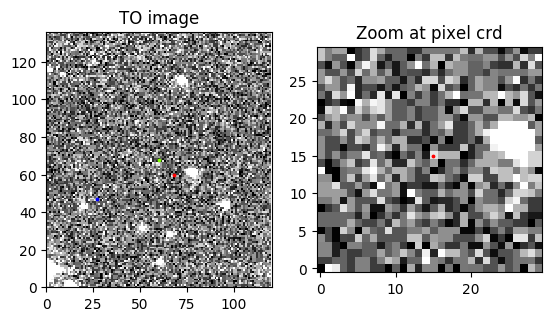

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 82.57408832  17.66889924]]
Date of observation: 2008-01-15
Pixel coordinates: [[ 60.02375366  59.99040558]]


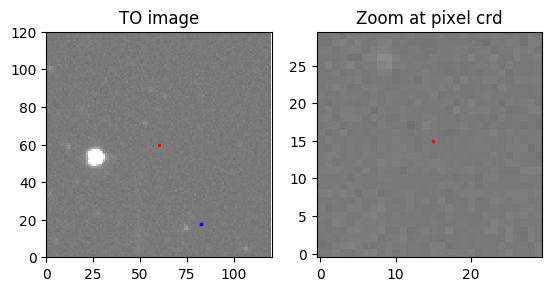

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 21.36515031  67.32442378]]
Date of observation: 2008-01-15
Pixel coordinates: [[ 59.97484079  67.9874137 ]]


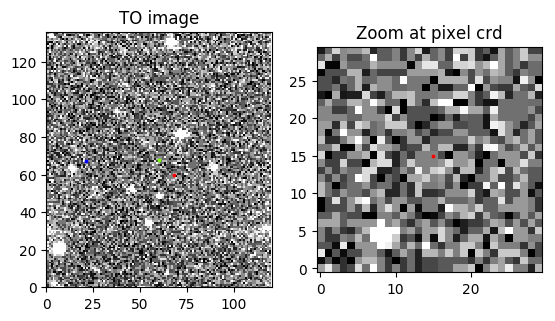

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 30.60022001  45.28935647]]
Date of observation: 2008-01-15
Pixel coordinates: [[ 59.97482334  67.98740774]]


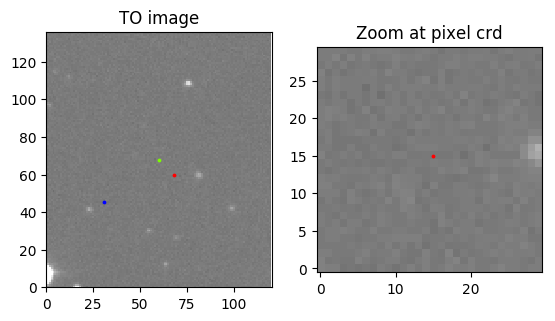

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 28.68620068  61.75816203]]
Date of observation: 2008-01-15
Pixel coordinates: [[ 59.97483581  67.98741308]]


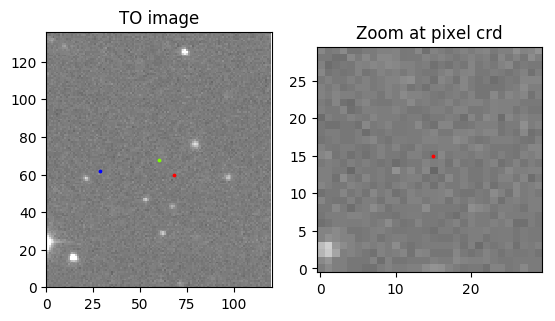

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 42.90561404  62.0421748 ]]
Date of observation: 2008-01-15
Pixel coordinates: [[ 59.97483789  67.98741084]]


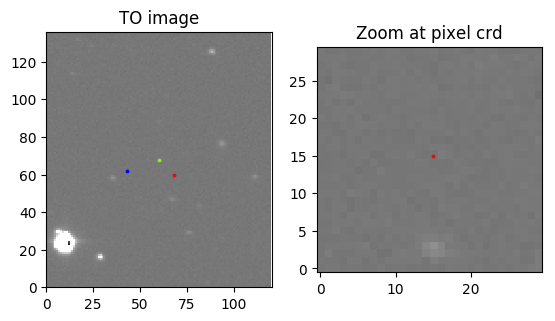

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 84.42851356  14.51129787]]
Date of observation: 2008-01-15
Pixel coordinates: [[ 60.02375707  59.99040783]]


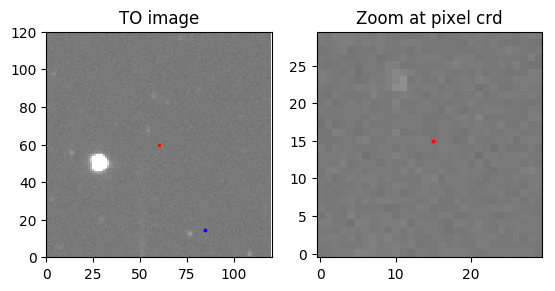

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 107.65634668   12.32532322]]
Date of observation: 2008-01-15
Pixel coordinates: [[ 60.02375834  59.99040287]]


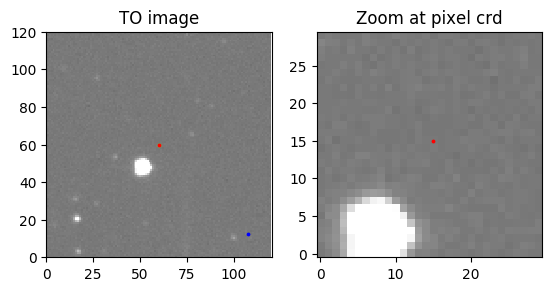

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  45.42224017  101.41913466]]
Date of observation: 2008-02-03
Pixel coordinates: [[ 59.9748668   67.98742653]]


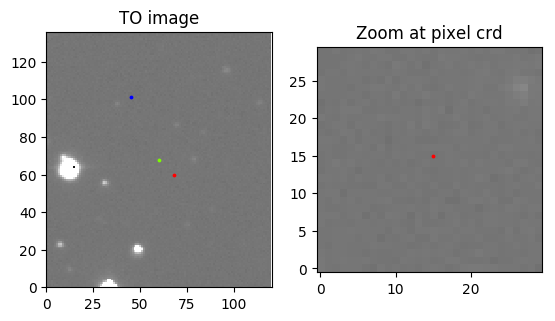

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 61.08232281  97.5981591 ]]
Date of observation: 2008-02-03
Pixel coordinates: [[ 59.97486376  67.98742798]]


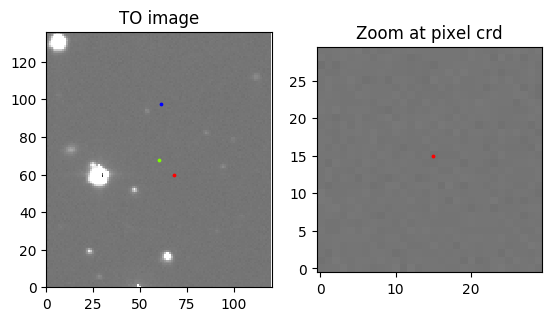

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 47.46821256  80.12781994]]
Date of observation: 2008-02-03
Pixel coordinates: [[ 59.97485004  67.9874208 ]]


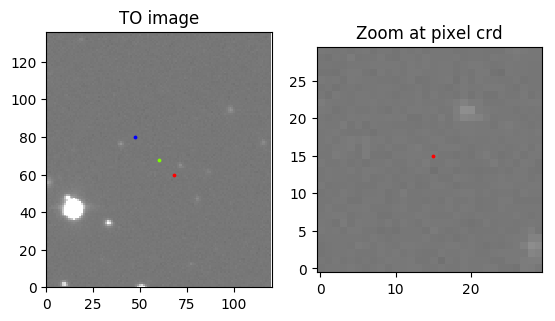

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  36.04667171  102.41674703]]
Date of observation: 2008-02-03
Pixel coordinates: [[ 59.97486723  67.98742891]]


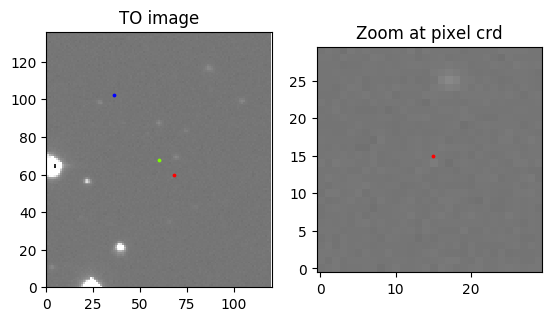

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 97.38037894  48.07249979]]
Date of observation: 2008-02-11
Pixel coordinates: [[ 59.97488026  67.98751233]]


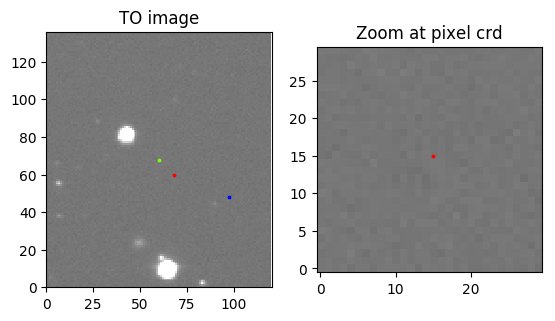

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 72.10538682  47.71616022]]
Date of observation: 2008-02-11
Pixel coordinates: [[ 59.97488222  67.98750128]]


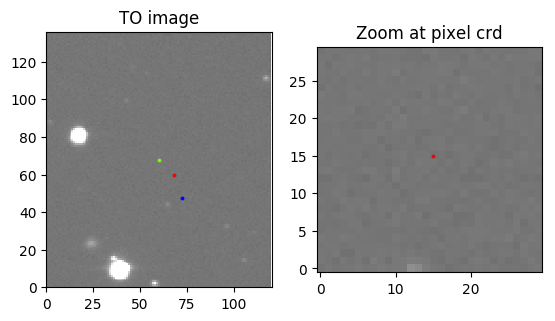

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  10.1713204   103.15338598]]
Date of observation: 2008-02-11
Pixel coordinates: [[ 59.97843685  59.98931704]]


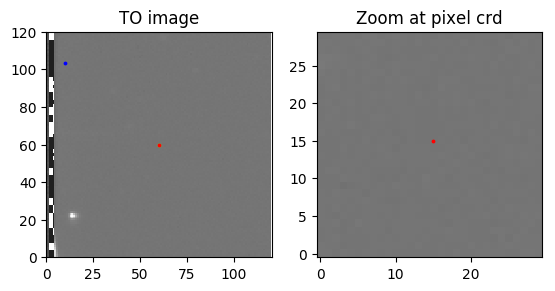

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 70.75644384  51.57641469]]
Date of observation: 2008-02-11
Pixel coordinates: [[ 59.97488307  67.98751077]]


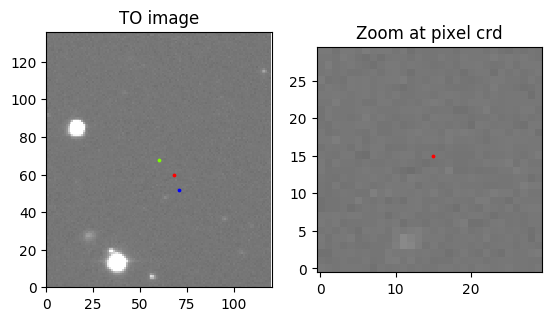

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 75.96337966  29.03390925]]
Date of observation: 2008-02-11
Pixel coordinates: [[ 59.97486653  67.98750013]]


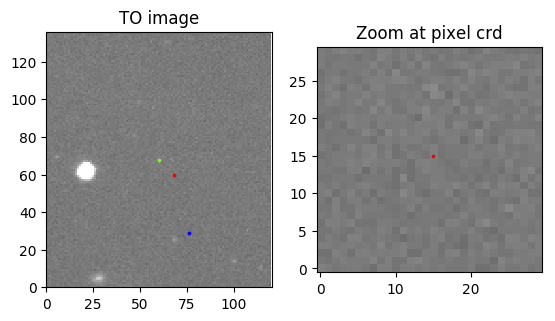

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ -2.06488526  83.78458105]]
Date of observation: 2008-02-11
Pixel coordinates: [[ 59.97842272  59.98931116]]


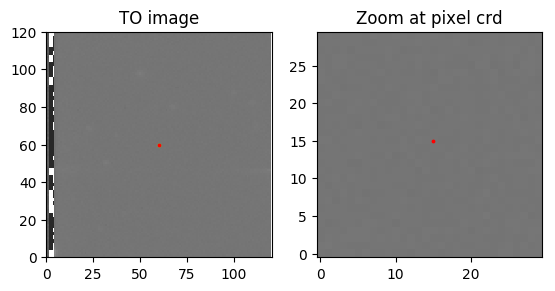

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 94.84005275  21.56844637]]
Date of observation: 2008-02-18
Pixel coordinates: [[ 60.02375162  59.99041222]]


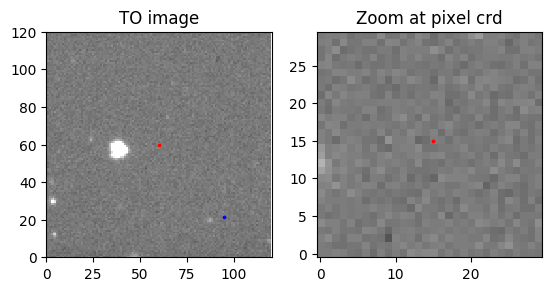

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 113.06351652   42.59221822]]
Date of observation: 2008-02-18
Pixel coordinates: [[ 60.02373784  59.9904165 ]]


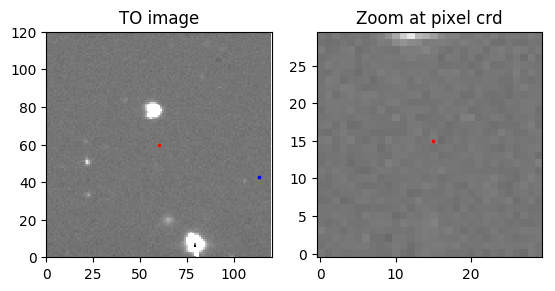

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  29.60914842  110.48781738]]
Date of observation: 2008-02-18
Pixel coordinates: [[ 59.97487371  67.98742721]]


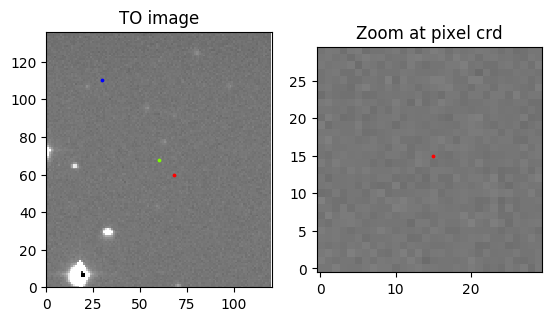

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  44.4295445   129.60171159]]
Date of observation: 2008-02-18
Pixel coordinates: [[ 59.97488763  67.98743616]]


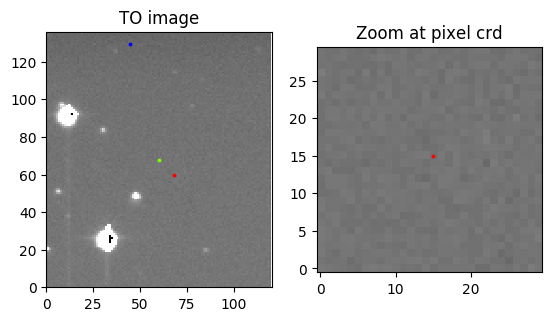

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 91.50324646  40.15788682]]
Date of observation: 2008-02-18
Pixel coordinates: [[ 60.02374009  59.99042001]]


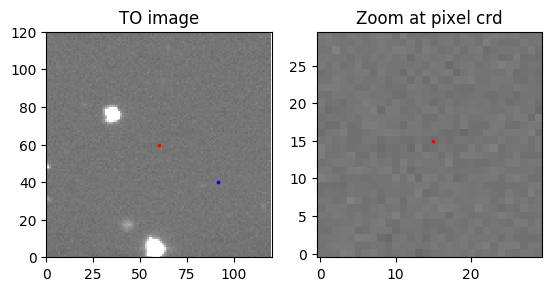

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  29.42843977  126.07223579]]
Date of observation: 2008-02-18
Pixel coordinates: [[ 59.97488667  67.98742982]]


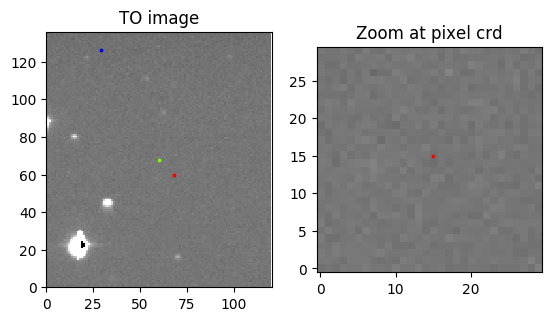

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  20.82377168  133.60695806]]
Date of observation: 2008-02-18
Pixel coordinates: [[ 59.97489061  67.98743623]]


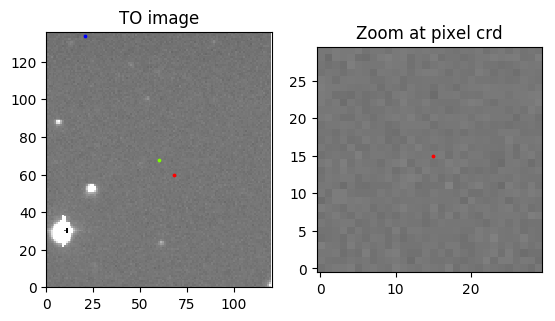

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 84.97130504  45.391885  ]]
Date of observation: 2008-02-18
Pixel coordinates: [[ 60.02373522  59.99041879]]


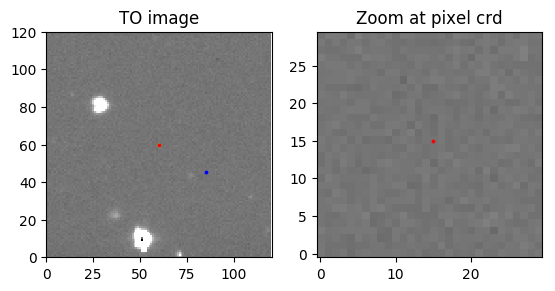

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 45.50722832  36.58772248]]
Date of observation: 2008-02-29
Pixel coordinates: [[ 59.97481758  67.98740527]]


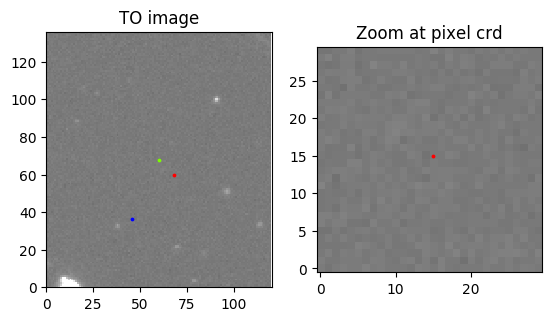

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 36.12115144  37.16594663]]
Date of observation: 2008-02-29
Pixel coordinates: [[ 59.97481904  67.98740482]]


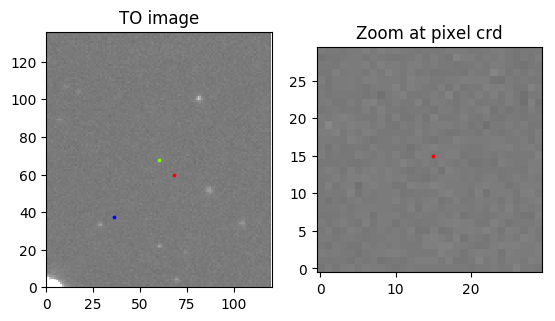

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 44.29407568  15.20550722]]
Date of observation: 2008-02-29
Pixel coordinates: [[ 59.97480098  67.98739839]]


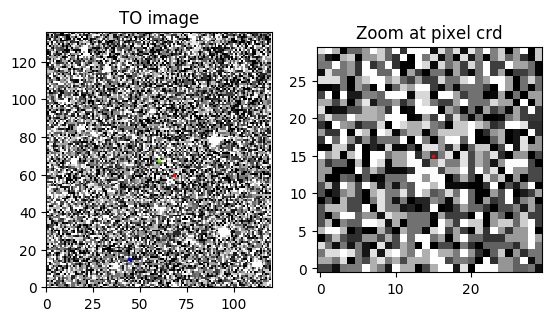

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 56.93610649  31.9591273 ]]
Date of observation: 2008-02-29
Pixel coordinates: [[ 59.97481548  67.98740243]]


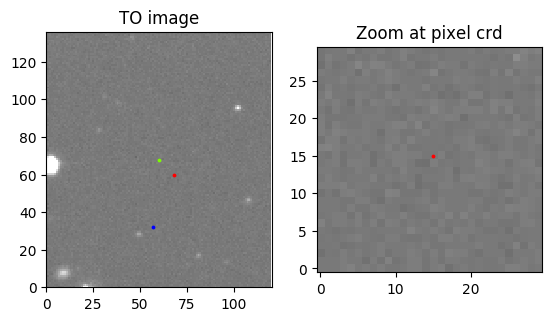

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  25.18191692  133.88860826]]
Date of observation: 2008-03-11
Pixel coordinates: [[ 59.97489363  67.98743996]]


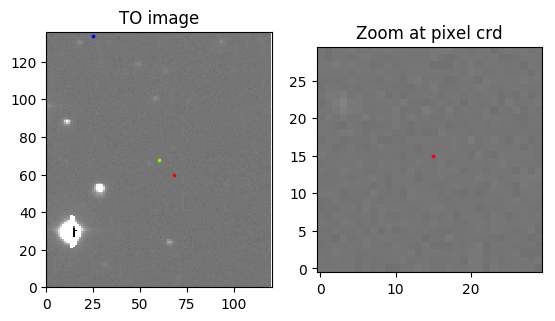

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  16.82850956  135.56436471]]
Date of observation: 2008-03-11
Pixel coordinates: [[ 59.9748938   67.98744151]]


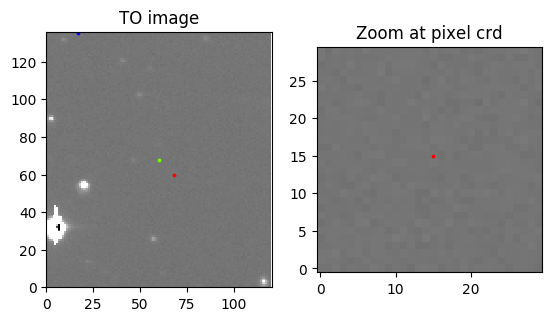

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  27.01639712  112.71055207]]
Date of observation: 2008-03-11
Pixel coordinates: [[ 59.9748763   67.98743374]]


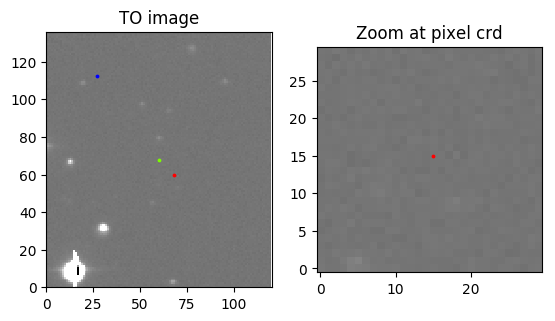

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 61.19841162  34.4403333 ]]
Date of observation: 2008-03-24
Pixel coordinates: [[ 59.97481796  67.98714004]]


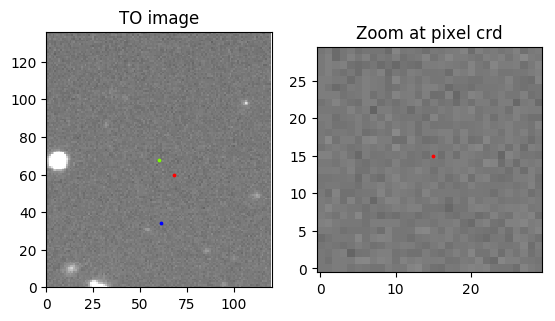

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 72.93571214  30.1596713 ]]
Date of observation: 2008-03-24
Pixel coordinates: [[ 59.97480979  67.98715365]]


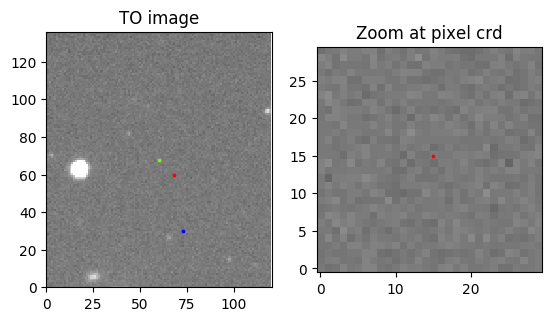

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 30.53290476   4.7318445 ]]
Date of observation: 2008-04-01
Pixel coordinates: [[ 59.97775862  59.98762325]]


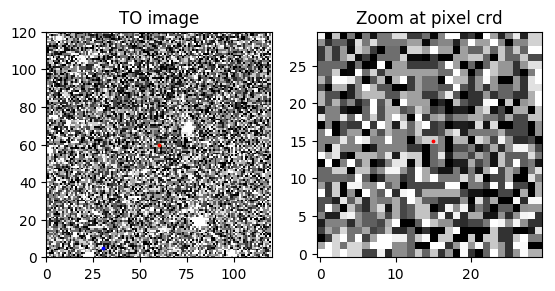

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 30.47009763  25.29216011]]
Date of observation: 2008-04-01
Pixel coordinates: [[ 59.97777051  59.98763805]]


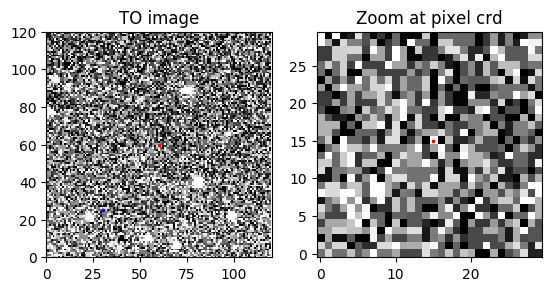

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 19.91251629  26.36424935]]
Date of observation: 2008-04-01
Pixel coordinates: [[ 59.97777498  59.98762254]]


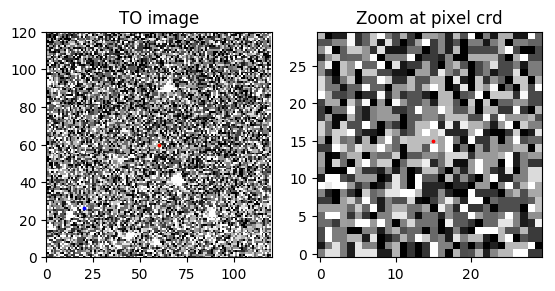

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 40.27906787  21.45300569]]
Date of observation: 2008-04-01
Pixel coordinates: [[ 59.97777385  59.98761227]]


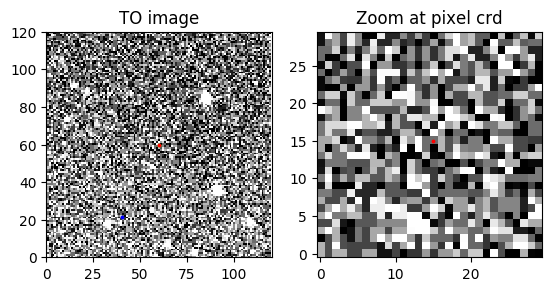

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  68.22643924  114.08669769]]
Date of observation: 2008-04-08
Pixel coordinates: [[ 59.97775882  59.98776905]]


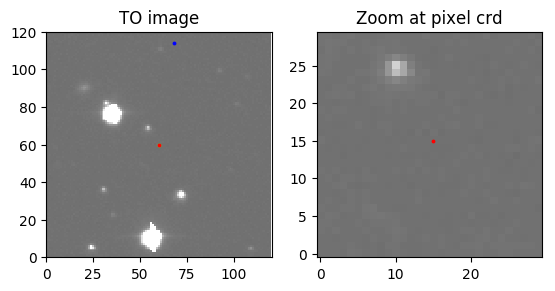

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  55.74609612  115.29687285]]
Date of observation: 2008-04-08
Pixel coordinates: [[ 59.97776099  59.98775995]]


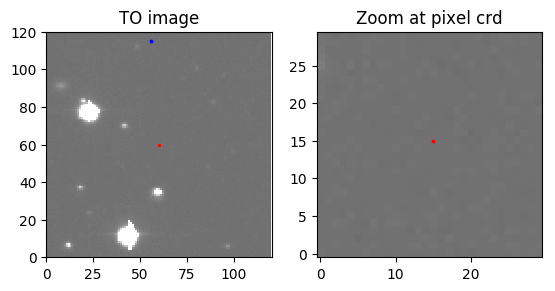

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  78.62837032  111.05107848]]
Date of observation: 2008-04-08
Pixel coordinates: [[ 59.97775986  59.98775319]]


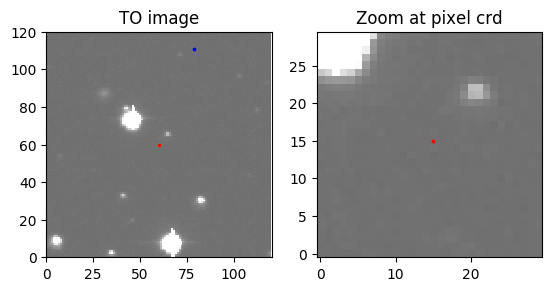

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 68.50353871  93.09479025]]
Date of observation: 2008-04-08
Pixel coordinates: [[ 59.97774592  59.98775731]]


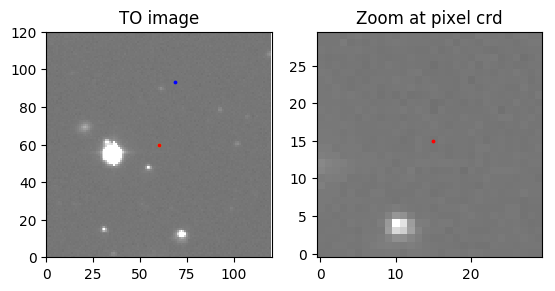

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 51.57165674  45.53444433]]
Date of observation: 2008-05-07
Pixel coordinates: [[ 59.97778201  59.98765948]]


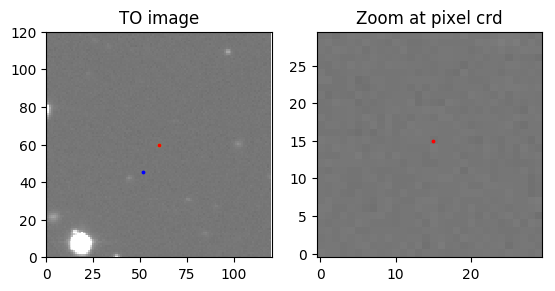

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 39.80155467  67.26226006]]
Date of observation: 2008-05-07
Pixel coordinates: [[ 59.97779945  59.98766107]]


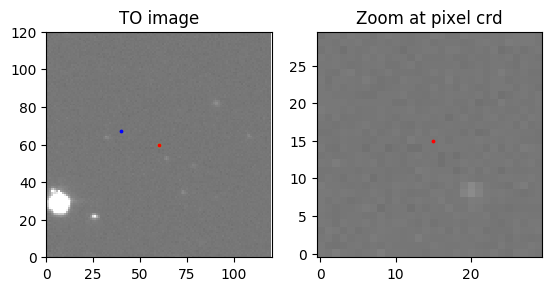

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 62.95752354  63.21865934]]
Date of observation: 2008-05-07
Pixel coordinates: [[ 59.97779763  59.98765439]]


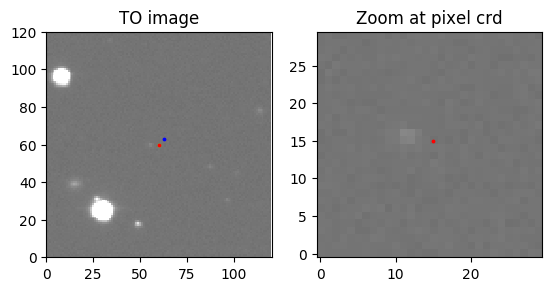

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 53.15711108  66.34145721]]
Date of observation: 2008-05-07
Pixel coordinates: [[ 59.97779567  59.98767134]]


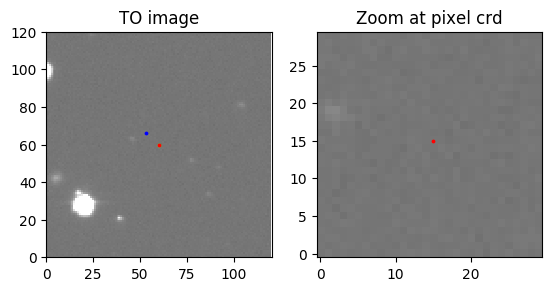

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  35.9444681   120.51550516]]
Date of observation: 2008-06-11
Pixel coordinates: [[ 59.9777803   59.98770272]]


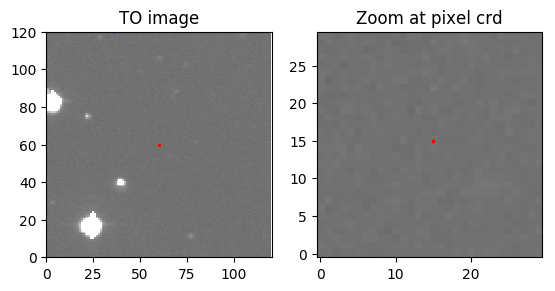

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  44.81970949  116.85690381]]
Date of observation: 2008-06-11
Pixel coordinates: [[ 59.97777533  59.98771005]]


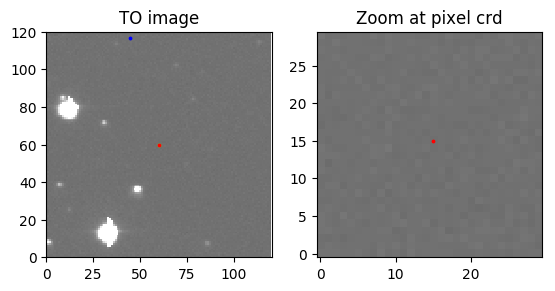

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 35.9444681    0.51550516]]
Date of observation: 2008-06-11
Pixel coordinates: [[ 59.97776353  59.98759852]]


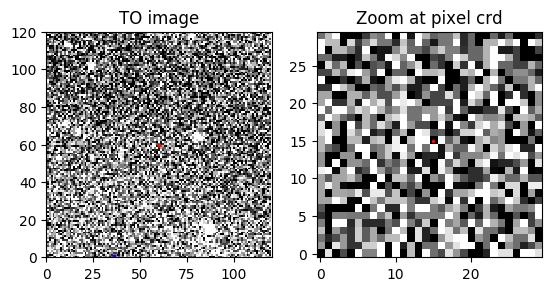

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 44.86423882  98.05282552]]
Date of observation: 2008-06-11
Pixel coordinates: [[ 59.97776395  59.98769964]]


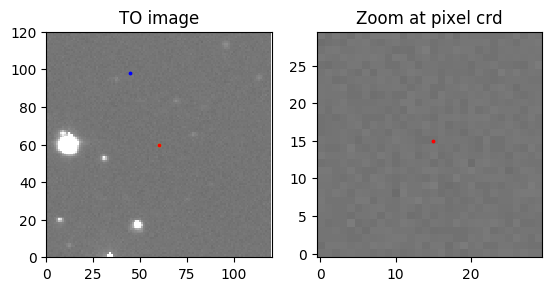

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 55.88406242  -1.46385435]]
Date of observation: 2008-06-11
Pixel coordinates: [[ 59.97776305  59.98759325]]


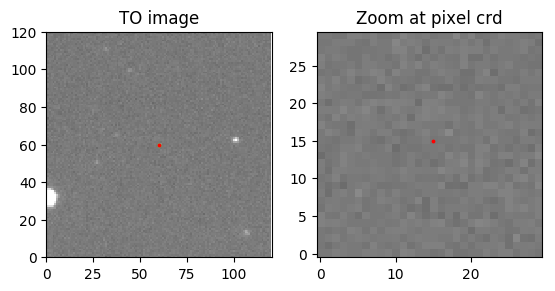

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  55.88406242  118.53614565]]
Date of observation: 2008-06-11
Pixel coordinates: [[ 59.97777925  59.9876974 ]]


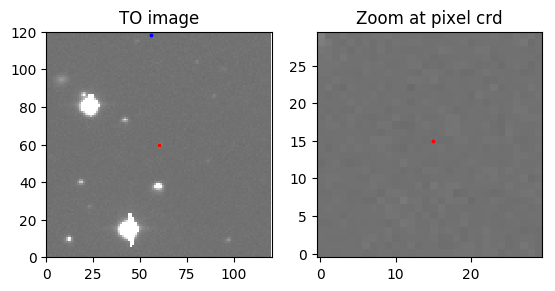

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 86.20337032  96.24901678]]
Date of observation: 2008-06-24
Pixel coordinates: [[ 59.97778019  59.98761428]]


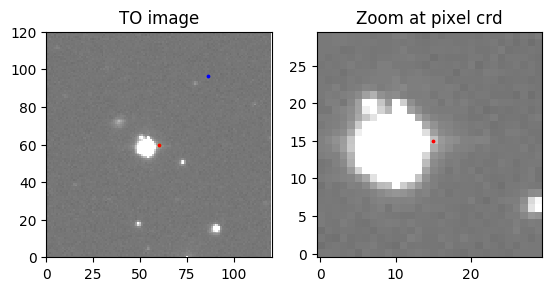

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 82.83315616  72.93465195]]
Date of observation: 2008-06-24
Pixel coordinates: [[ 59.97776174  59.98762435]]


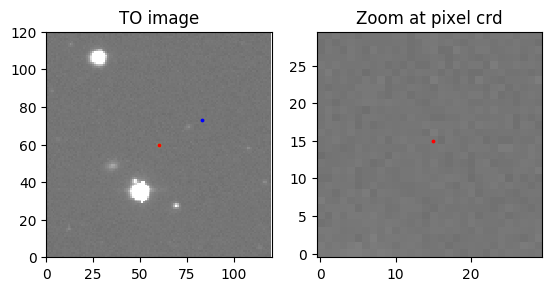

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 70.75044476  98.16916738]]
Date of observation: 2008-06-24
Pixel coordinates: [[ 59.97777967  59.98762325]]


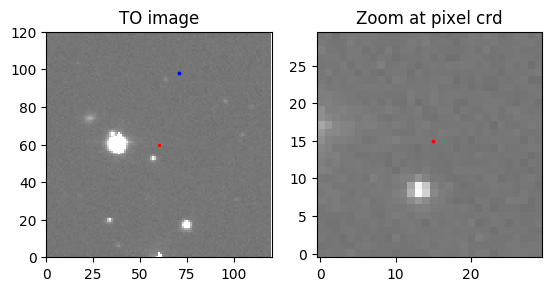

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 86.32164118  91.23599478]]
Date of observation: 2008-06-24
Pixel coordinates: [[ 59.97777092  59.98764059]]


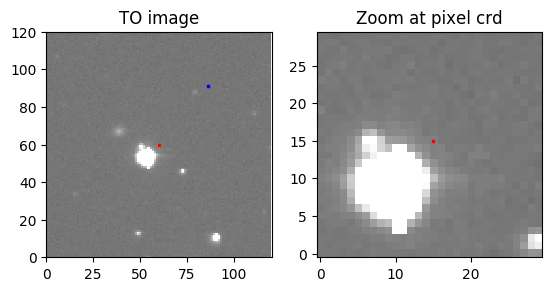

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 115.37812283   63.58094396]]
Date of observation: 2008-12-05
Pixel coordinates: [[ 59.97788223  59.98761781]]


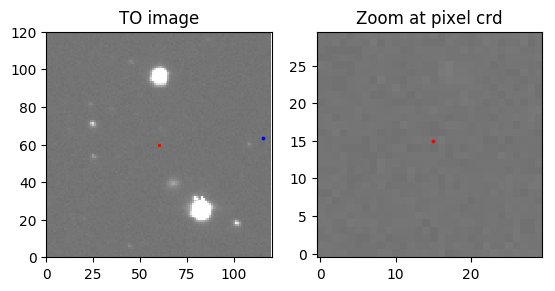

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 11.88829597  76.41925343]]
Date of observation: 2008-12-05
Pixel coordinates: [[ 59.99609461  59.98866464]]


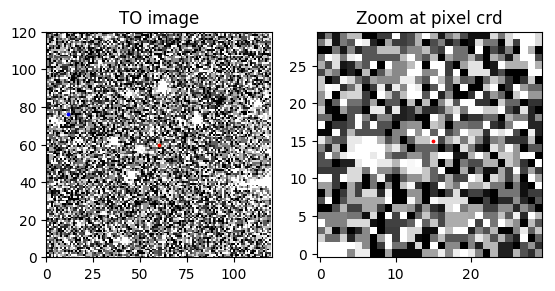

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 109.3819359    86.35388109]]
Date of observation: 2008-12-05
Pixel coordinates: [[ 59.97789821  59.98762697]]


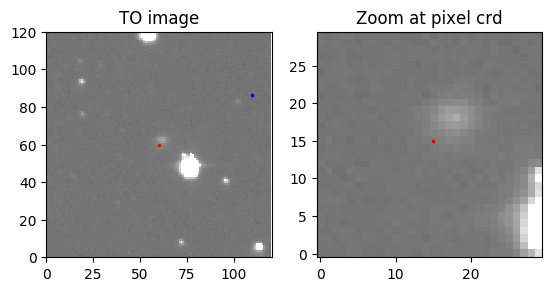

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 114.64102738   74.74392321]]
Date of observation: 2008-12-05
Pixel coordinates: [[ 59.97789064  59.98761929]]


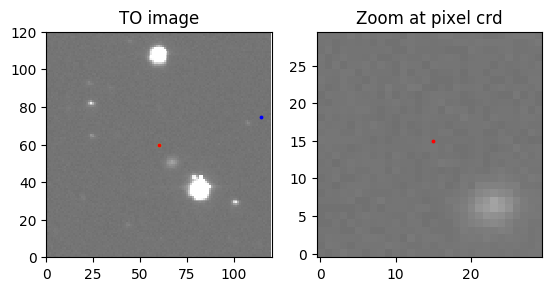

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 49.44417722  21.90187421]]
Date of observation: 2008-12-06
Pixel coordinates: [[ 60.02373276  59.99073231]]


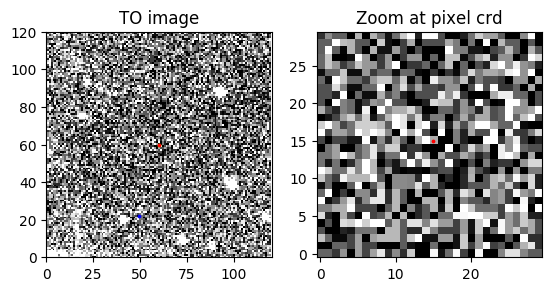

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 35.85291692   4.02116059]]
Date of observation: 2008-12-06
Pixel coordinates: [[ 60.02374549  59.99072747]]


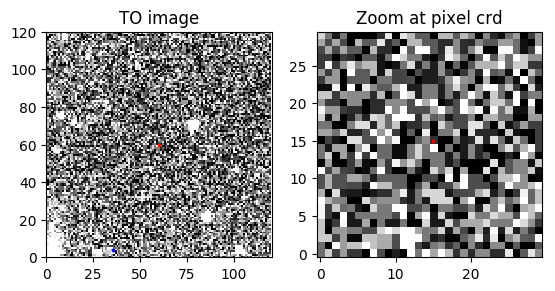

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 32.42569482  25.42368626]]
Date of observation: 2008-12-06
Pixel coordinates: [[ 60.02372981  59.99073615]]


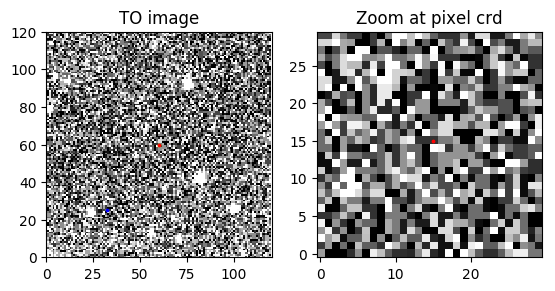

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 27.16591676  26.5156967 ]]
Date of observation: 2008-12-06
Pixel coordinates: [[ 60.02372868  59.99073325]]


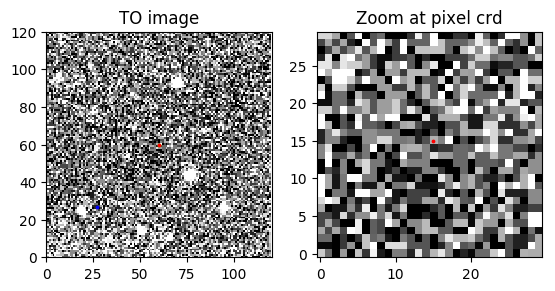

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 33.0422111   23.36986063]]
Date of observation: 2008-12-06
Pixel coordinates: [[ 60.02373053  59.9907346 ]]


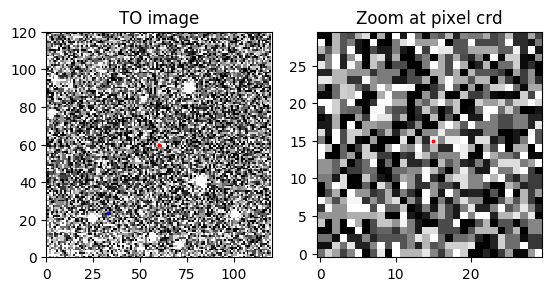

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 25.33641542  35.00683176]]
Date of observation: 2009-01-02
Pixel coordinates: [[ 60.00801629  67.9920284 ]]


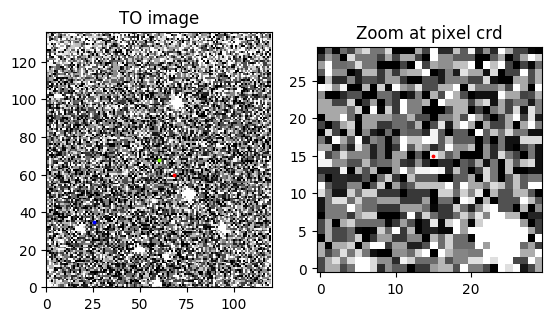

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 14.44909412  54.99920035]]
Date of observation: 2009-01-02
Pixel coordinates: [[ 60.01187945  67.9903286 ]]


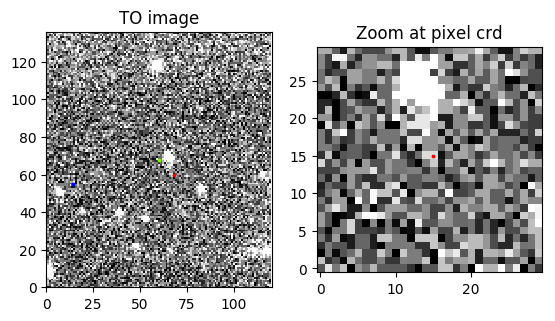

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 34.58822559  48.35828038]]
Date of observation: 2009-01-02
Pixel coordinates: [[ 60.01635365  67.98835586]]


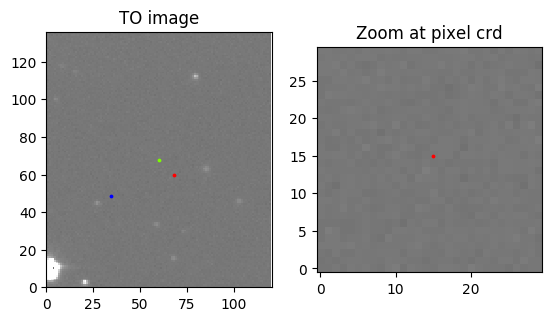

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 23.23266744  57.81988174]]
Date of observation: 2009-01-02
Pixel coordinates: [[ 60.00504332  67.99231578]]


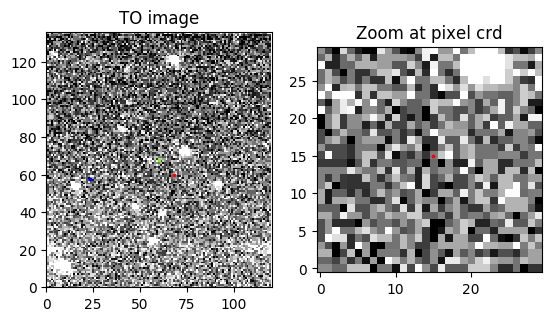

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  4.65513721  96.52585576]]
Date of observation: 2009-01-29
Pixel coordinates: [[ 60.0022801   67.99110278]]


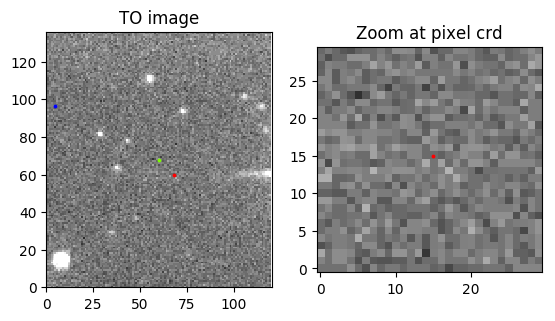

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 27.81216854  91.18305456]]
Date of observation: 2009-01-29
Pixel coordinates: [[ 60.00322274  67.99151784]]


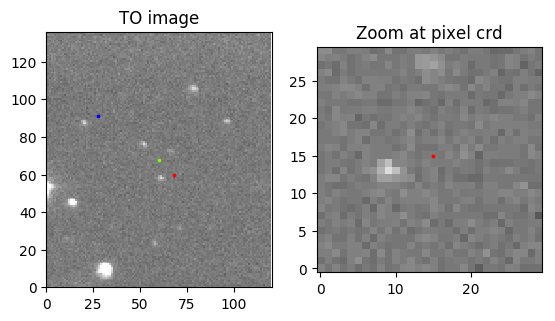

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 14.49034564  74.78690387]]
Date of observation: 2009-01-29
Pixel coordinates: [[ 60.00212706  67.99103184]]


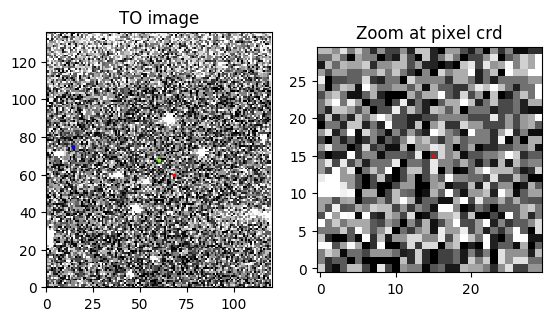

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 12.17164736  95.77612798]]
Date of observation: 2009-01-29
Pixel coordinates: [[ 60.0021722   67.99105508]]


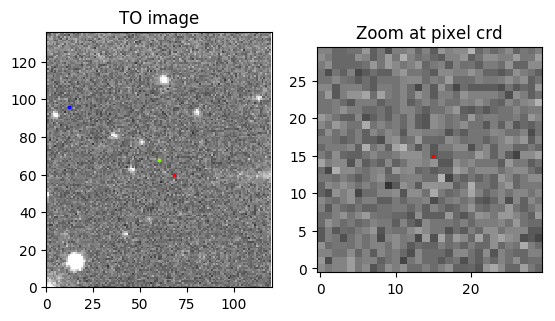

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 66.37634871   3.71170373]]
Date of observation: 2009-02-04
Pixel coordinates: [[ 60.02547171  67.98679492]]


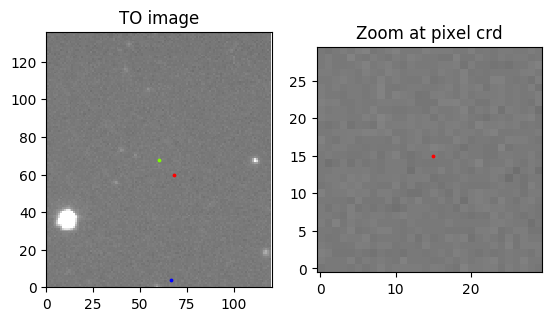

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  88.71065241  113.55941669]]
Date of observation: 2009-02-04
Pixel coordinates: [[ 60.02248366  59.98722665]]


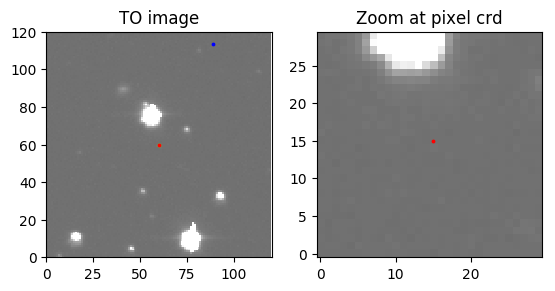

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  78.45744049  106.47786646]]
Date of observation: 2009-02-04
Pixel coordinates: [[ 60.01863239  59.98721338]]


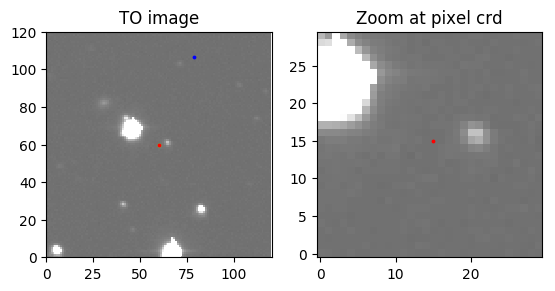

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 78.28314866  12.99040022]]
Date of observation: 2009-02-04
Pixel coordinates: [[ 60.01465432  67.98909894]]


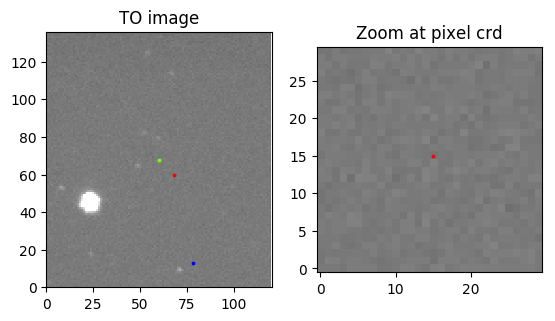

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  45.5460487  103.0204186]]
Date of observation: 2009-02-21
Pixel coordinates: [[ 60.01550172  67.98874048]]


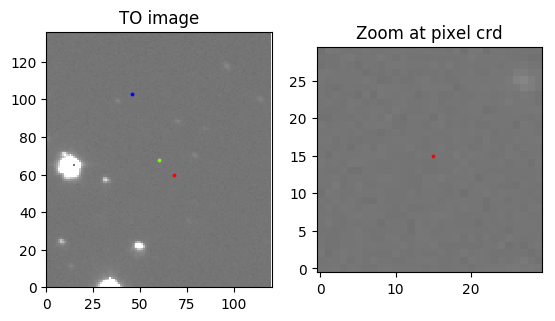

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 33.97953014  87.31336134]]
Date of observation: 2009-02-21
Pixel coordinates: [[ 60.01047712  67.99095262]]


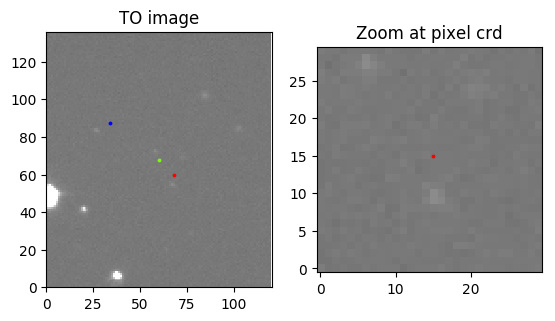

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  33.40060345  104.57619104]]
Date of observation: 2009-02-21
Pixel coordinates: [[ 60.00980468  67.99125197]]


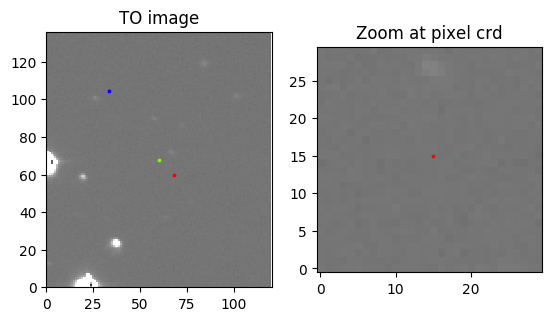

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  25.30621192  108.54036356]]
Date of observation: 2009-02-21
Pixel coordinates: [[ 60.01284945  67.9899101 ]]


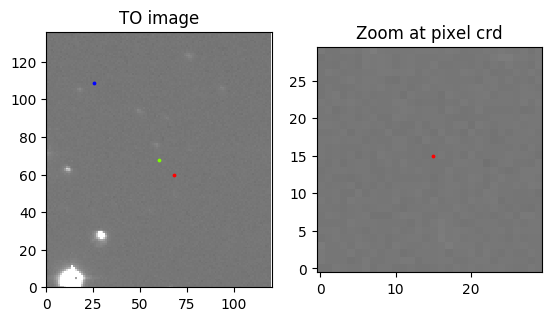

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 120.13715686   79.82240875]]
Date of observation: 2009-03-03
Pixel coordinates: [[ 59.97498858  67.98728689]]


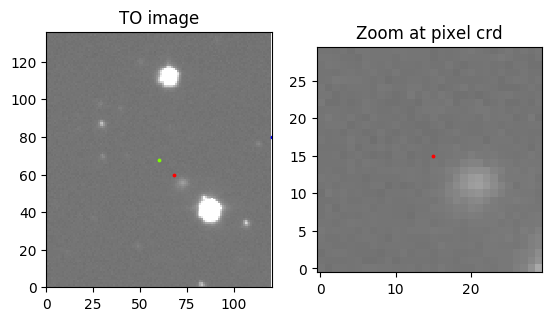

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 14.16544297  76.43432164]]
Date of observation: 2009-03-03
Pixel coordinates: [[ 60.00400698  67.99186255]]


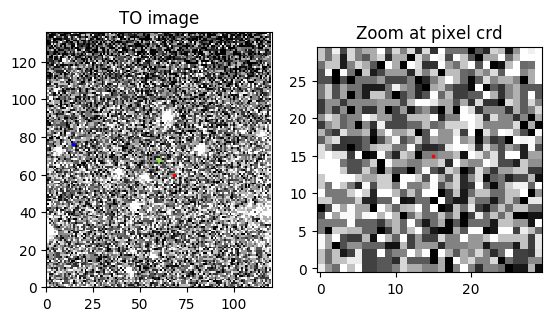

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  0.13715686  79.82240875]]
Date of observation: 2009-03-03
Pixel coordinates: [[ 60.00722832  67.99238215]]


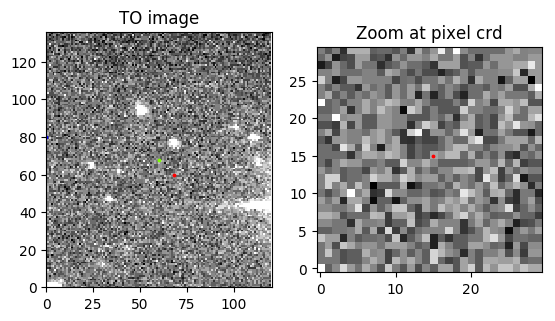

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 112.16393325   80.63043982]]
Date of observation: 2009-03-03
Pixel coordinates: [[ 59.97498834  67.98728961]]


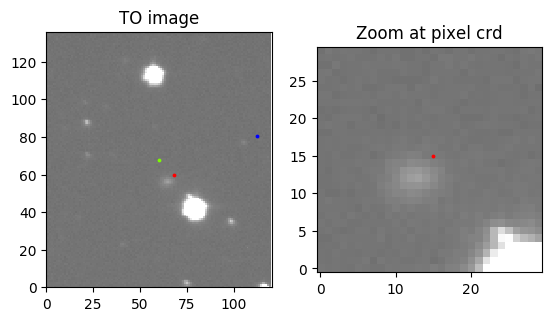

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  3.39396876  58.96987004]]
Date of observation: 2009-03-03
Pixel coordinates: [[ 60.00553955  67.99253527]]


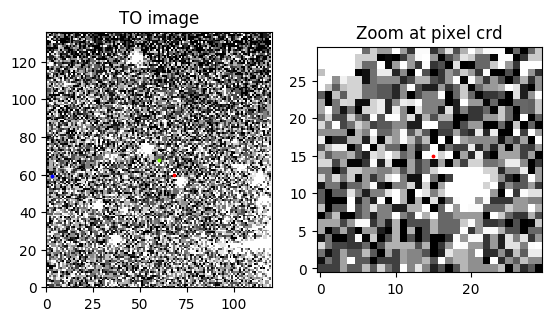

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 75.49757055  60.35182228]]
Date of observation: 2009-03-17
Pixel coordinates: [[ 60.02253091  59.98725643]]


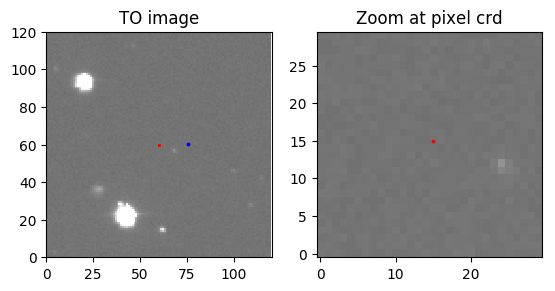

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 63.12391505  62.29292573]]
Date of observation: 2009-03-17
Pixel coordinates: [[ 60.02252661  59.98724564]]


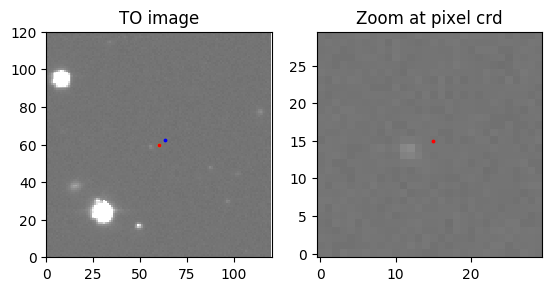

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 65.27542495  41.82197324]]
Date of observation: 2009-03-17
Pixel coordinates: [[ 60.02254107  59.98724234]]


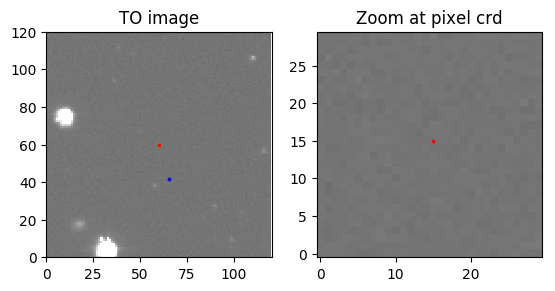

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 52.39556164  64.52923478]]
Date of observation: 2009-03-17
Pixel coordinates: [[ 60.02252668  59.98725395]]


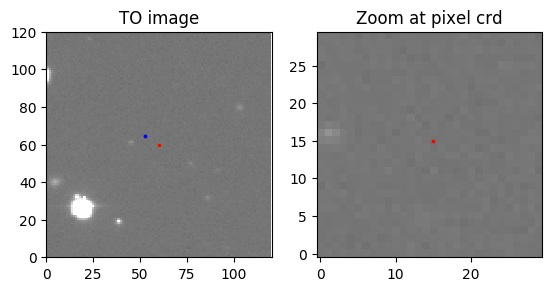

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  5.07235394  37.81809091]]
Date of observation: 2009-03-28
Pixel coordinates: [[ 60.02371806  59.9907412 ]]


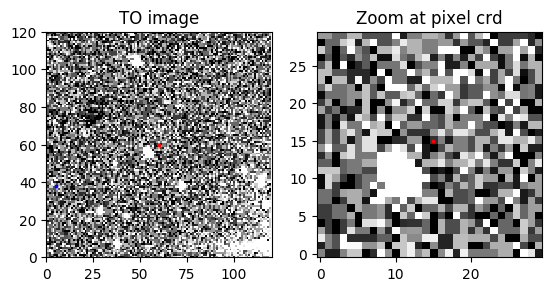

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 29.87031096  34.03668513]]
Date of observation: 2009-03-28
Pixel coordinates: [[ 60.02372147  59.99074018]]


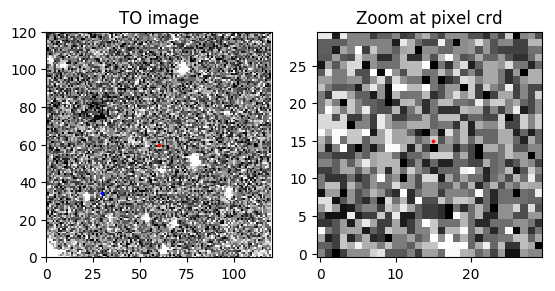

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 13.96522021  15.49758792]]
Date of observation: 2009-03-28
Pixel coordinates: [[ 60.0237331  59.9907335]]


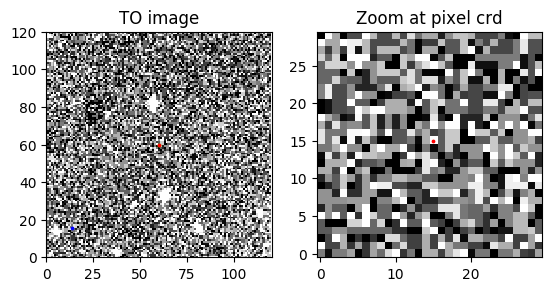

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  31.19446241  119.17394431]]
Date of observation: 2009-03-28
Pixel coordinates: [[ 59.99984349  67.99003409]]


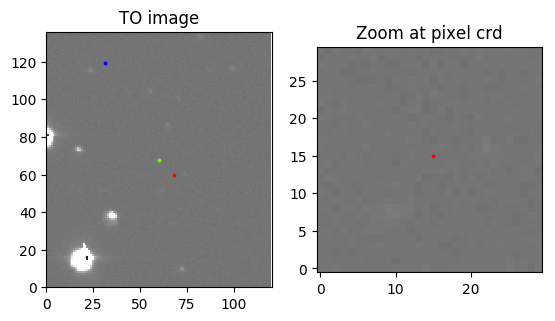

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 39.17772998  96.34914478]]
Date of observation: 2009-03-28
Pixel coordinates: [[ 59.99918521  67.98974025]]


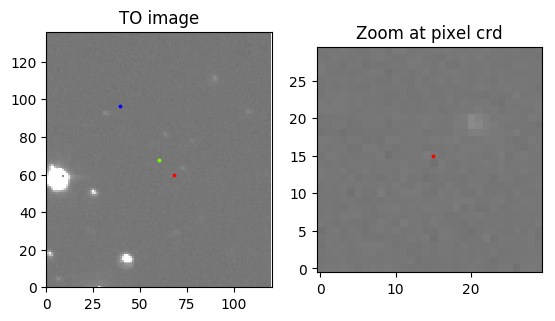

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 12.93552779  36.080831  ]]
Date of observation: 2009-03-28
Pixel coordinates: [[ 60.02371983  59.99073991]]


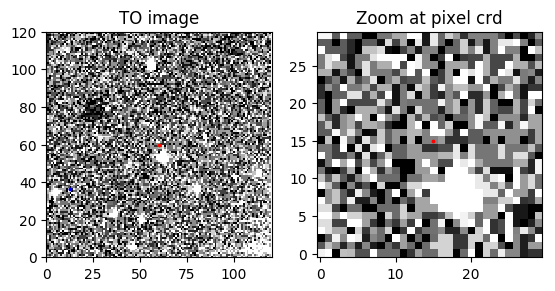

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  40.0548563   117.22461593]]
Date of observation: 2009-03-28
Pixel coordinates: [[ 59.99902974  67.98967458]]


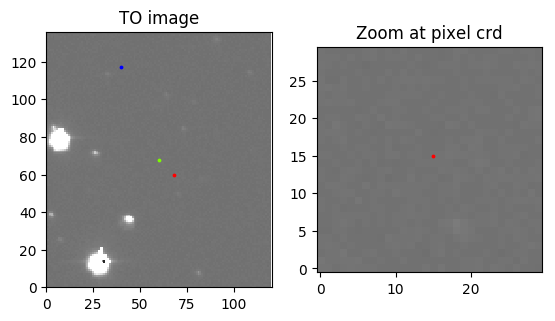

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  54.99106987  114.58791796]]
Date of observation: 2009-03-28
Pixel coordinates: [[ 60.00086228  67.99048254]]


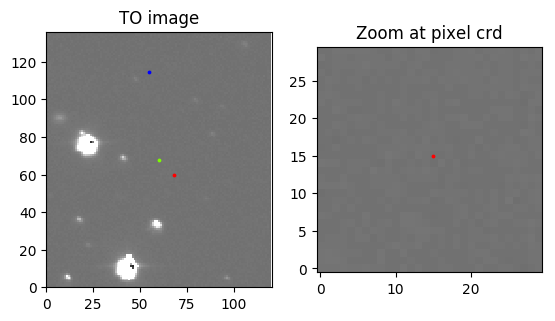

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  50.47785466  115.57775311]]
Date of observation: 2009-05-25
Pixel coordinates: [[ 60.02256652  59.98738285]]


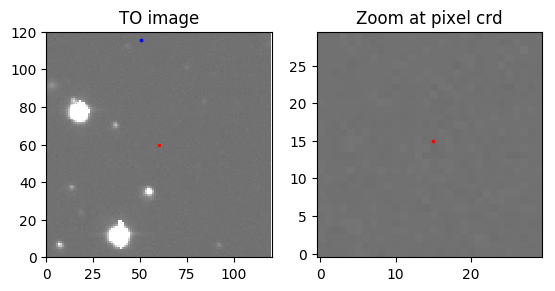

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 50.99047476  87.66192608]]
Date of observation: 2009-05-25
Pixel coordinates: [[ 60.02258784  59.98738096]]


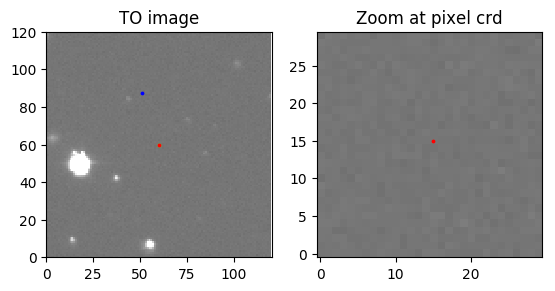

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  38.75190711  104.05676762]]
Date of observation: 2009-05-25
Pixel coordinates: [[ 60.02257909  59.98739381]]


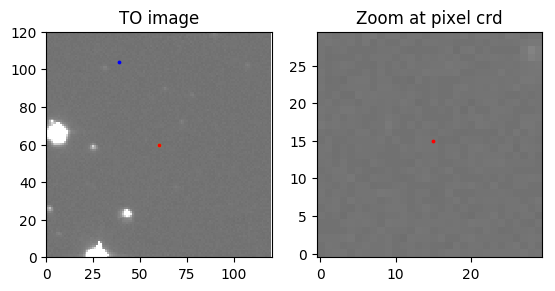

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 58.07280414  93.74948099]]
Date of observation: 2009-05-25
Pixel coordinates: [[ 60.0225888   59.98740065]]


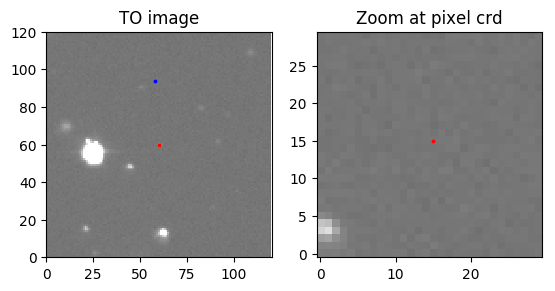

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 80.89947651  77.25028157]]
Date of observation: 2009-06-22
Pixel coordinates: [[ 60.02261057  59.98743099]]


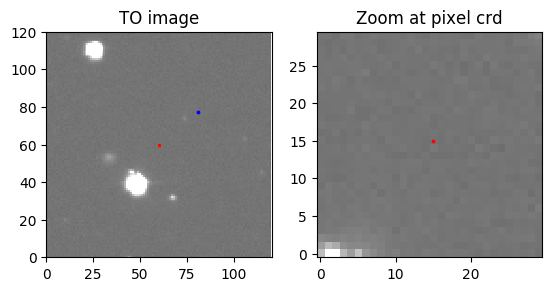

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 76.70706724  75.06649206]]
Date of observation: 2009-06-22
Pixel coordinates: [[ 60.02260703  59.98740946]]


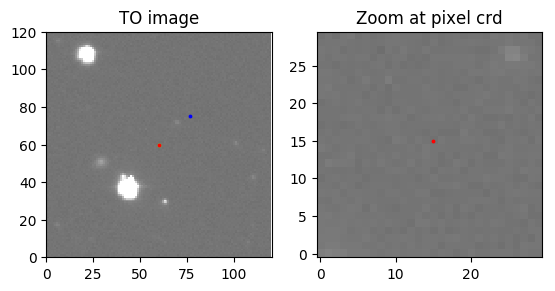

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 63.36900091  79.41320731]]
Date of observation: 2009-06-22
Pixel coordinates: [[ 60.02260755  59.98742558]]


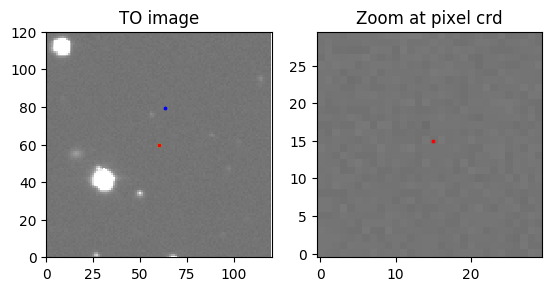

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 76.60579285  55.46477247]]
Date of observation: 2009-06-22
Pixel coordinates: [[ 60.02262151  59.98740964]]


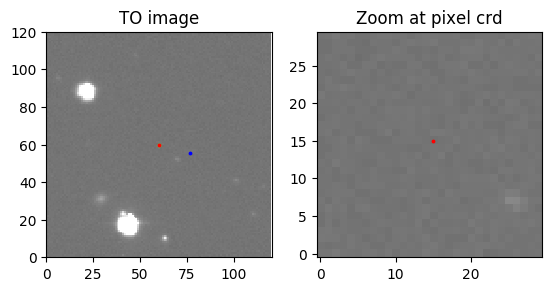

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 36.46462698  27.31793035]]
Date of observation: 2009-11-08
Pixel coordinates: [[ 60.02372764  59.99072971]]


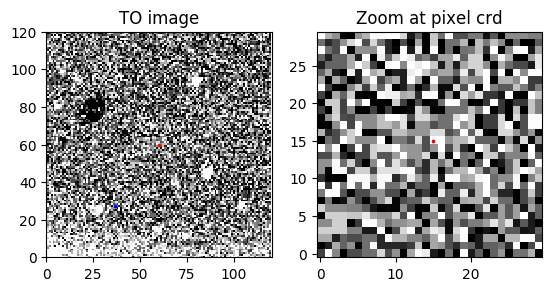

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  68.61758762  113.58070522]]
Date of observation: 2009-11-08
Pixel coordinates: [[ 59.9844205   67.98719986]]


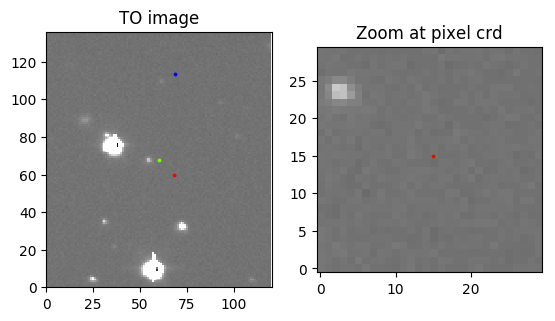

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  53.861663    103.03026934]]
Date of observation: 2009-11-08
Pixel coordinates: [[ 59.99069714  67.98719047]]


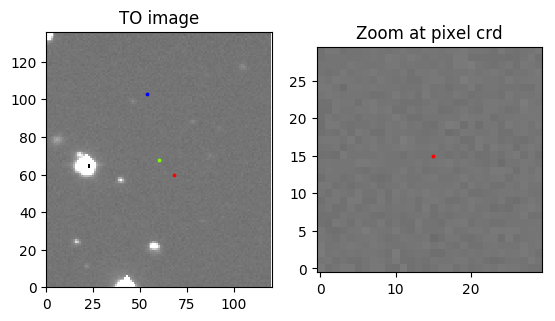

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 21.1884462    5.95466573]]
Date of observation: 2009-11-08
Pixel coordinates: [[ 60.02374374  59.99072642]]


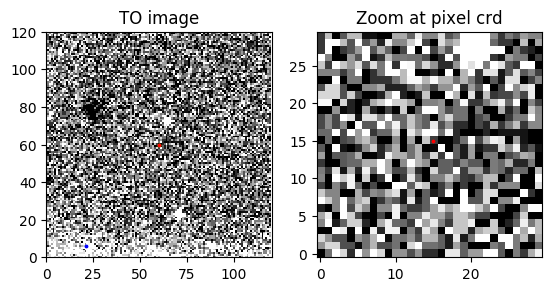

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 10.80104817  29.70691552]]
Date of observation: 2009-11-08
Pixel coordinates: [[ 60.02372596  59.99073228]]


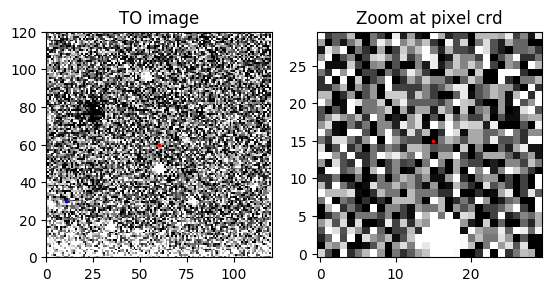

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 15.84984416  23.60286838]]
Date of observation: 2009-11-08
Pixel coordinates: [[ 60.02373138  59.9907339 ]]


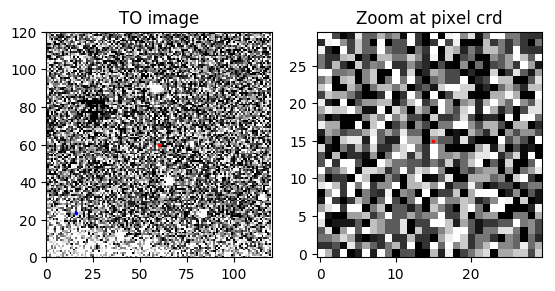

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 55.5288491   92.44435385]]
Date of observation: 2009-11-08
Pixel coordinates: [[ 59.98801619  67.98718922]]


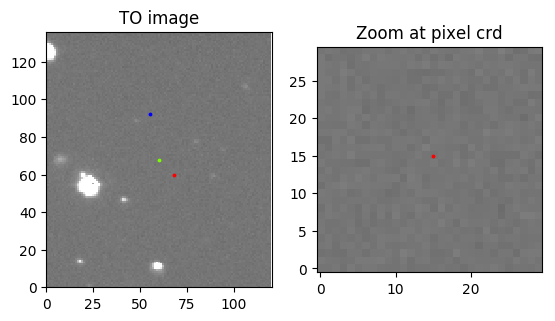

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  46.963686    115.63250968]]
Date of observation: 2009-11-08
Pixel coordinates: [[ 59.98620161  67.98719904]]


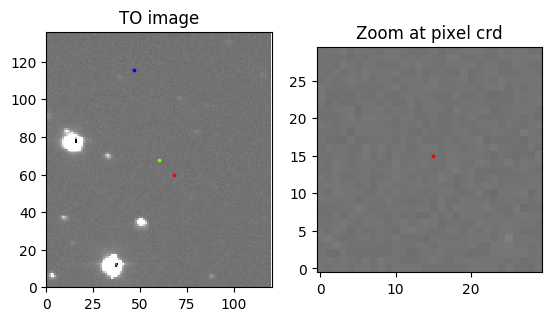

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 69.78029434  80.14097686]]
Date of observation: 2009-11-20
Pixel coordinates: [[ 59.97497822  67.98730794]]


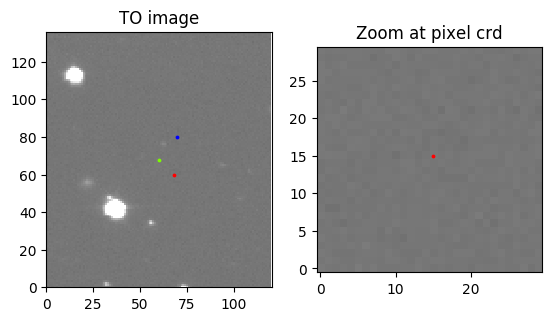

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 91.84353501  75.07665501]]
Date of observation: 2009-11-20
Pixel coordinates: [[ 59.97497324  67.9873071 ]]


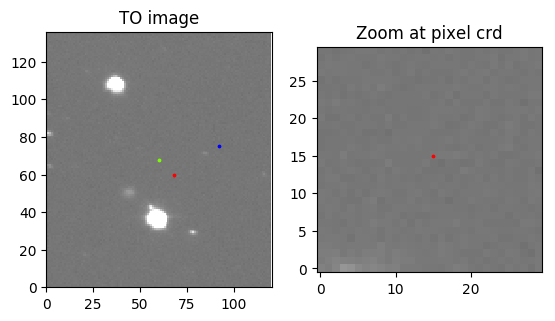

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 78.72037147  57.87053838]]
Date of observation: 2009-11-20
Pixel coordinates: [[ 59.97496038  67.98729881]]


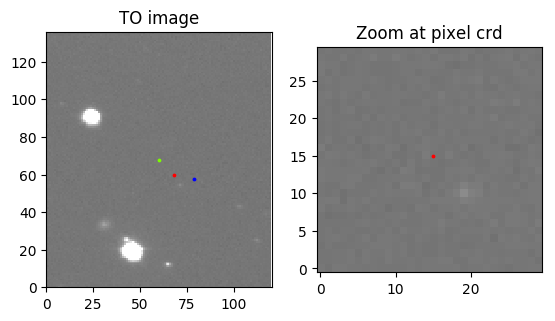

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 75.52969262  78.03391547]]
Date of observation: 2009-11-20
Pixel coordinates: [[ 59.97497671  67.98730363]]


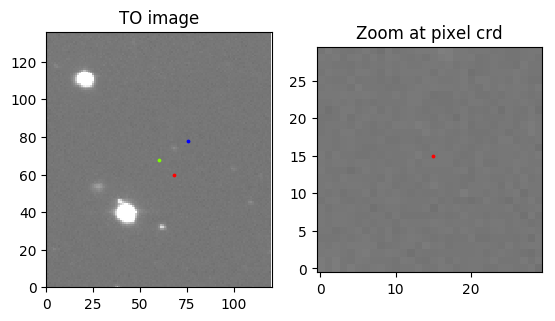

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 119.70487094    8.83609105]]
Date of observation: 2009-12-19
Pixel coordinates: [[ 59.97492935  67.9872645 ]]


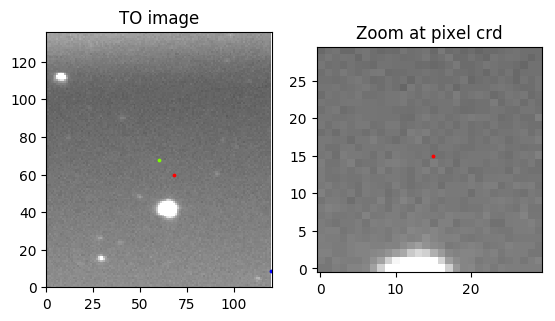

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 15.91865718  96.64716161]]
Date of observation: 2009-12-19
Pixel coordinates: [[ 60.00163375  59.9914378 ]]


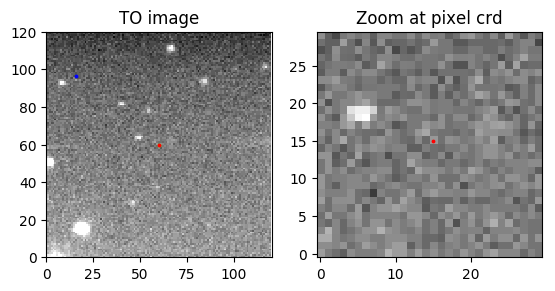

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  32.43746156  120.82087094]]
Date of observation: 2009-12-19
Pixel coordinates: [[ 60.00853619  59.99152054]]


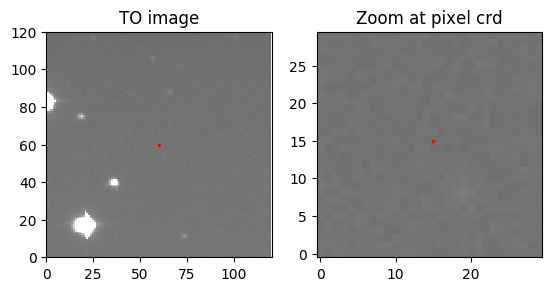

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 14.39324022   8.93511684]]
Date of observation: 2009-12-19
Pixel coordinates: [[ 59.99973381  67.98996545]]


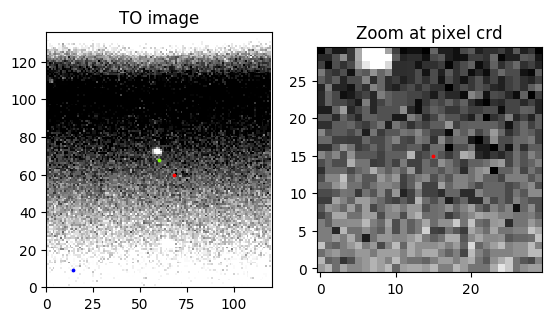

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 32.43746156   0.82087094]]
Date of observation: 2009-12-19
Pixel coordinates: [[ 60.00965989  67.99129784]]


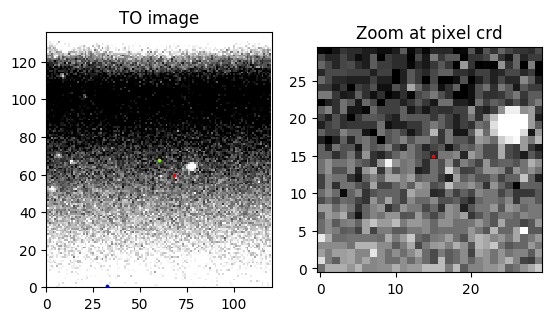

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[-0.29512906  8.83609105]]
Date of observation: 2009-12-19
Pixel coordinates: [[ 60.00590973  67.99268936]]


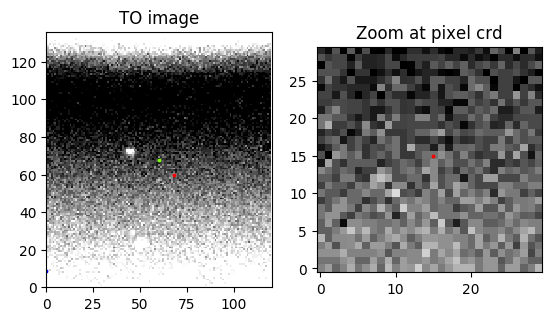

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 102.28917608   98.41383792]]
Date of observation: 2010-01-15
Pixel coordinates: [[ 59.97790759  59.98762583]]


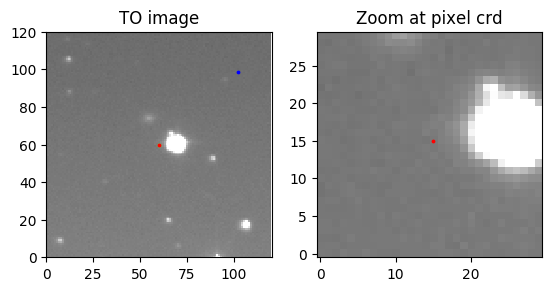

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 101.92611527   17.36114081]]
Date of observation: 2010-01-15
Pixel coordinates: [[ 59.97493602  67.98726722]]


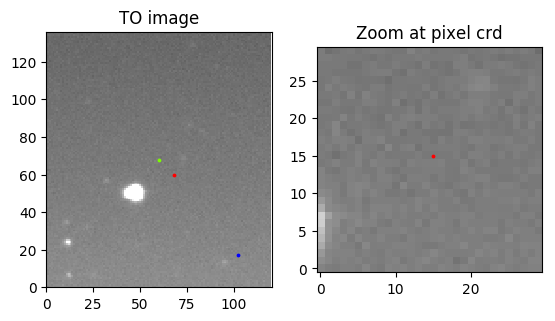

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 119.31129402    3.08705202]]
Date of observation: 2010-01-15
Pixel coordinates: [[ 59.97492865  67.98725257]]


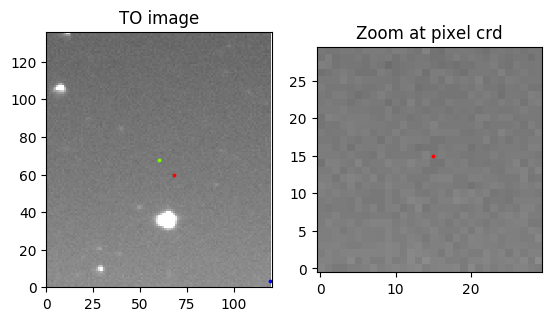

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[-0.68870598  3.08705202]]
Date of observation: 2010-01-15
Pixel coordinates: [[ 60.0193348   67.98703531]]


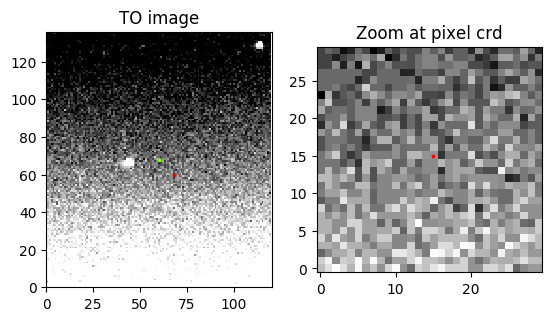

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 84.28041539  11.0654537 ]]
Date of observation: 2010-01-15
Pixel coordinates: [[ 59.97493283  67.98725913]]


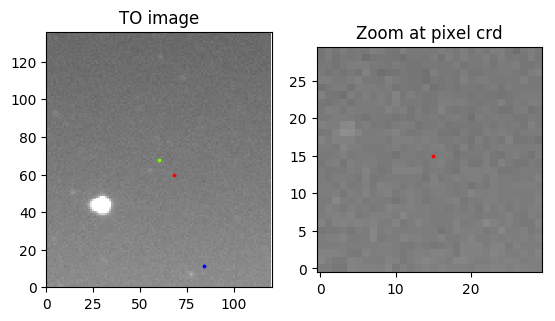

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 90.34847304  71.52592006]]
Date of observation: 2010-02-15
Pixel coordinates: [[ 59.97788698  59.98762642]]


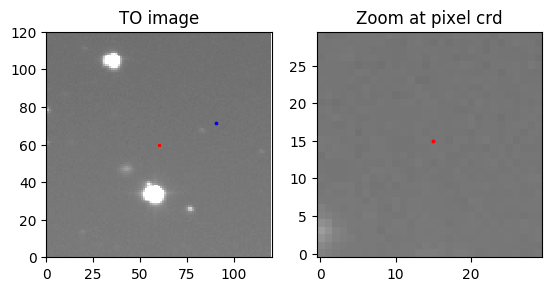

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 71.71823438  67.2922172 ]]
Date of observation: 2010-02-15
Pixel coordinates: [[ 59.97788533  59.98762416]]


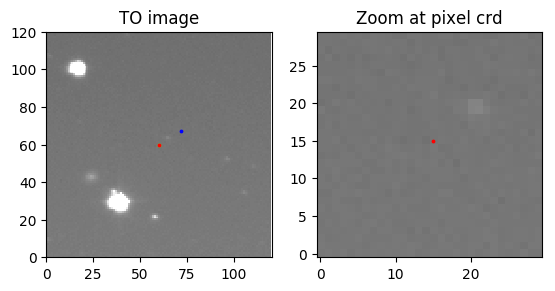

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 91.00789866  34.17260324]]
Date of observation: 2010-02-15
Pixel coordinates: [[ 59.97786159  59.98761339]]


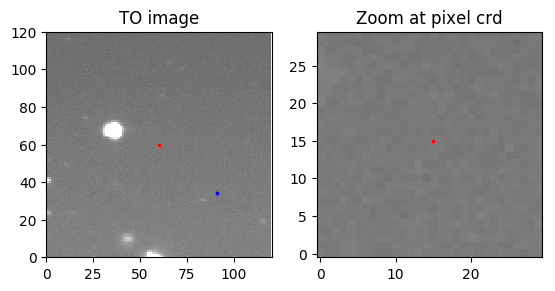

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 108.2941335    60.54616865]]
Date of observation: 2010-02-15
Pixel coordinates: [[ 59.97788094  59.98762092]]


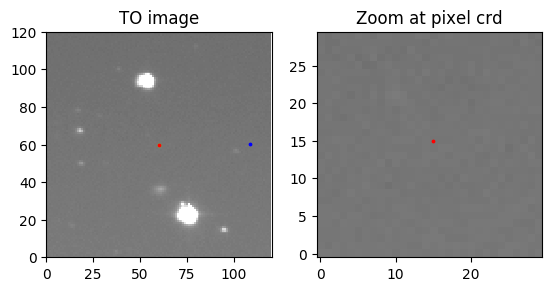

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 39.48539837   9.90251075]]
Date of observation: 2010-02-17
Pixel coordinates: [[ 60.02374211  59.99074647]]


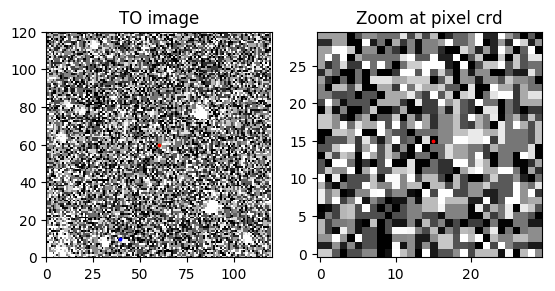

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 23.7440509   13.62756103]]
Date of observation: 2010-02-17
Pixel coordinates: [[ 60.02374099  59.9907543 ]]


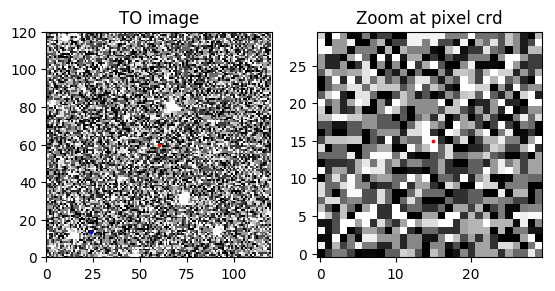

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 59.73968809   7.56015238]]
Date of observation: 2010-02-17
Pixel coordinates: [[ 60.02374527  59.9907559 ]]


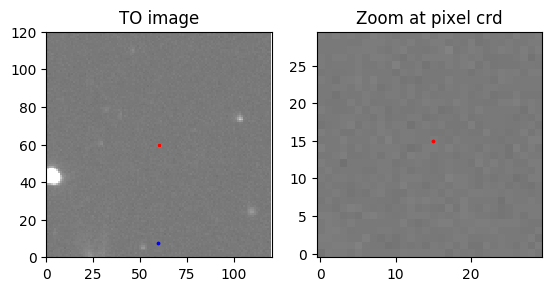

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  1.51843608  35.97276856]]
Date of observation: 2010-03-04
Pixel coordinates: [[ 59.97833376  59.98874499]]


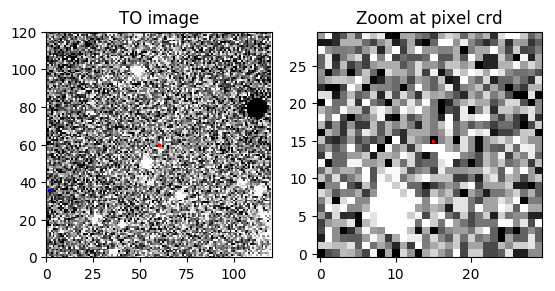

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 66.87222352  94.63320767]]
Date of observation: 2010-03-04
Pixel coordinates: [[ 60.02250773  59.98726597]]


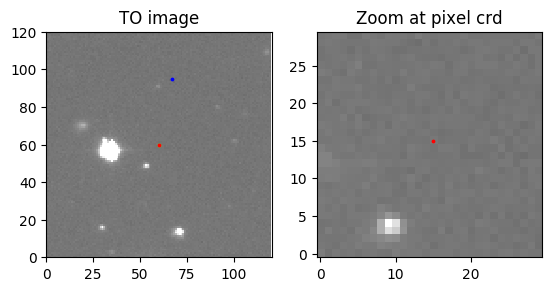

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 106.15126631   32.94554982]]
Date of observation: 2010-03-04
Pixel coordinates: [[ 59.9783866   59.98886573]]


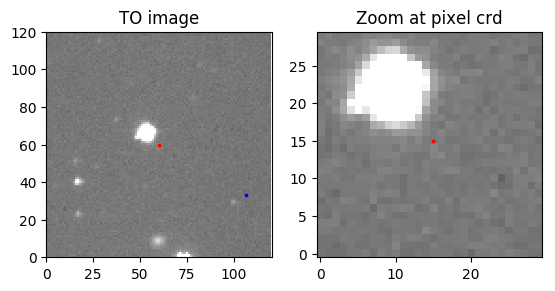

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 86.59053866  39.71032817]]
Date of observation: 2010-03-04
Pixel coordinates: [[ 59.97839446  59.98885302]]


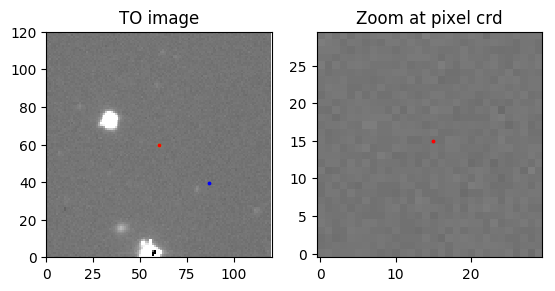

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 67.4925079    3.22575033]]
Date of observation: 2010-03-04
Pixel coordinates: [[ 60.02549147  67.98684713]]


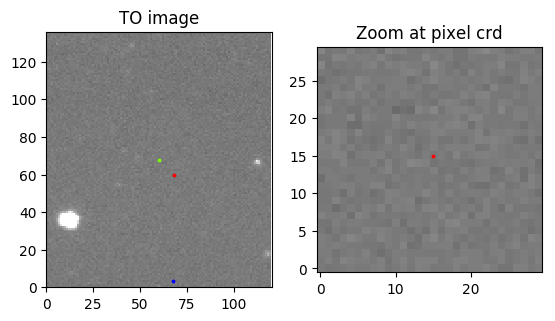

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 83.01297888   4.24096707]]
Date of observation: 2010-03-04
Pixel coordinates: [[ 60.02549655  67.98686499]]


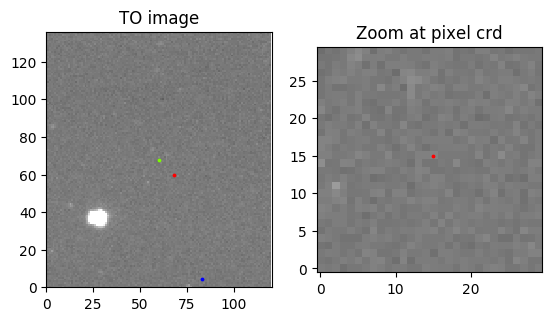

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 107.31697101    3.49285993]]
Date of observation: 2010-03-04
Pixel coordinates: [[ 59.97836731  59.98884904]]


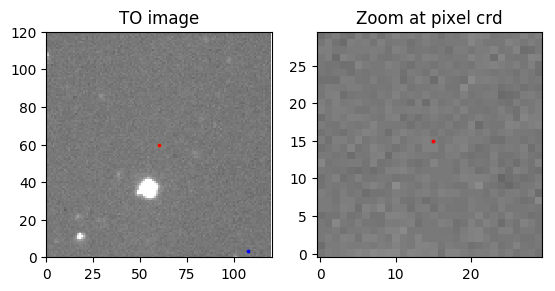

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 121.51843608   35.97276856]]
Date of observation: 2010-03-04
Pixel coordinates: [[ 59.97839268  59.98884438]]


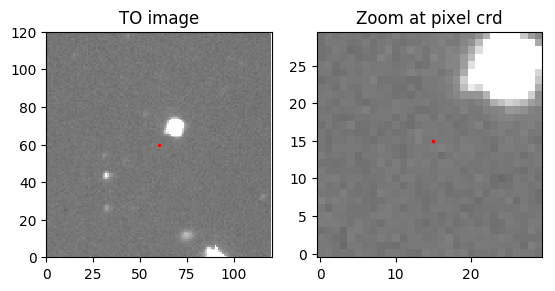

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 49.95461152   9.88105964]]
Date of observation: 2010-03-04
Pixel coordinates: [[ 60.02548959  67.98686154]]


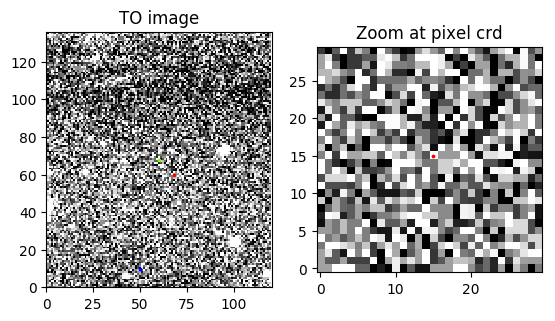

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 34.16259896  35.79992888]]
Date of observation: 2010-03-14
Pixel coordinates: [[ 59.99889006  67.98959883]]


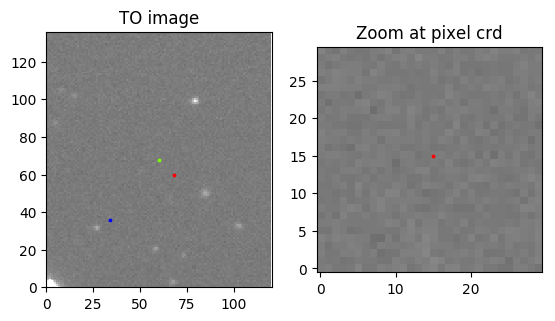

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 37.35078902   4.84214442]]
Date of observation: 2010-03-14
Pixel coordinates: [[ 59.99871123  67.98951436]]


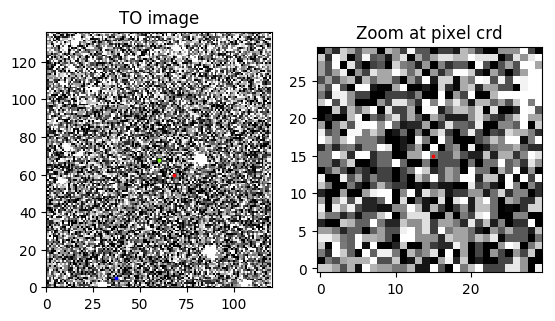

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 20.0629169   38.07184386]]
Date of observation: 2010-03-14
Pixel coordinates: [[ 59.99893648  67.98961982]]


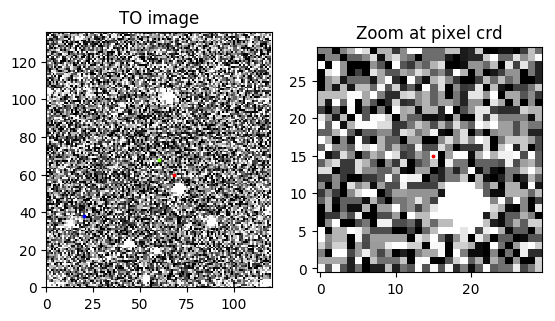

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 53.14481443  30.73825523]]
Date of observation: 2010-03-14
Pixel coordinates: [[ 60.00022927  67.99018882]]


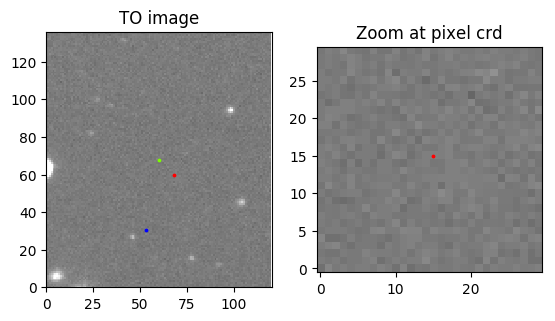

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  48.17239455  103.56729996]]
Date of observation: 2010-03-16
Pixel coordinates: [[ 60.02248861  59.98721761]]


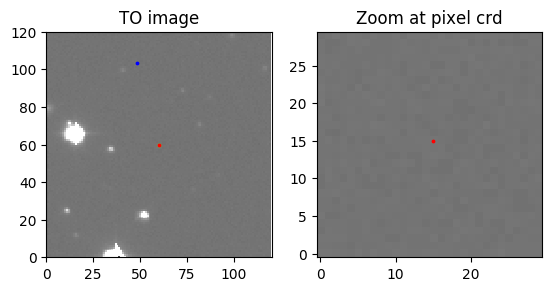

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 79.91986132  96.34312268]]
Date of observation: 2010-03-16
Pixel coordinates: [[ 60.02249366  59.98721896]]


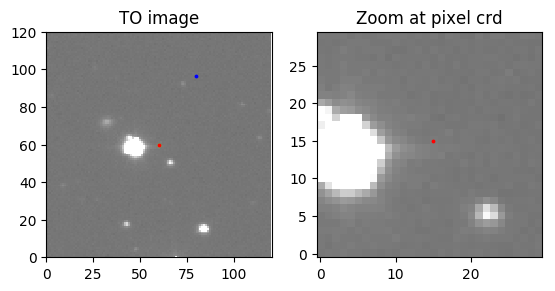

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  61.95886172  101.6520147 ]]
Date of observation: 2010-03-16
Pixel coordinates: [[ 60.01469624  59.98844032]]


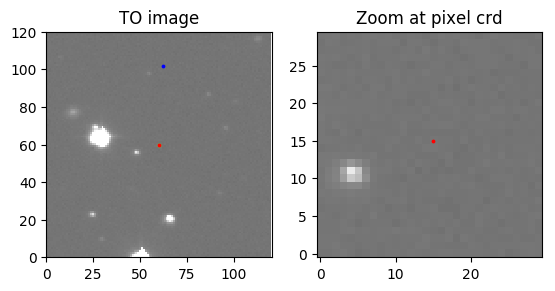

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 64.6917811   71.31359747]]
Date of observation: 2010-03-16
Pixel coordinates: [[ 60.01869824  59.98720184]]


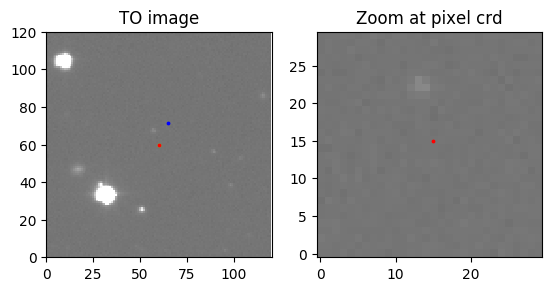

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  4.48602838  54.48106298]]
Date of observation: 2010-03-25
Pixel coordinates: [[ 60.02246066  59.9872796 ]]


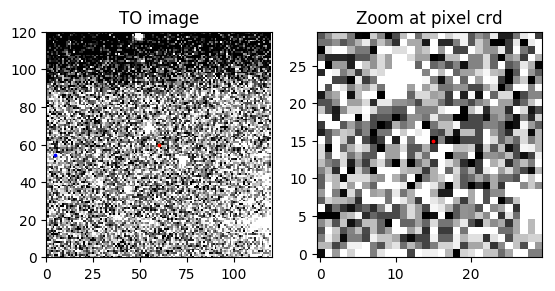

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  6.33694105  23.75463658]]
Date of observation: 2010-03-25
Pixel coordinates: [[ 60.02248247  59.98727142]]


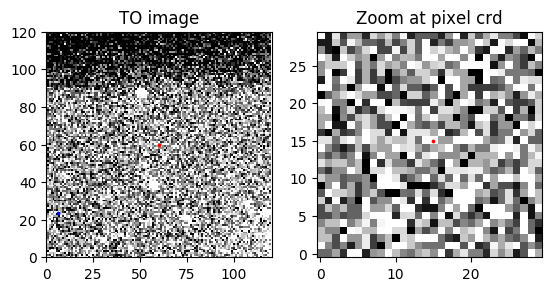

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 109.10879178   57.20566045]]
Date of observation: 2010-03-25
Pixel coordinates: [[ 60.00433142  59.9927808 ]]


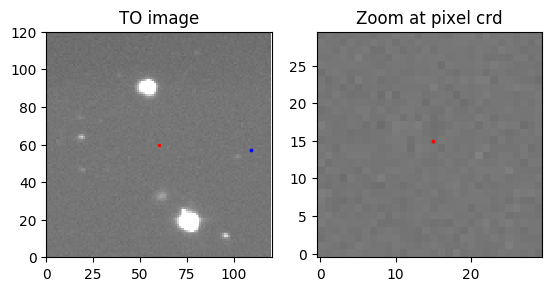

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 24.46023587  50.2836675 ]]
Date of observation: 2010-03-25
Pixel coordinates: [[ 60.02246542  59.9872845 ]]


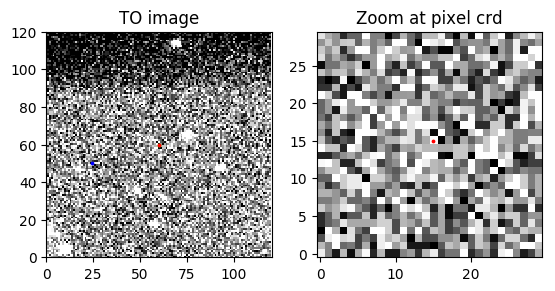

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 30.17355538  78.86187334]]
Date of observation: 2010-04-10
Pixel coordinates: [[ 60.02251271  59.98724296]]


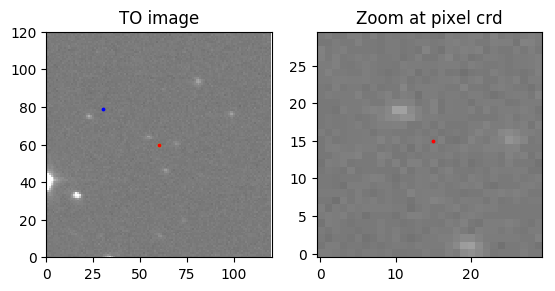

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 16.61963819  50.42965844]]
Date of observation: 2010-04-10
Pixel coordinates: [[ 60.02252939  59.98722453]]


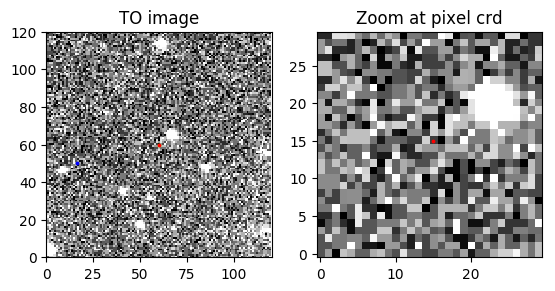

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 17.30135653  79.85507683]]
Date of observation: 2010-04-10
Pixel coordinates: [[ 60.02250757  59.98723037]]


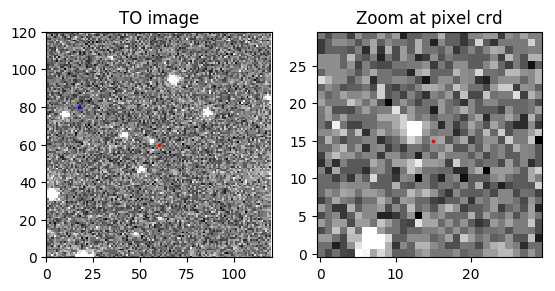

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 117.4915954    84.71620635]]
Date of observation: 2010-04-10
Pixel coordinates: [[ 60.01773884  59.987899  ]]


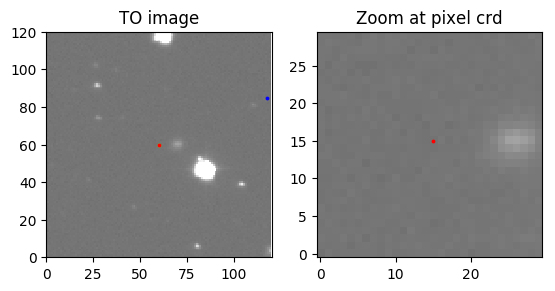

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 36.37406492  30.86223357]]
Date of observation: 2010-04-17
Pixel coordinates: [[ 60.0225428   59.98721816]]


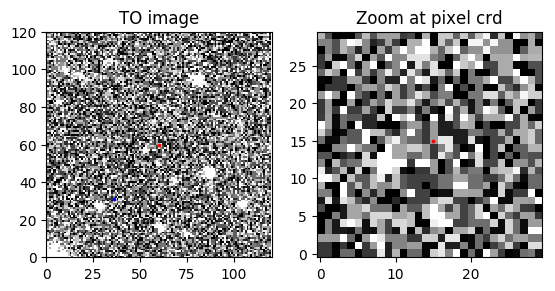

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 36.786207    61.37288845]]
Date of observation: 2010-04-17
Pixel coordinates: [[ 60.02252     59.98722368]]


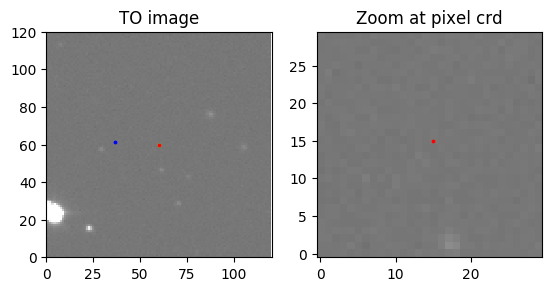

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 50.9035232   58.07179468]]
Date of observation: 2010-04-17
Pixel coordinates: [[ 60.02252651  59.98723747]]


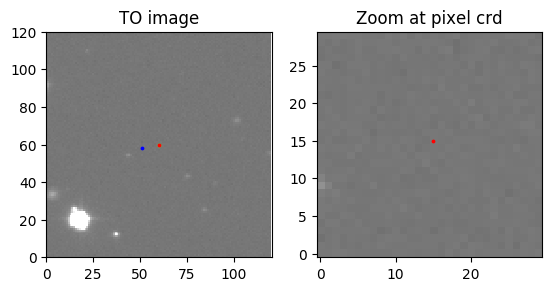

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 18.56443172  64.41309831]]
Date of observation: 2010-04-17
Pixel coordinates: [[ 60.02252084  59.98723469]]


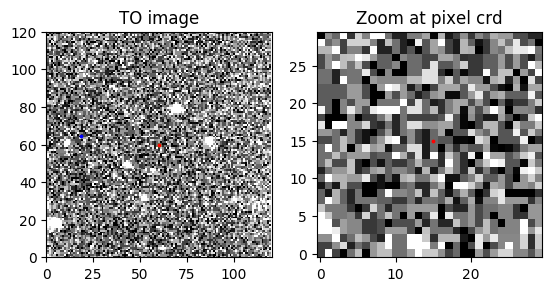

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 83.78646668  38.66898362]]
Date of observation: 2010-05-12
Pixel coordinates: [[ 60.02262247  59.987362  ]]


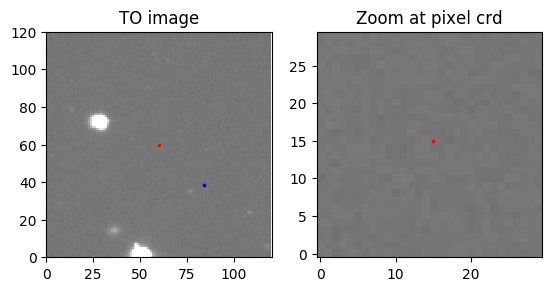

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 95.81169778  42.74439425]]
Date of observation: 2010-05-12
Pixel coordinates: [[ 60.02262475  59.9873836 ]]


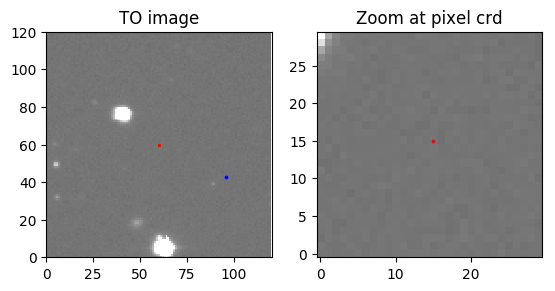

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 82.67233359  10.85560762]]
Date of observation: 2010-05-12
Pixel coordinates: [[ 60.0226426   59.98735965]]


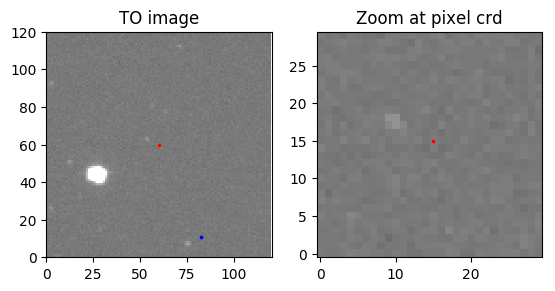

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 62.04922816  46.63908284]]
Date of observation: 2010-05-12
Pixel coordinates: [[ 60.02262038  59.98737785]]


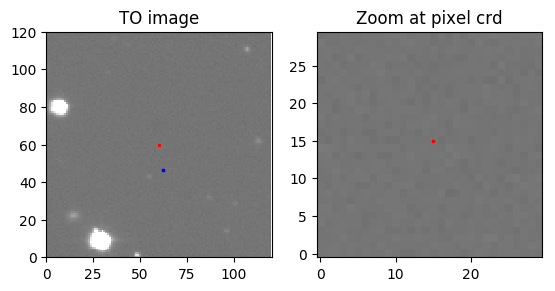

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 19.28059375   9.99638704]]
Date of observation: 2010-05-25
Pixel coordinates: [[ 60.02258161  59.98730422]]


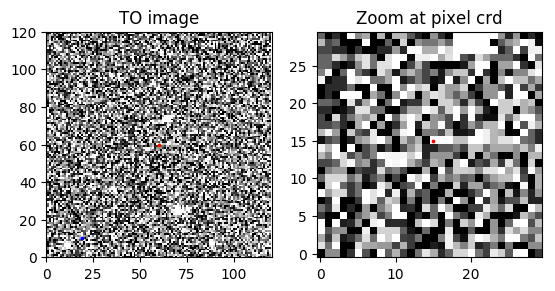

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  0.71813447  47.65567208]]
Date of observation: 2010-05-25
Pixel coordinates: [[ 60.02255682  59.98732298]]


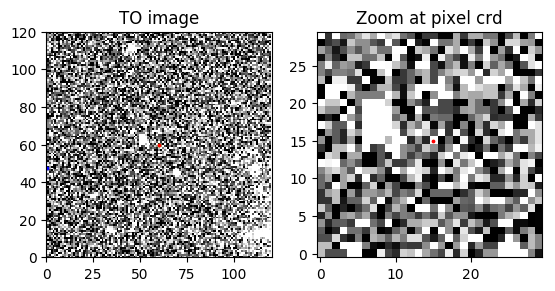

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 120.71813447   47.65567208]]
Date of observation: 2010-05-25
Pixel coordinates: [[ 60.02261329  59.9872255 ]]


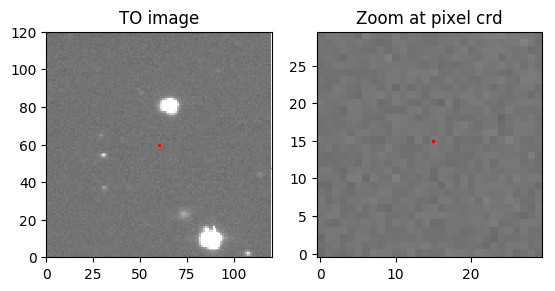

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 31.93079255  43.32666538]]
Date of observation: 2010-05-25
Pixel coordinates: [[ 60.02256232  59.98732869]]


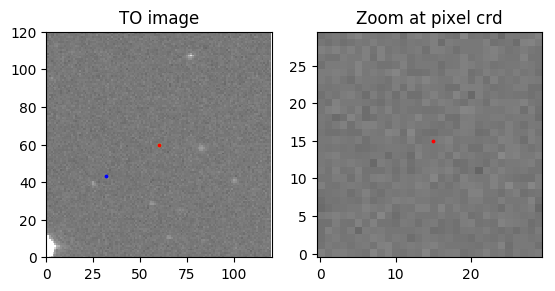

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 20.03172595  38.06979435]]
Date of observation: 2010-05-25
Pixel coordinates: [[ 60.02256032  59.98730719]]


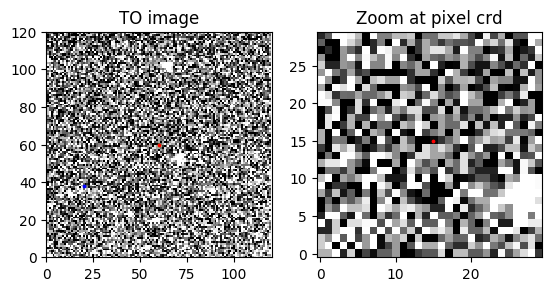

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 105.27715091   81.0898905 ]]
Date of observation: 2010-06-14
Pixel coordinates: [[ 60.02260192  59.98740477]]


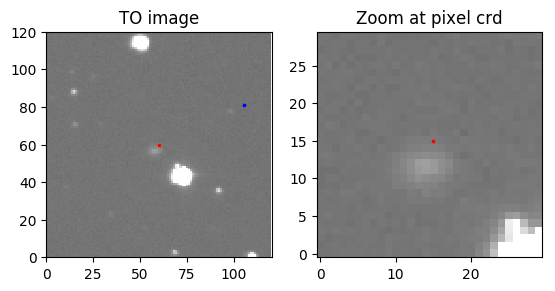

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 116.35491864   90.96949081]]
Date of observation: 2010-06-14
Pixel coordinates: [[ 60.02259793  59.98742212]]


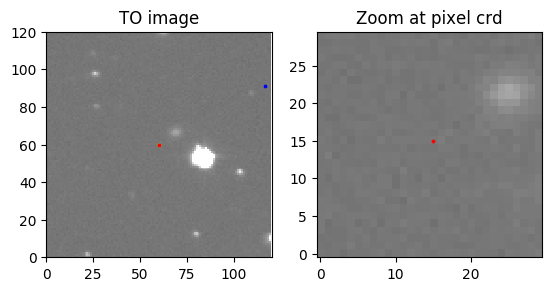

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 100.6497084    54.36893559]]
Date of observation: 2010-06-14
Pixel coordinates: [[ 60.02262167  59.98740009]]


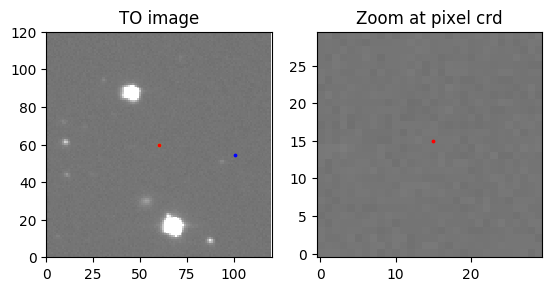

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 84.15391263  92.67289025]]
Date of observation: 2010-06-14
Pixel coordinates: [[ 60.02259645  59.9874173 ]]


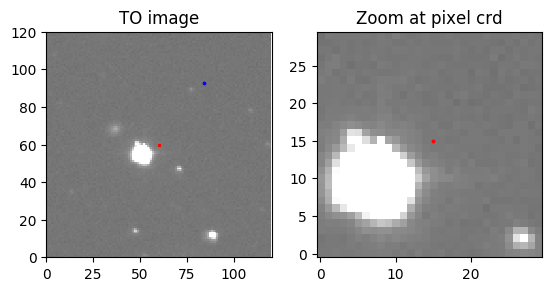

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[   4.50551967  116.74988075]]
Date of observation: 2011-01-16
Pixel coordinates: [[ 59.97495328  67.98721729]]


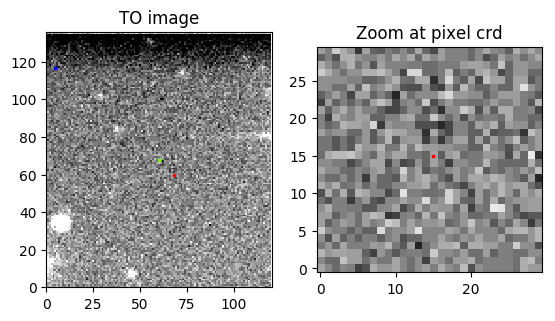

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 117.03632533   -1.4630621 ]]
Date of observation: 2011-01-16
Pixel coordinates: [[ 60.02380232  59.99059985]]


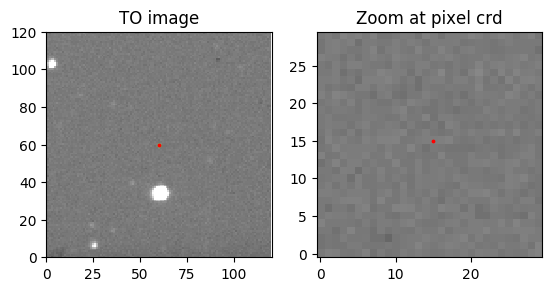

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 16.54969409  23.5497999 ]]
Date of observation: 2011-01-16
Pixel coordinates: [[ 60.02372635  59.99071297]]


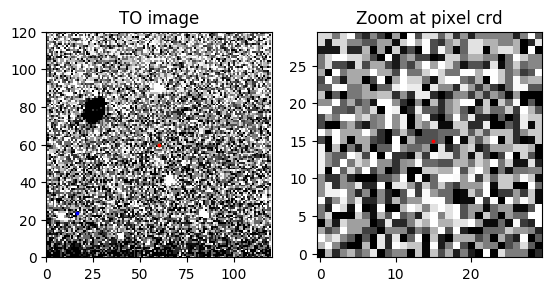

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 18.85628329  83.57351151]]
Date of observation: 2011-01-16
Pixel coordinates: [[ 59.97492726  67.98720759]]


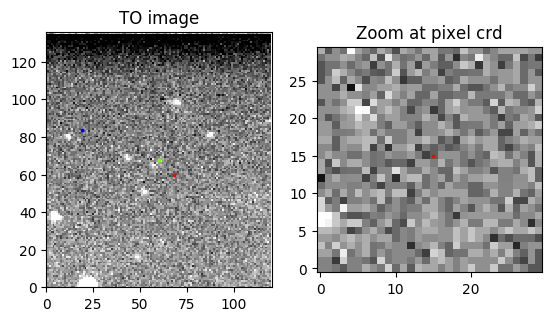

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  17.71591082  115.04956594]]
Date of observation: 2011-01-16
Pixel coordinates: [[ 59.97495094  67.987218  ]]


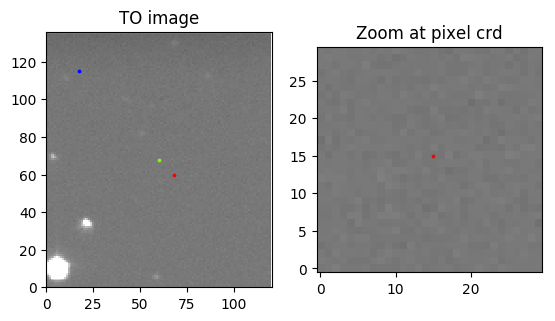

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 114.02882445   29.33556717]]
Date of observation: 2011-01-16
Pixel coordinates: [[ 60.02378048  59.99060933]]


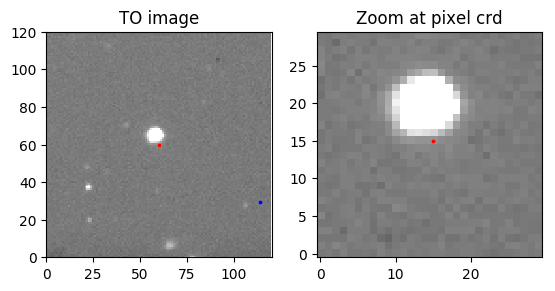

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  38.39699189  109.56315289]]
Date of observation: 2011-01-16
Pixel coordinates: [[ 59.97494732  67.98721401]]


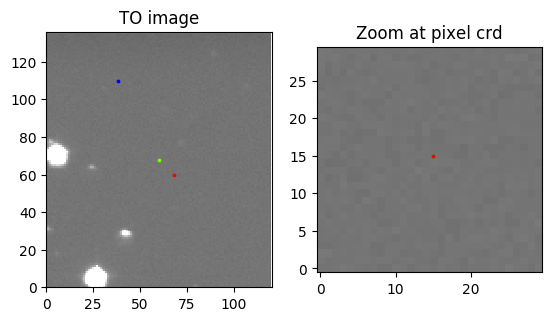

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 97.61740692  30.41399401]]
Date of observation: 2011-01-16
Pixel coordinates: [[ 60.02378022  59.99061042]]


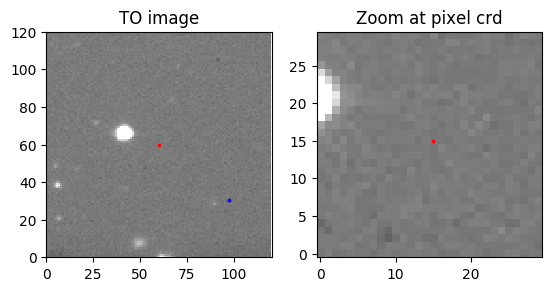

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 34.38244992  56.50025248]]
Date of observation: 2011-02-26
Pixel coordinates: [[ 60.02387071  59.98857485]]


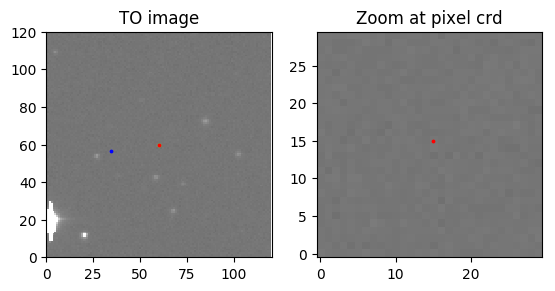

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 64.25630345  54.98605259]]
Date of observation: 2011-02-26
Pixel coordinates: [[ 60.02252482  59.98721529]]


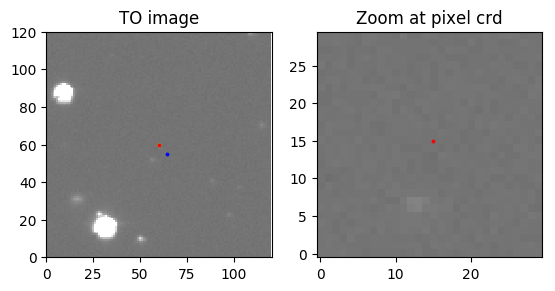

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 63.32296636  22.04370404]]
Date of observation: 2011-02-26
Pixel coordinates: [[ 60.02254925  59.98721035]]


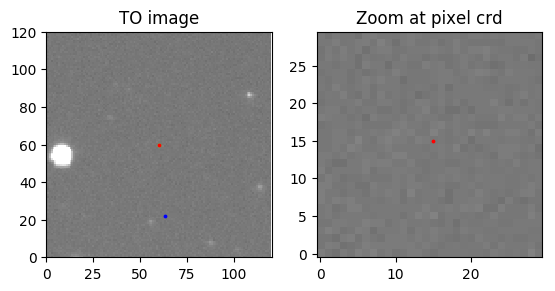

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 50.2058655   93.83274574]]
Date of observation: 2011-02-26
Pixel coordinates: [[ 60.02384667  59.98858972]]


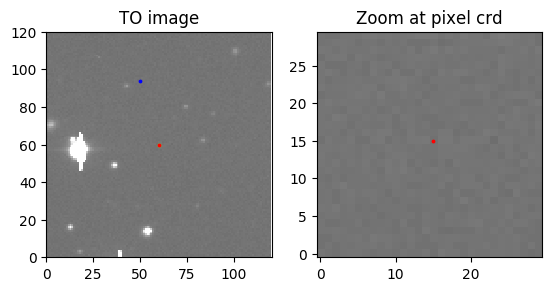

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 16.37149476  95.70424954]]
Date of observation: 2011-02-26
Pixel coordinates: [[ 60.02384529  59.98858965]]


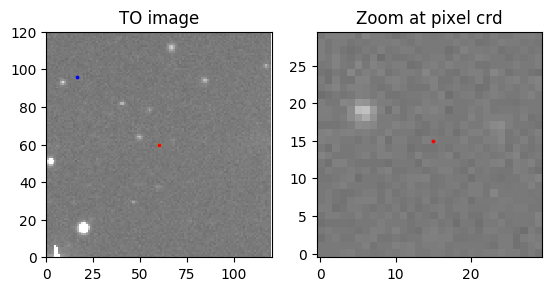

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 79.61775075  46.76428401]]
Date of observation: 2011-02-26
Pixel coordinates: [[ 60.02253516  59.98723155]]


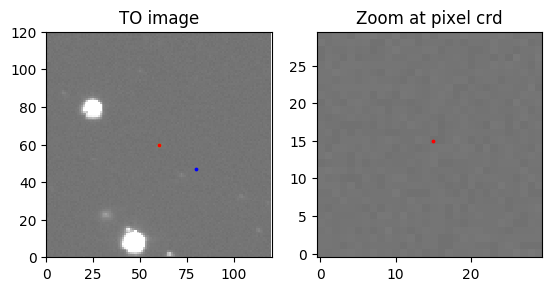

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 45.672753    54.67727906]]
Date of observation: 2011-02-26
Pixel coordinates: [[ 60.02252874  59.98722777]]


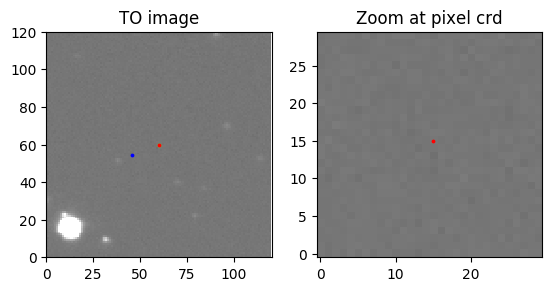

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 29.30028084  89.95145675]]
Date of observation: 2011-02-26
Pixel coordinates: [[ 60.02384854  59.98858525]]


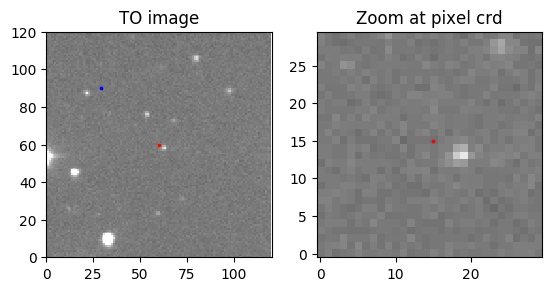

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 64.32364754  16.30312778]]
Date of observation: 2011-03-05
Pixel coordinates: [[ 59.9893666   67.98716584]]


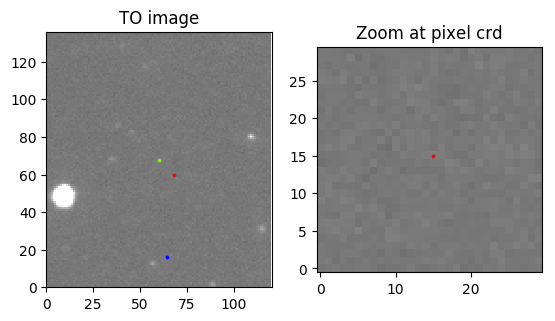

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 44.671232    13.40380113]]
Date of observation: 2011-03-05
Pixel coordinates: [[ 60.00322034  67.99150516]]


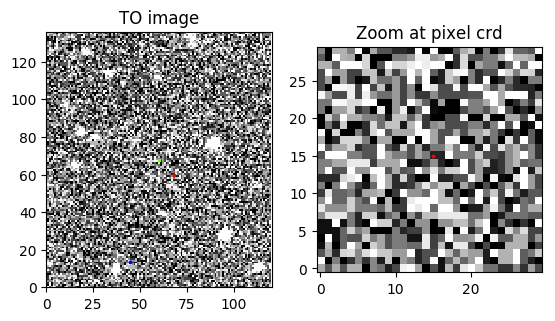

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 77.88424609   3.5757687 ]]
Date of observation: 2011-03-05
Pixel coordinates: [[ 60.01106811  67.99067726]]


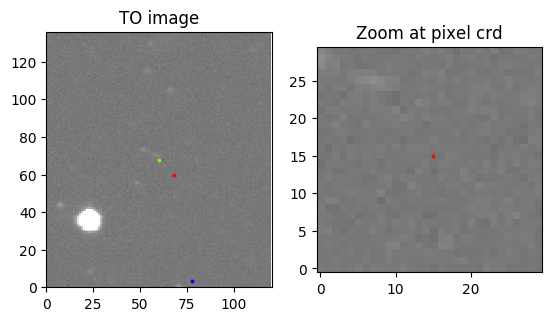

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  64.8116064  103.1962766]]
Date of observation: 2011-03-05
Pixel coordinates: [[ 59.99641011  59.98882925]]


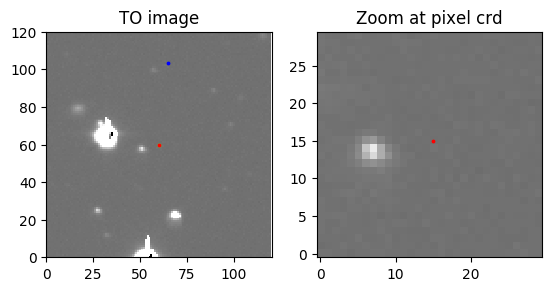

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  2.40498109  13.72908363]]
Date of observation: 2011-03-26
Pixel coordinates: [[ 60.02255939  59.98723267]]


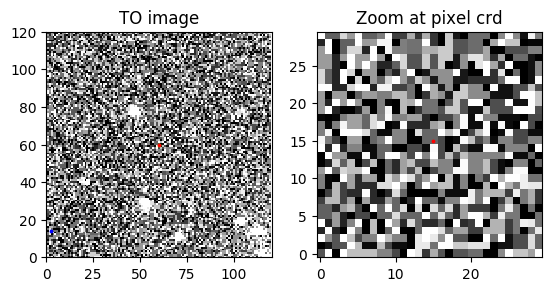

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 21.04953079  10.26906032]]
Date of observation: 2011-03-26
Pixel coordinates: [[ 60.02255906  59.98721963]]


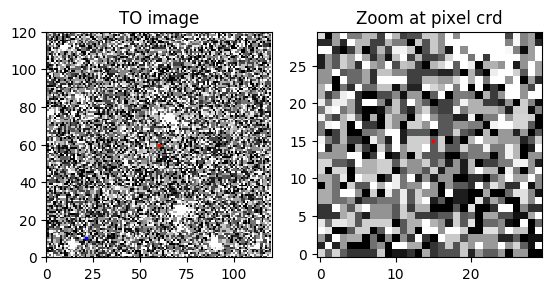

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 34.73354552   7.41282407]]
Date of observation: 2011-03-26
Pixel coordinates: [[ 60.02256551  59.98723671]]


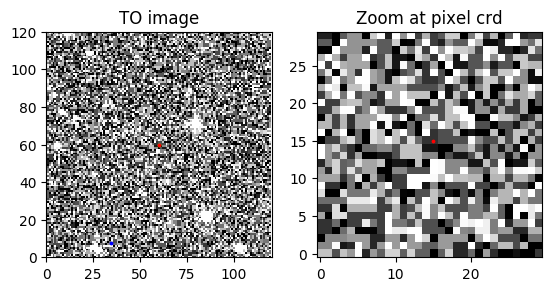

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  21.05146024  100.00072751]]
Date of observation: 2011-03-26
Pixel coordinates: [[ 60.02256388  59.98731943]]


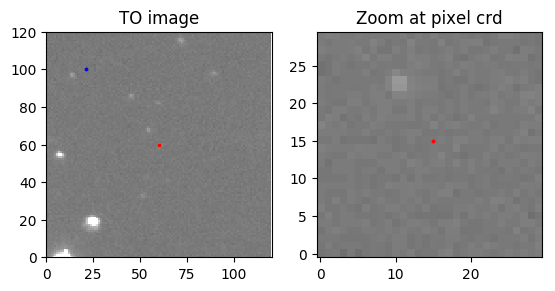

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  67.77115482  101.58554281]]
Date of observation: 2011-06-13
Pixel coordinates: [[ 60.02258479  59.98740358]]


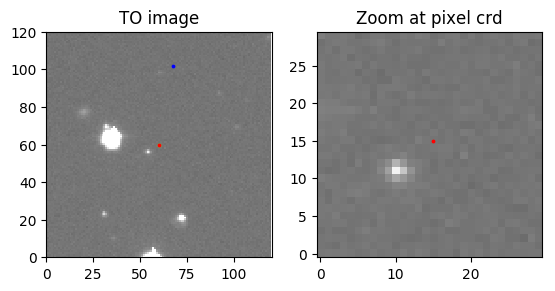

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 87.11182424  93.17745689]]
Date of observation: 2011-06-13
Pixel coordinates: [[ 60.02258722  59.98738739]]


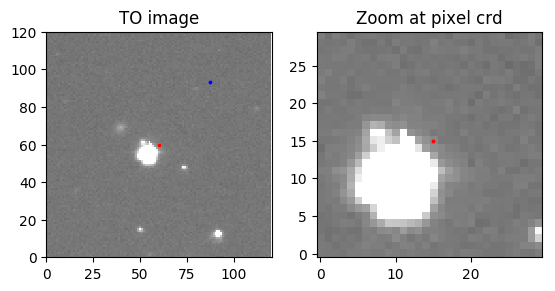

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 87.29253204  66.14146943]]
Date of observation: 2011-06-13
Pixel coordinates: [[ 60.02260769  59.98738457]]


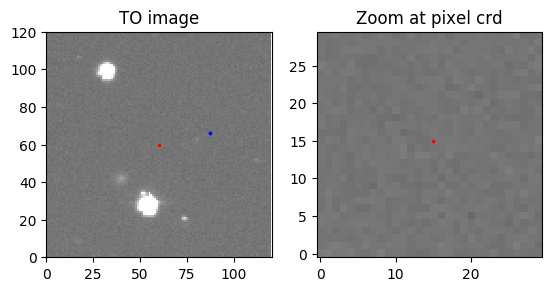

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 98.03315665  98.49165478]]
Date of observation: 2011-06-13
Pixel coordinates: [[ 60.02258917  59.98740902]]


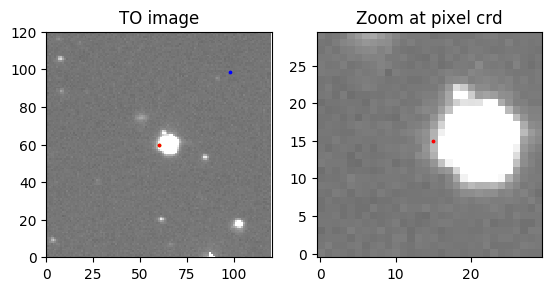

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 49.02431681  24.8316959 ]]
Date of observation: 2011-10-28
Pixel coordinates: [[ 60.0237643   59.99093376]]


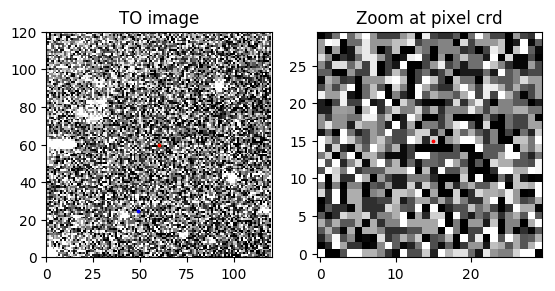

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  92.21204319  112.96229651]]
Date of observation: 2011-10-28
Pixel coordinates: [[ 60.02545661  67.98700706]]


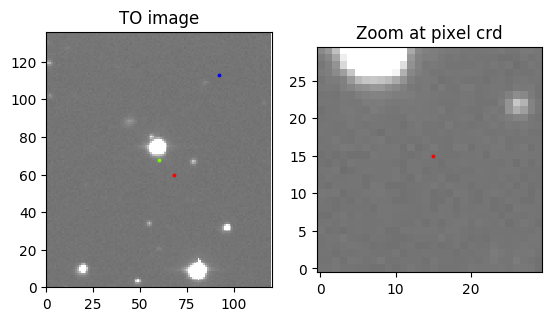

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 67.43872337  78.21287359]]
Date of observation: 2011-10-28
Pixel coordinates: [[ 60.02548605  67.98700041]]


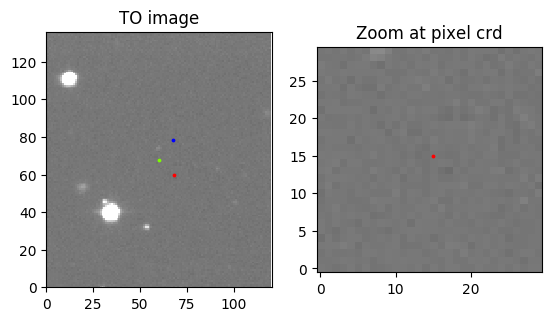

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 76.42331537  34.93561885]]
Date of observation: 2011-10-28
Pixel coordinates: [[ 60.02375544  59.99092745]]


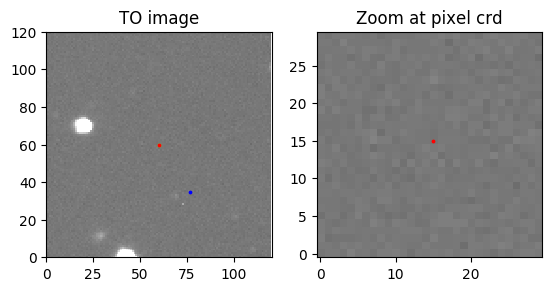

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  54.18561892  115.18053101]]
Date of observation: 2011-10-28
Pixel coordinates: [[ 60.02545698  67.98701018]]


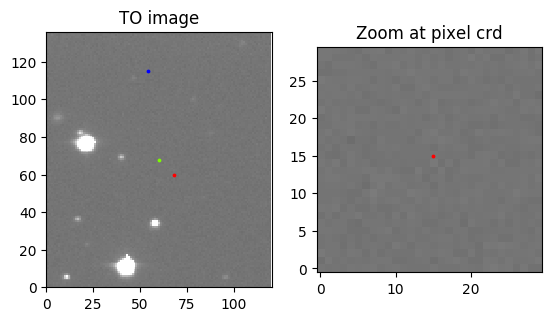

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 54.96020291   0.17411936]]
Date of observation: 2011-10-28
Pixel coordinates: [[ 60.0237808   59.99092221]]


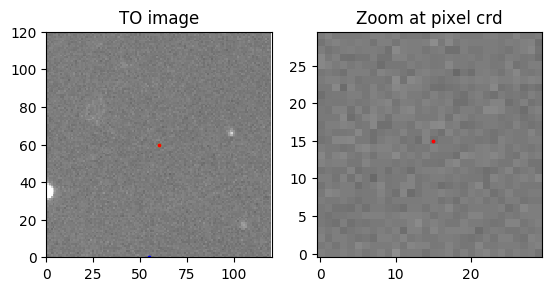

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 41.28477897  37.48696193]]
Date of observation: 2011-10-28
Pixel coordinates: [[ 60.02375407  59.9909305 ]]


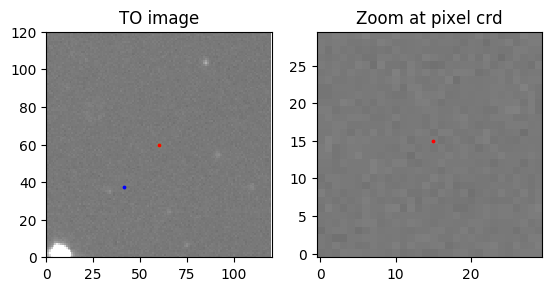

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  64.39458146  103.22903277]]
Date of observation: 2011-10-28
Pixel coordinates: [[ 60.02546842  67.98701152]]


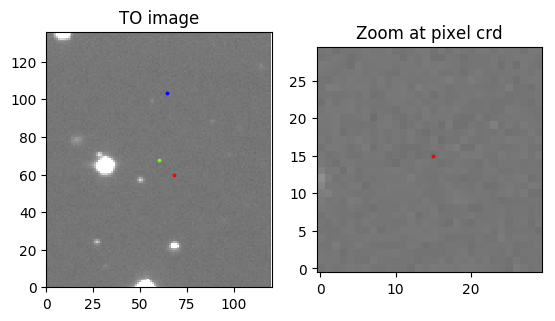

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 51.2175164   23.94335272]]
Date of observation: 2011-11-16
Pixel coordinates: [[ 60.02376072  59.99091245]]


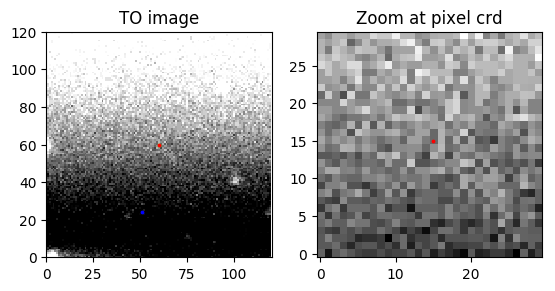

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 61.99799795  98.0091615 ]]
Date of observation: 2011-11-16
Pixel coordinates: [[ 60.0254634   67.98699025]]


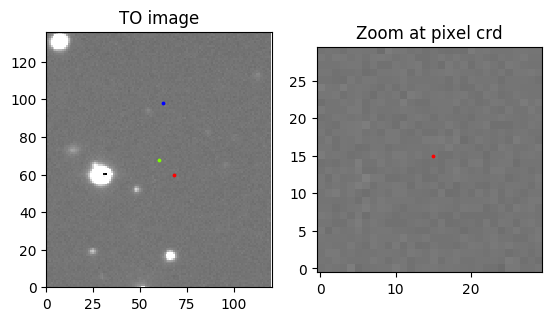

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 22.85843508  18.93270975]]
Date of observation: 2011-11-16
Pixel coordinates: [[ 60.02376567  59.99091947]]


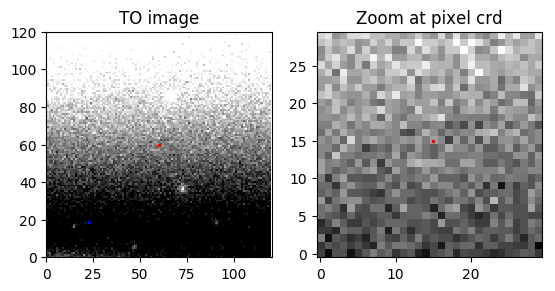

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  25.78419703  100.83199134]]
Date of observation: 2011-11-16
Pixel coordinates: [[ 60.02546142  67.98699332]]


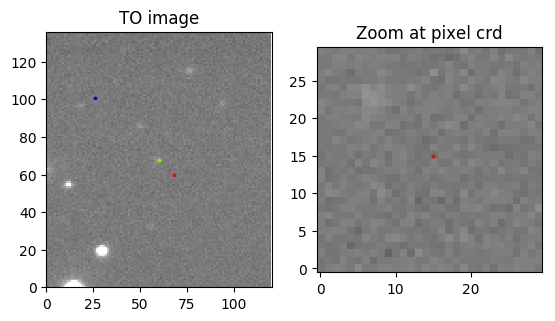

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 35.51312755  97.84040792]]
Date of observation: 2011-11-16
Pixel coordinates: [[ 60.02546638  67.98699766]]


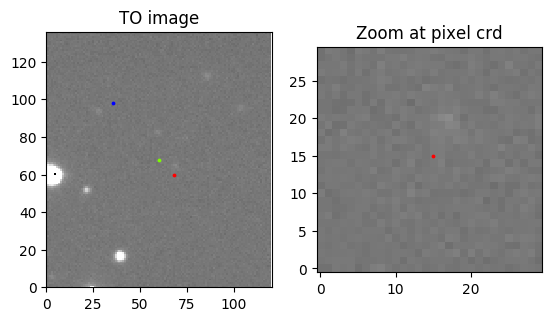

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 12.48843915  27.07326404]]
Date of observation: 2011-11-16
Pixel coordinates: [[ 60.0237591   59.99091571]]


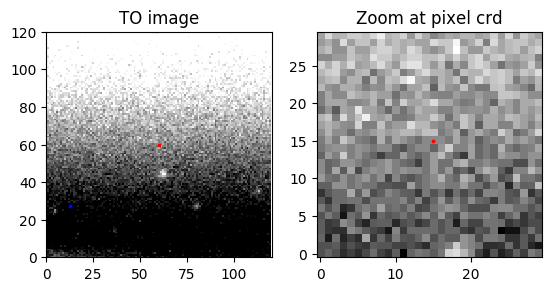

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 37.73414113  65.41327872]]
Date of observation: 2011-11-16
Pixel coordinates: [[ 60.02548978  67.98698449]]


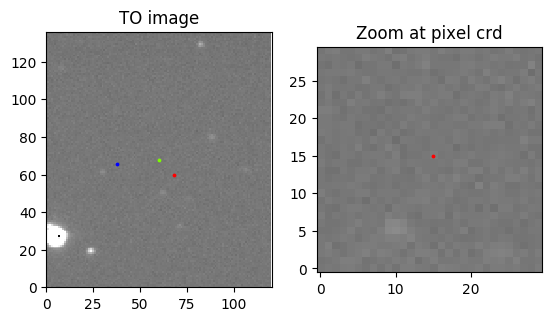

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 54.53701626  67.92881637]]
Date of observation: 2011-12-29
Pixel coordinates: [[ 60.02548246  67.98697549]]


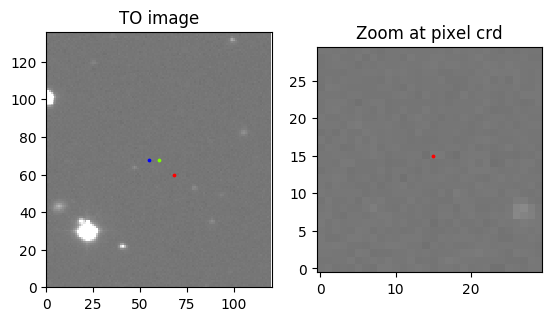

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 37.23194566  78.00523346]]
Date of observation: 2011-12-29
Pixel coordinates: [[ 60.02547374  67.98697575]]


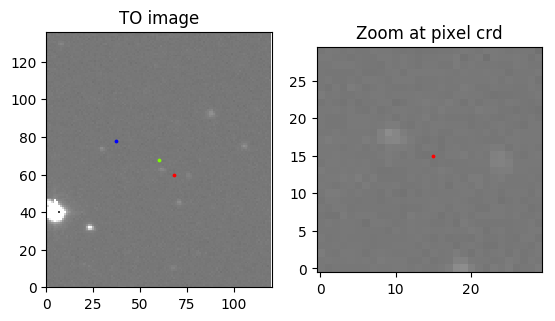

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 38.13884461  44.11546297]]
Date of observation: 2011-12-29
Pixel coordinates: [[ 60.02550051  67.98696433]]


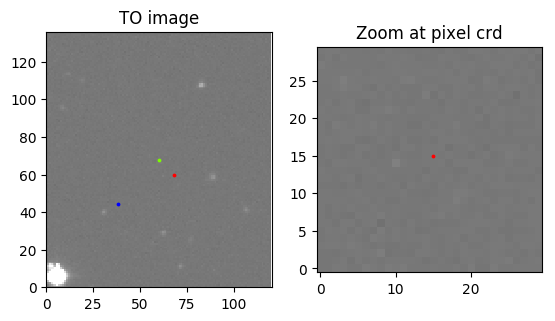

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 20.75406571  76.08887441]]
Date of observation: 2011-12-29
Pixel coordinates: [[ 60.02547532  67.98697651]]


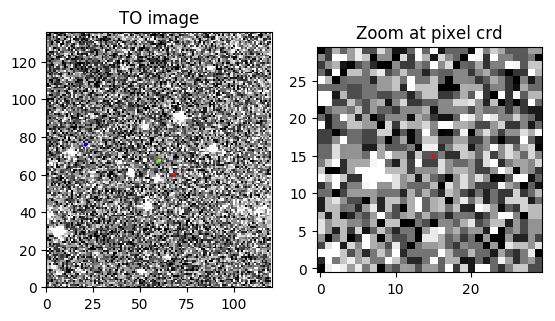

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 13.58432507   4.04377045]]
Date of observation: 2011-12-29
Pixel coordinates: [[ 60.02377306  59.9908979 ]]


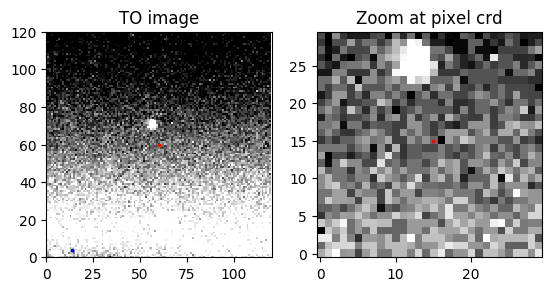

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 29.15305941   3.59821095]]
Date of observation: 2011-12-29
Pixel coordinates: [[ 60.0237732   59.99089634]]


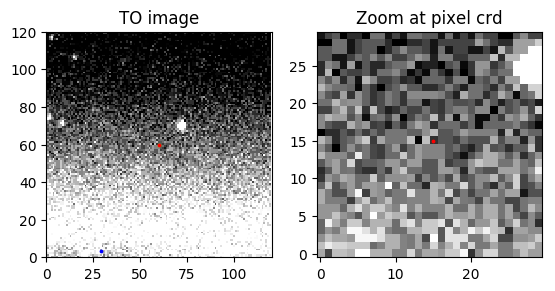

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 11.81884099  77.16846195]]
Date of observation: 2012-01-23
Pixel coordinates: [[ 60.02547447  67.986977  ]]


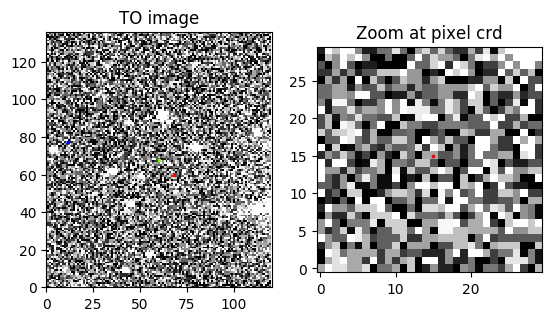

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  2.54156494  73.45095551]]
Date of observation: 2012-01-23
Pixel coordinates: [[ 60.02547506  67.9869724 ]]


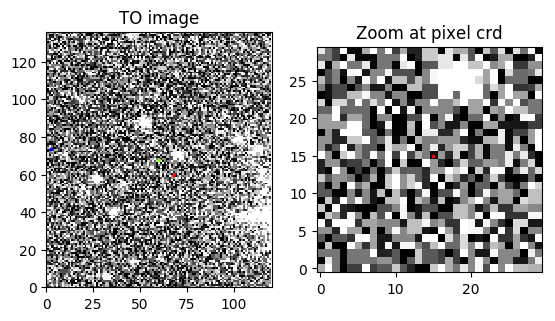

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 38.51373987  64.2165096 ]]
Date of observation: 2012-01-23
Pixel coordinates: [[ 60.02548334  67.98696932]]


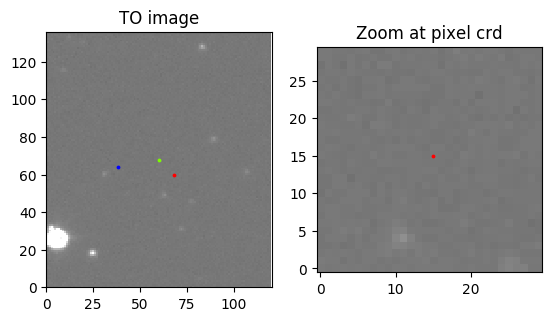

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 16.16096422  44.83909597]]
Date of observation: 2012-01-23
Pixel coordinates: [[ 60.02549798  67.98696323]]


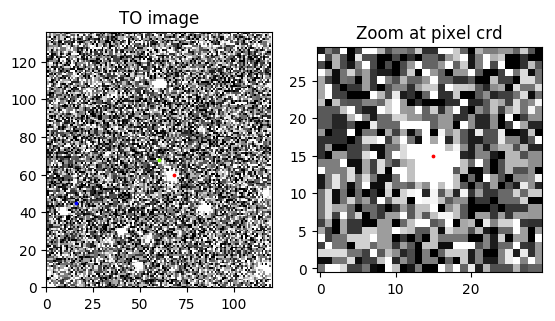

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 64.21405664  82.90906583]]
Date of observation: 2012-02-01
Pixel coordinates: [[ 60.02552029  67.98686847]]


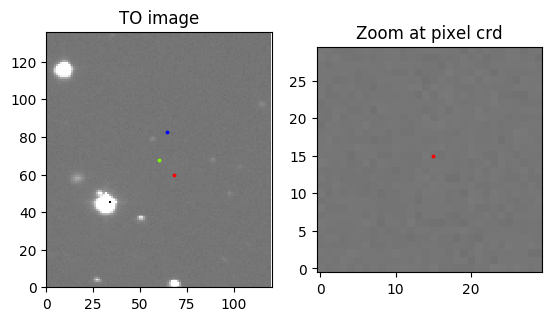

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 47.77481161  56.69793004]]
Date of observation: 2012-02-01
Pixel coordinates: [[ 60.02553956  67.98685701]]


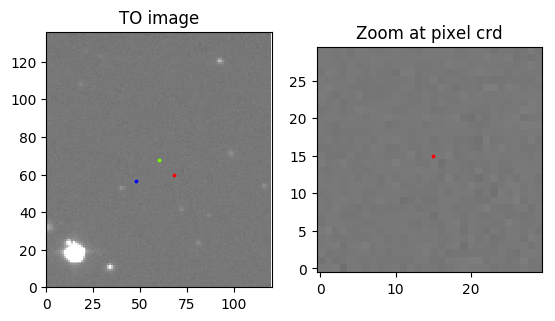

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 29.66605483  89.85953351]]
Date of observation: 2012-02-01
Pixel coordinates: [[ 60.02551348  67.98686974]]


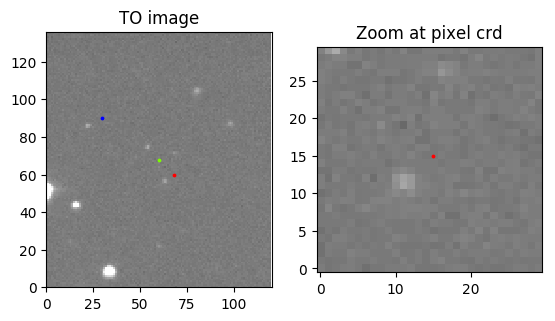

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 47.48637635  80.8505499 ]]
Date of observation: 2012-02-01
Pixel coordinates: [[ 60.02551986  67.98686504]]


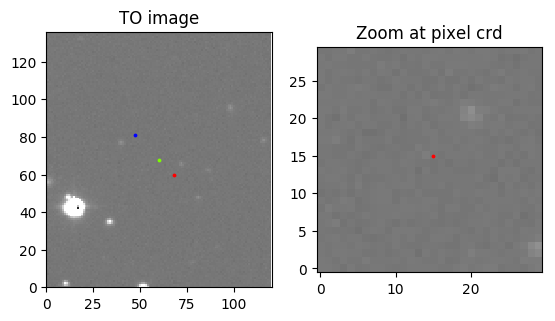

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 103.30989883    9.58792944]]
Date of observation: 2012-02-02
Pixel coordinates: [[ 60.02382944  59.99080182]]


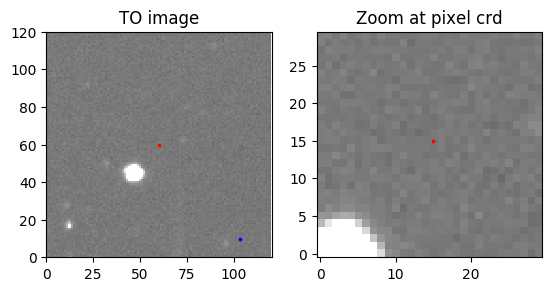

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 99.99552915  37.88361328]]
Date of observation: 2012-02-02
Pixel coordinates: [[ 60.02381084  59.99081339]]


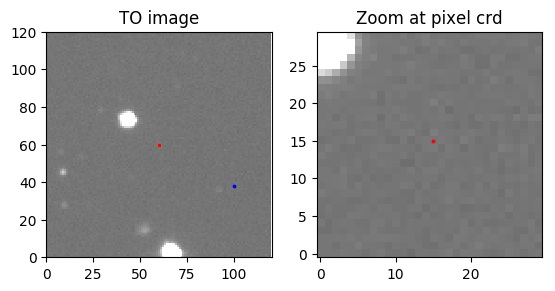

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 89.79536338  44.73431037]]
Date of observation: 2012-02-02
Pixel coordinates: [[ 60.02380342  59.99081096]]


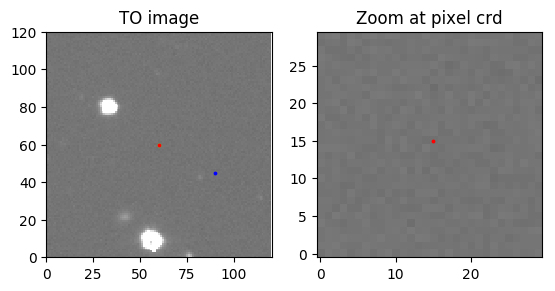

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  7.36925089  40.31568031]]
Date of observation: 2012-02-02
Pixel coordinates: [[ 60.02374681  59.99091083]]


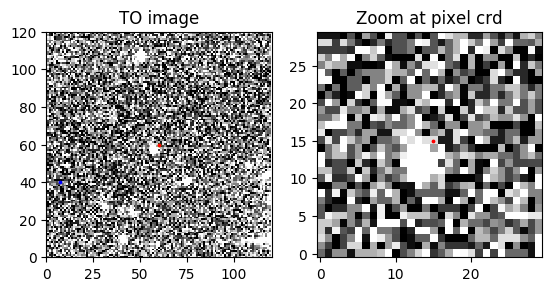

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 62.66048845   0.97505193]]
Date of observation: 2012-02-18
Pixel coordinates: [[ 60.02261536  59.9874007 ]]


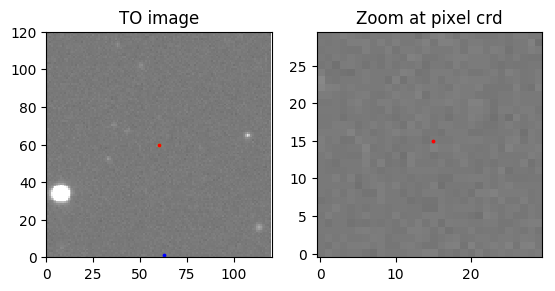

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 64.82820278  25.63746526]]
Date of observation: 2012-02-18
Pixel coordinates: [[ 60.02259728  59.98740241]]


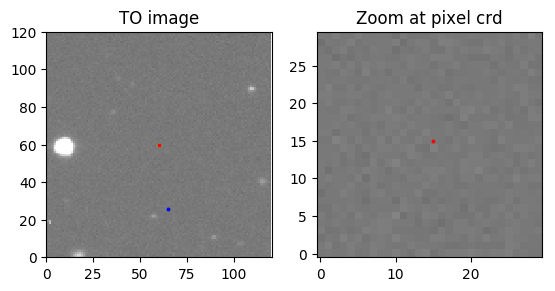

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 43.58736238  33.88636002]]
Date of observation: 2012-02-18
Pixel coordinates: [[ 60.02259507  59.98741938]]


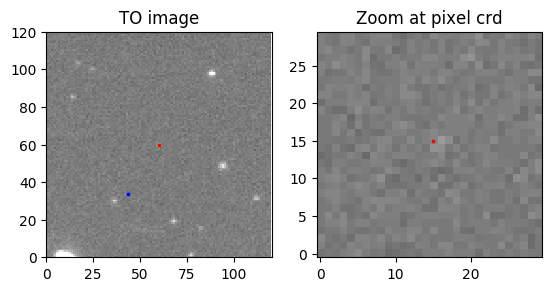

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 78.69770229  26.74412456]]
Date of observation: 2012-02-18
Pixel coordinates: [[ 60.02260251  59.98742388]]


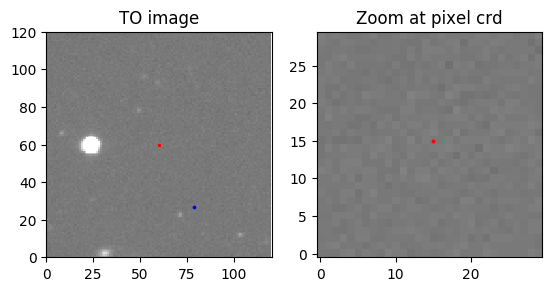

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  62.66048845  120.97505193]]
Date of observation: 2012-02-18
Pixel coordinates: [[ 60.02259815  59.98750476]]


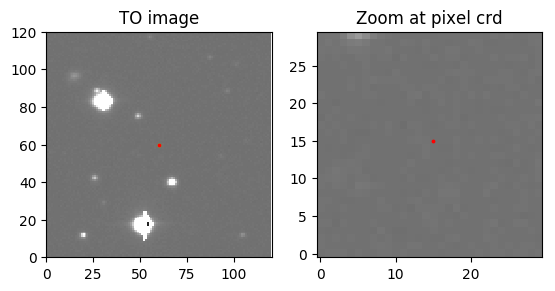

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 22.35538911   5.60354301]]
Date of observation: 2012-02-19
Pixel coordinates: [[ 60.02376933  59.99089533]]


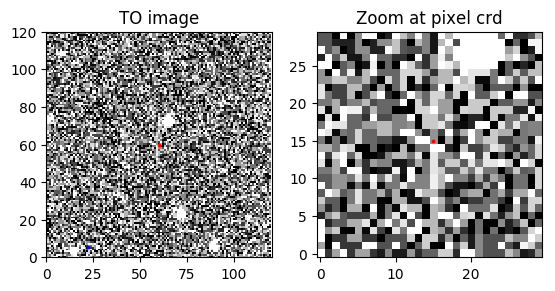

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 34.33992265   6.02731757]]
Date of observation: 2012-02-19
Pixel coordinates: [[ 60.02376988  59.99089767]]


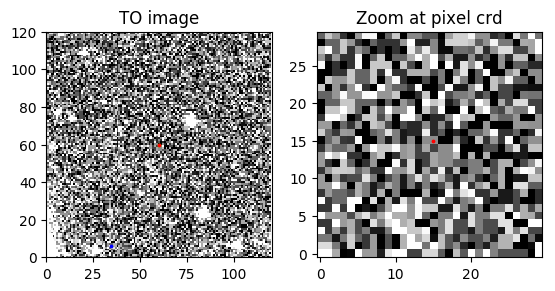

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 58.63637839  -2.85921951]]
Date of observation: 2012-02-19
Pixel coordinates: [[ 60.02377591  59.99089231]]


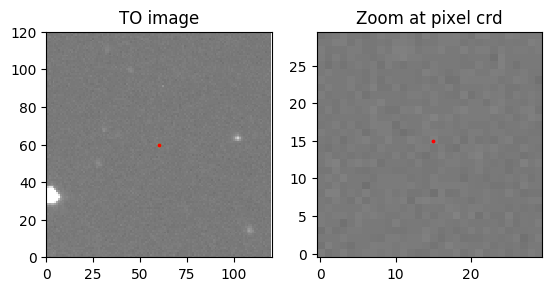

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 22.79998692  11.74572623]]
Date of observation: 2012-02-25
Pixel coordinates: [[ 60.02446742  59.98823881]]


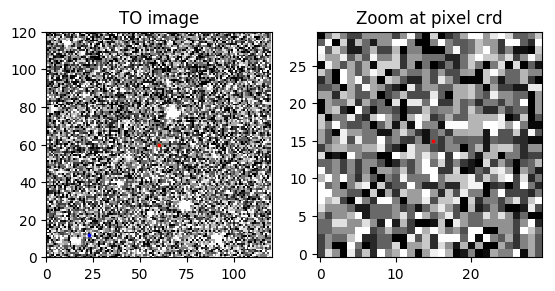

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 100.69391743   86.00526604]]
Date of observation: 2012-02-25
Pixel coordinates: [[ 60.02261075  59.98732134]]


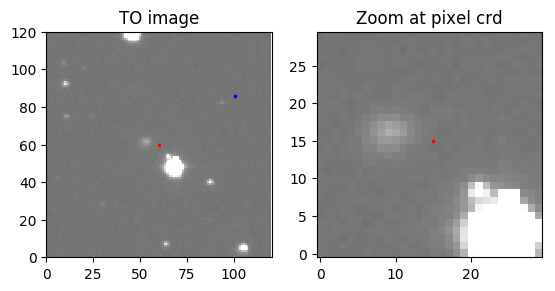

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 98.7430103   49.48866317]]
Date of observation: 2012-02-25
Pixel coordinates: [[ 60.0226369   59.98731324]]


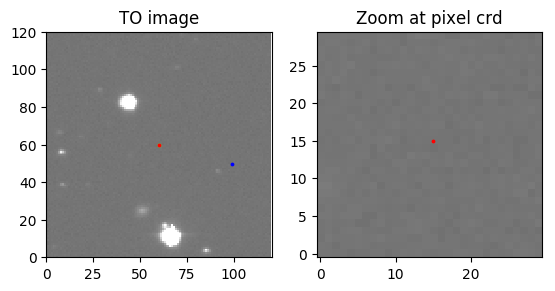

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 113.16615893   81.10581244]]
Date of observation: 2012-02-25
Pixel coordinates: [[ 60.02261695  59.98733223]]


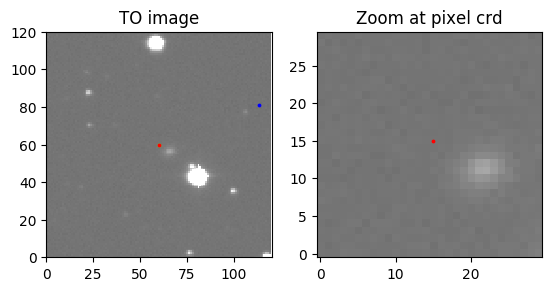

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 78.92456403  85.21844352]]
Date of observation: 2012-02-25
Pixel coordinates: [[ 60.02261309  59.98732958]]


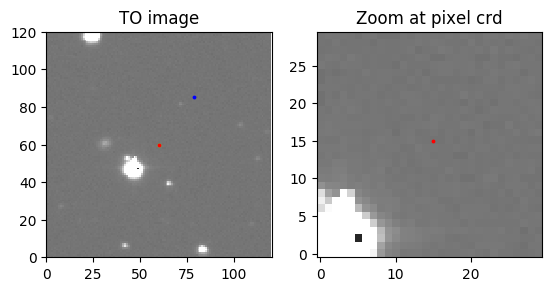

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  5.4951234   50.92081091]]
Date of observation: 2012-02-25
Pixel coordinates: [[ 60.02444254  59.98825521]]


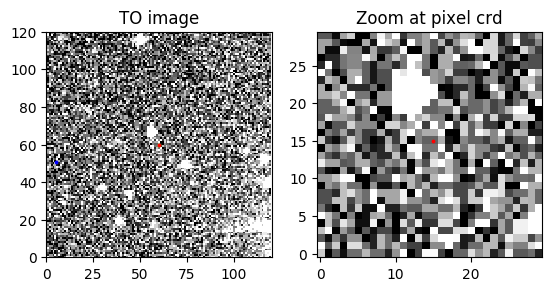

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 39.34455569  49.72899576]]
Date of observation: 2012-02-25
Pixel coordinates: [[ 60.02444376  59.98825697]]


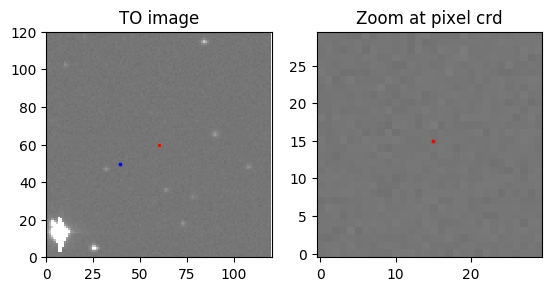

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 24.22887691  38.41710788]]
Date of observation: 2012-02-25
Pixel coordinates: [[ 60.02444921  59.98824564]]


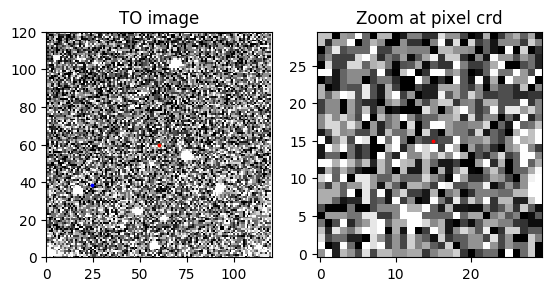

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  30.78612406  109.31462762]]
Date of observation: 2012-03-02
Pixel coordinates: [[ 60.02258611  59.98742645]]


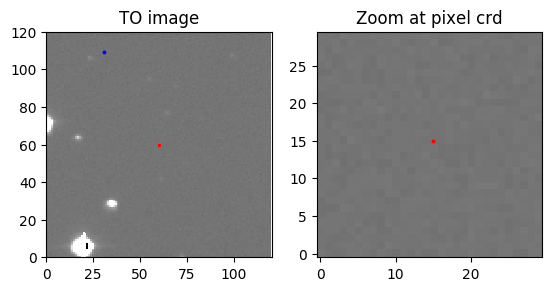

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 44.84160591  77.76180161]]
Date of observation: 2012-03-02
Pixel coordinates: [[ 60.02260622  59.98741354]]


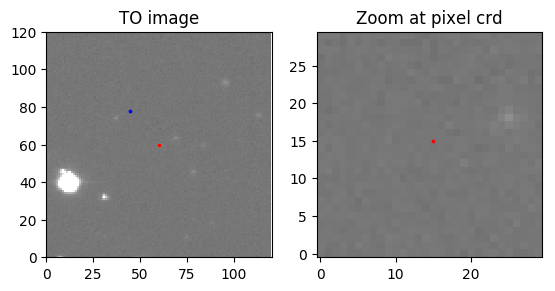

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  45.15354549  108.91343616]]
Date of observation: 2012-03-02
Pixel coordinates: [[ 60.02258533  59.98742241]]


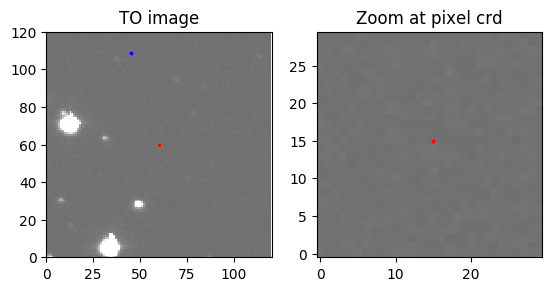

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  62.31208338  101.54883681]]
Date of observation: 2012-03-02
Pixel coordinates: [[ 60.02259267  59.9874266 ]]


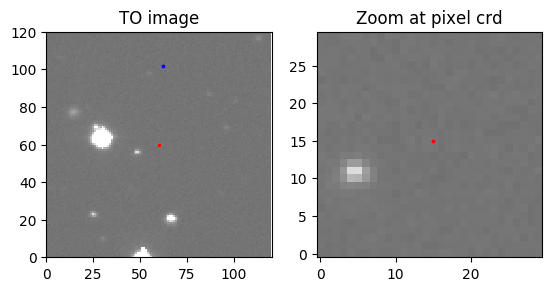

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  9.2170479   91.13930502]]
Date of observation: 2012-03-25
Pixel coordinates: [[ 60.02253408  59.98736357]]


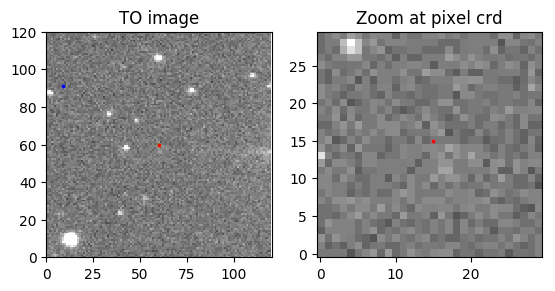

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 24.70162333  87.54012608]]
Date of observation: 2012-03-25
Pixel coordinates: [[ 60.02253602  59.98735813]]


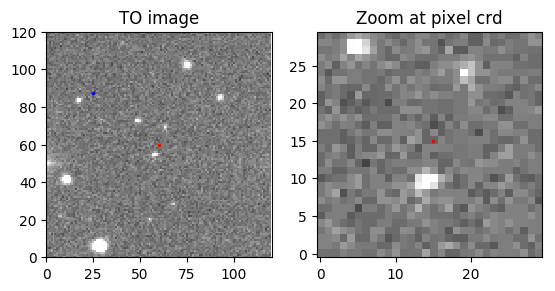

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 25.70215526  57.08819972]]
Date of observation: 2012-03-25
Pixel coordinates: [[ 60.02255779  59.98735   ]]


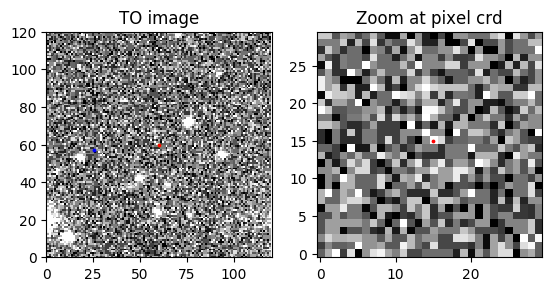

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 42.97275863  83.99768067]]
Date of observation: 2012-03-25
Pixel coordinates: [[ 60.0225398   59.98736365]]


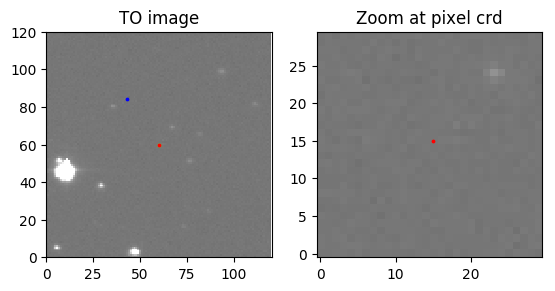

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 31.7555241   72.68095349]]
Date of observation: 2012-04-01
Pixel coordinates: [[ 60.02256398  59.98742744]]


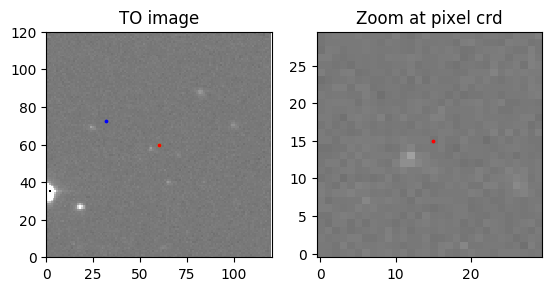

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 63.22257577  64.02181163]]
Date of observation: 2012-04-01
Pixel coordinates: [[ 60.02257189  59.98743274]]


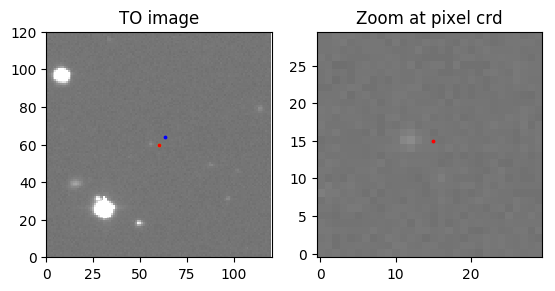

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 49.62299509  73.06293312]]
Date of observation: 2012-04-01
Pixel coordinates: [[ 60.02255937  59.98741228]]


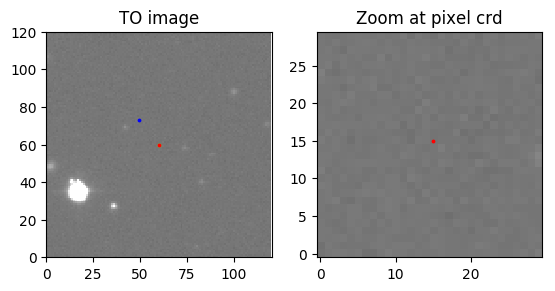

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 49.74409065  40.98489841]]
Date of observation: 2012-04-01
Pixel coordinates: [[ 60.02258407  59.98740898]]


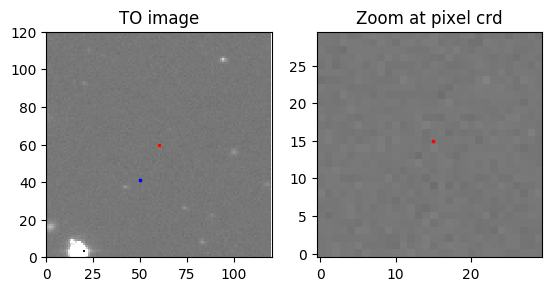

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 19.61140896  22.17283307]]
Date of observation: 2012-04-19
Pixel coordinates: [[ 60.02551889  67.98697818]]


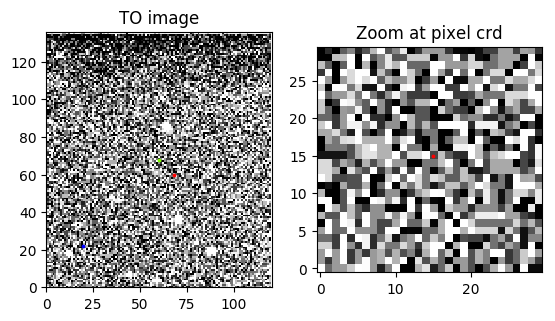

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 121.45114068   23.81554413]]
Date of observation: 2012-04-19
Pixel coordinates: [[ 60.02557216  67.9868762 ]]


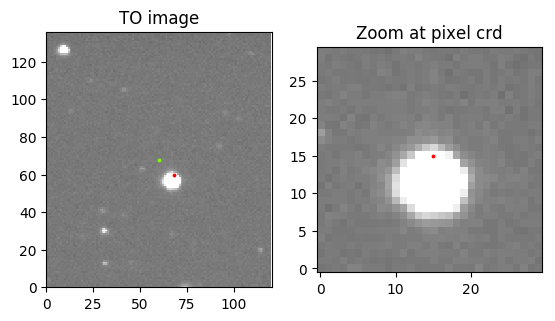

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  20.85612375  107.17155883]]
Date of observation: 2012-04-19
Pixel coordinates: [[ 60.02252651  59.98737997]]


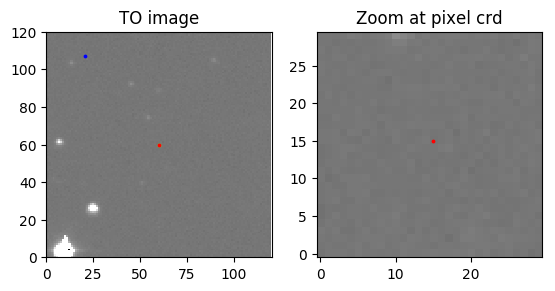

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 34.01159601   3.94846374]]
Date of observation: 2012-04-19
Pixel coordinates: [[ 60.02553963  67.98699198]]


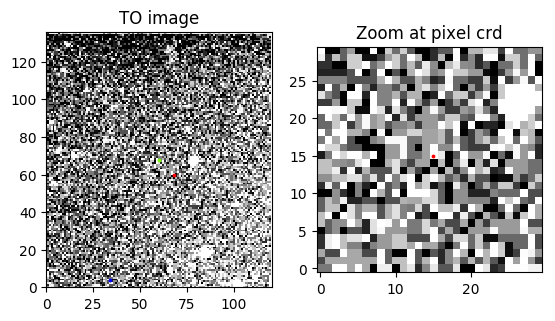

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  1.45114068  23.81554413]]
Date of observation: 2012-04-19
Pixel coordinates: [[ 60.02552021  67.98698651]]


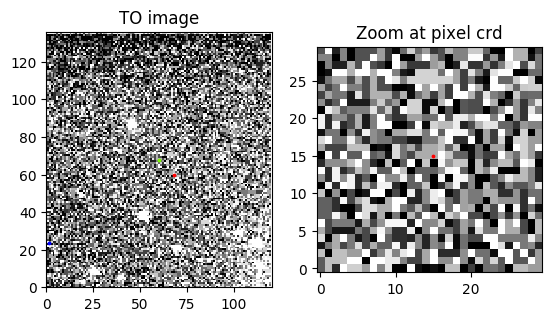

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 119.48320271   48.21459592]]
Date of observation: 2012-05-16
Pixel coordinates: [[ 60.02264584  59.98735864]]


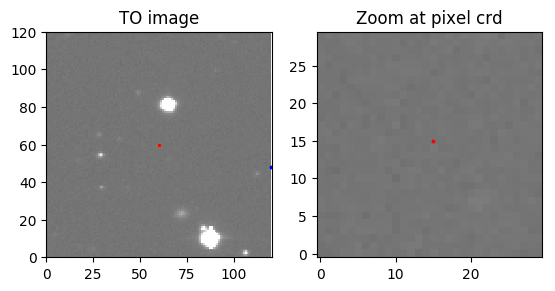

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 17.71593664  43.39922663]]
Date of observation: 2012-05-16
Pixel coordinates: [[ 60.02258953  59.98744012]]


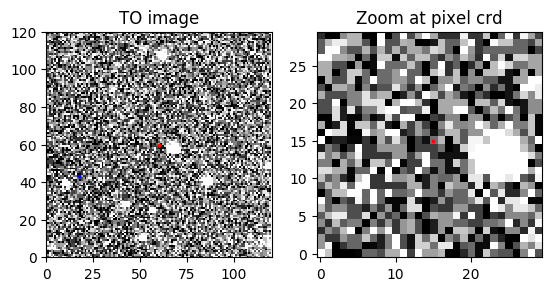

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 31.31996656  43.33360803]]
Date of observation: 2012-05-16
Pixel coordinates: [[ 60.02259473  59.98746196]]


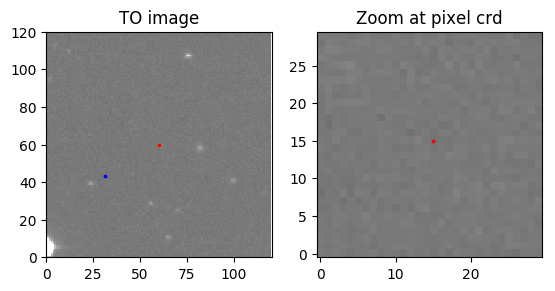

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 17.30972866  13.18224432]]
Date of observation: 2012-05-16
Pixel coordinates: [[ 60.02261113  59.98743724]]


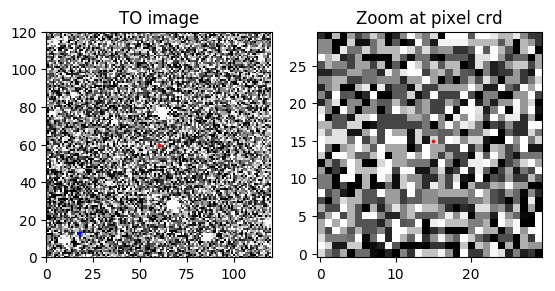

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ -0.51679729  48.21459592]]
Date of observation: 2012-05-16
Pixel coordinates: [[ 60.02258926  59.98745616]]


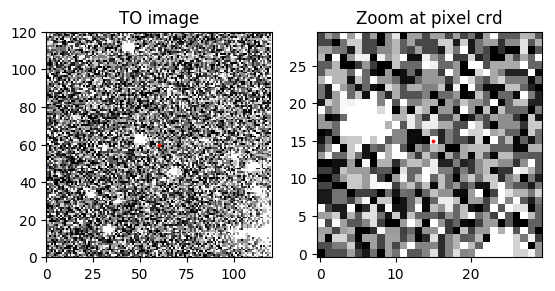

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 29.25718993  88.60636032]]
Date of observation: 2012-05-22
Pixel coordinates: [[ 60.02267225  59.98739641]]


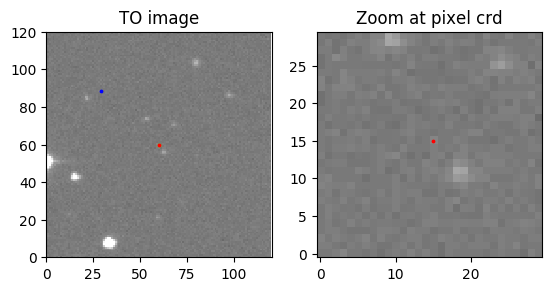

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[  8.3696839   91.95296562]]
Date of observation: 2012-05-22
Pixel coordinates: [[ 60.02267377  59.98741126]]


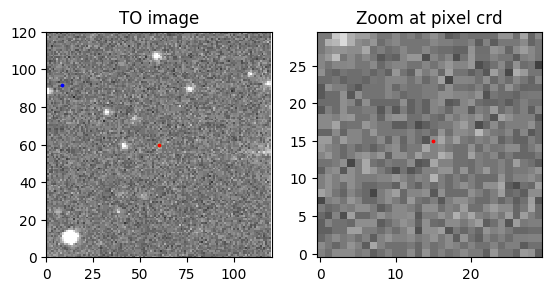

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 28.66456932  58.735527  ]]
Date of observation: 2012-05-22
Pixel coordinates: [[ 60.02269473  59.98739294]]


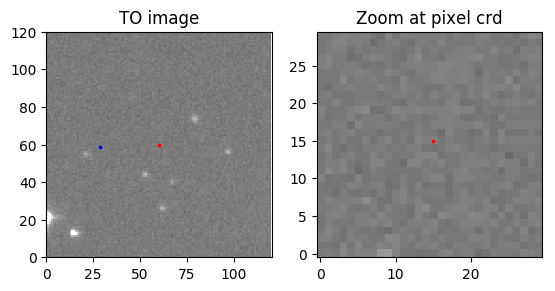

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 43.12175585  86.31387481]]
Date of observation: 2012-05-22
Pixel coordinates: [[ 60.02267958  59.98741605]]


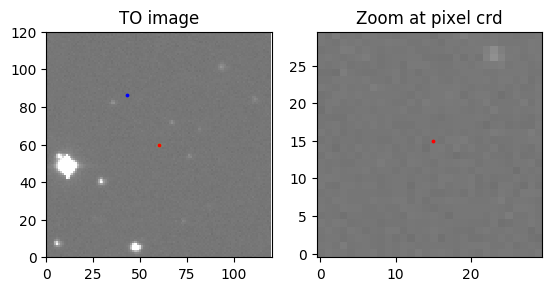

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 18.3531751   41.01664827]]
Date of observation: 2012-06-18
Pixel coordinates: [[ 60.02260619  59.98750022]]


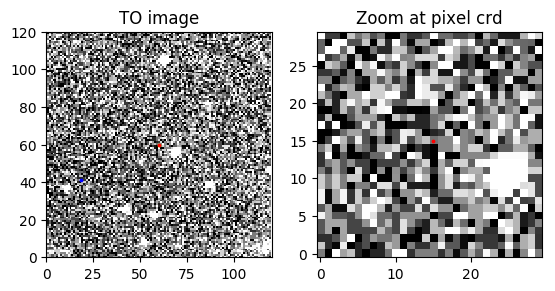

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 38.12431722   4.81674764]]
Date of observation: 2012-06-18
Pixel coordinates: [[ 60.02262873  59.98747968]]


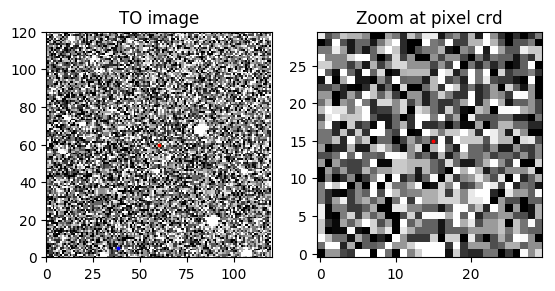

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 40.60088962  34.42431572]]
Date of observation: 2012-06-18
Pixel coordinates: [[ 60.02260697  59.9874816 ]]


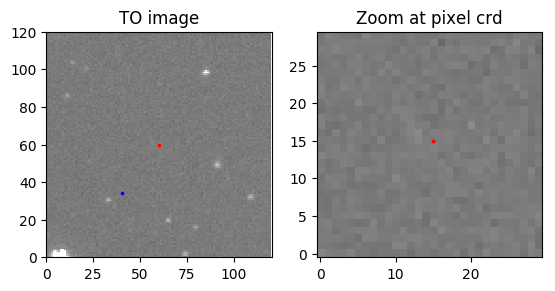

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 51.6948016   36.86277768]]
Date of observation: 2012-06-18
Pixel coordinates: [[ 60.02261224  59.987507  ]]


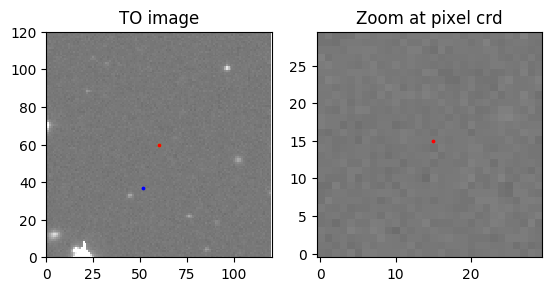

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 105.91471109   95.30818244]]
Date of observation: 2012-12-03
Pixel coordinates: [[ 60.02250337  59.98724099]]


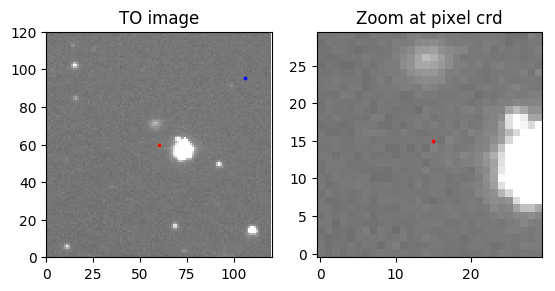

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 100.13160836   78.95984196]]
Date of observation: 2012-12-03
Pixel coordinates: [[ 60.02251592  59.98724051]]


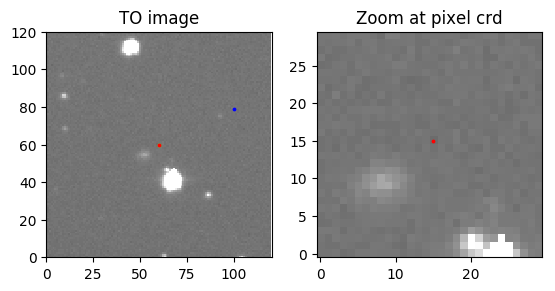

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 96.96741883  54.82495715]]
Date of observation: 2012-12-03
Pixel coordinates: [[ 60.02253172  59.98723013]]


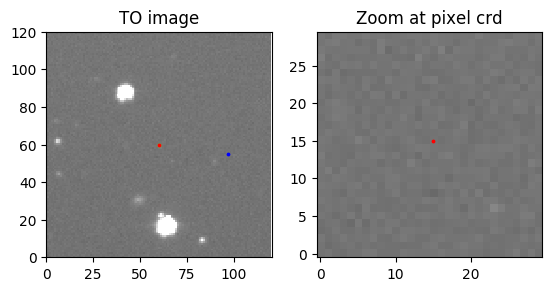

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 74.97442583  95.1578785 ]]
Date of observation: 2012-12-03
Pixel coordinates: [[ 60.02250386  59.98724229]]


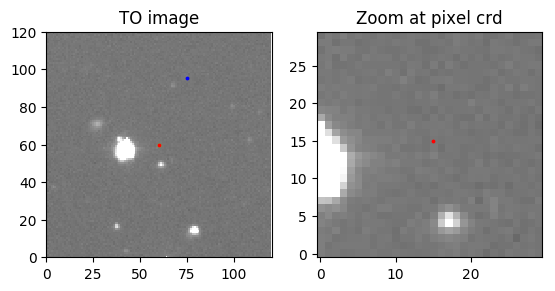

In [10]:
#Extract the name of the .fits file from the DF
#read pkl file if it is already saved
"""
out_dir = '/home/oem/Documentos/Astronomy/CRTS/Data/'
object_class = 'AGN'
file_name = 'second_object.zip'
#file_name = 'second_object_SSS'
complete_path = out_dir + object_class + '/'
path_to_file = complete_path + file_name[0:-4] + '/'
#path_to_file = complete_path + file_name + '/'
#df_per_object = pd.read_pickle(complete_path + 'first_object.pkl')
df_per_object = pd.read_pickle(path_to_file + 'second_object.pkl')
#df_per_object = df_per_object.sort_values('OBS-DATE')
"""
out_dir = '/home/oem/Documentos/Astronomy/CRTS/Data/'
file_name = 'second_object'
object_class = 'CV'
complete_path = out_dir + object_class + '/'
path_to_file = complete_path + file_name + '/'
#ind_crds = '51.08006 15.31620'
ind_crds = '172.51287 28.11336'
list_ind_crds = ind_crds.split()
ra_obj = float(list_ind_crds[0])
dec_obj = float(list_ind_crds[1])
df_per_object = df_object
fig = plt.figure()
for index, row in df_per_object.iterrows():
    file_name_from_df = row['FILENAME']
    ra_crd_from_df = float(row['CENTER_RA'])
    dec_crd_from_df = float(row['CENTER_DEC'])
    obs_date_from_df = row['OBS-DATE']
    hdu_list = fits.open(path_to_file + file_name_from_df)
    image_data = hdu_list[0].data
    #scale image
    #image_data = image_data - np.min(image_data)
    #scaled_image_data = image_data * (255/np.max(image_data))
    #scaled_image_data = scaled_image_data.astype(int)
    inf_value = np.mean(image_data)- np.std(image_data)
    sup_value = np.mean(image_data)+ np.std(image_data)
    #world2pix
    w = wcs.WCS(hdu_list[0].header)
    ra_dec_crd = w.wcs.crval
    worldcrd_obj = np.array([[ra_obj, dec_obj]]) 
    print('World crds OBJ:', worldcrd_obj)
    pixcrd_obj = w.wcs_world2pix(worldcrd_obj, 1)
    print('Pixel coordinates OBJ:',pixcrd_obj)
    x_obj = pixcrd_obj[0,0]
    y_obj = pixcrd_obj[0,1]
    #worldcrd = np.array([[ra_dec_crd[0], ra_dec_crd[1]]]) #crds from metadata
    worldcrd = np.array([[ra_crd_from_df, dec_crd_from_df]]) 
    pixcrd = w.wcs_world2pix(worldcrd, 1)
    rows = pixcrd[0,0] #y
    cols = pixcrd[0,1] #x
    
    print('Date of observation:', obs_date_from_df)
    print('Pixel coordinates:',pixcrd)
    #plot the image and ra/dec crds
    #fig = plt.figure()
    f, (ax1, ax2) = plt.subplots(1, 2,)#,  gridspec_kw = {'width_ratios':[3, 1]})
    ax1.imshow(image_data, cmap='gray',origin='lower', vmin=inf_value, vmax = sup_value)
    ax1.scatter(x_obj, y_obj, color = 'b', s=3)
    ax1.scatter(rows, cols, color='r',s=3)
    #ax1.scatter(cols, rows, color='r',s=3)
    
    ymin =0
    xmin = 0
    ymax_o, xmax_o = np.shape(image_data)
    ax1.set_ylim([ymin,ymax_o])
    ax1.set_xlim([xmin,xmax_o])
    ax1.set_title('TO image')
    #extract a vicinity around the pixelcrd
    ww = 15
    image_sub_sampled = image_data[int(cols)-ww:int(cols)+ww, int(rows)-ww:int(rows)+ww]
    ax2.imshow(image_sub_sampled, cmap='gray',origin='lower', vmin=inf_value, vmax = sup_value)#, norm=LogNorm())
    ymin =0
    xmin = 0
    ymax, xmax = np.shape(image_sub_sampled)
    ax2.scatter(int(ymax/2), int(xmax/2) ,color='r',s=3)
    #ax2.set_ylim([ymin,ymax])
    #ax2.set_xlim([xmin,xmax])
    ax2.set_title('Zoom at pixel crd')
    plt.show()
    #f.savefig(path_to_file + 'png/' + file_name_from_df[0:-5] +'.png') 
    plt.close(f) 
    #print(file_name_from_df)

In [12]:
df_per_object.head()

,CENTER_DEC,CENTER_RA,FILENAME,OBS-DATE
200,28.0905238448,172.488574726,01_04JAN28_N26056_0002_cutout_1432.fits,2004-01-28
254,28.0898437349,172.4768561,01_04JAN28_N26056_0001_cutout_1432.fits,2004-01-28
255,28.0915848808,172.472826708,01_04JAN28_N26056_0003_cutout_1432.fits,2004-01-28
195,28.0914157221,172.483046064,01_04JAN28_N26056_0004_cutout_1432.fits,2004-01-28
242,28.1033680154,172.490714567,01_04FEB13_N26056_0004_cutout_1432.fits,2004-02-13


In [12]:
#individual search 
#ind_crds = '48.26734 -8.39214'
#ind_crds = '51.08006 15.31620'
#ind_crds = '172.51287 28.11336'
ra_crd = '273.21855' 
dec_crd = '33.06853'
object_type = 'CV'
CRTS_id = 'CSS160406:181252+330407'
df_object = download_images_per_object(ra_crd, dec_crd, object_type, CRTS_id)

BadRequestKeyError: 400: Bad Request

In [7]:
df_object = df_object.sort_values('OBS-DATE')

In [8]:
df_object.head()

,CENTER_DEC,CENTER_RA,FILENAME,OBS-DATE
200,28.0905238448,172.488574726,01_04JAN28_N26056_0002_cutout_1432.fits,2004-01-28
254,28.0898437349,172.4768561,01_04JAN28_N26056_0001_cutout_1432.fits,2004-01-28
255,28.0915848808,172.472826708,01_04JAN28_N26056_0003_cutout_1432.fits,2004-01-28
195,28.0914157221,172.483046064,01_04JAN28_N26056_0004_cutout_1432.fits,2004-01-28
242,28.1033680154,172.490714567,01_04FEB13_N26056_0004_cutout_1432.fits,2004-02-13


In [ ]:
f=ind_crds.split()

World crds OBJ: [[ 172.51287   28.11336]]
Pixel coordinates OBJ: [[ 28.71409249   8.67994798]]


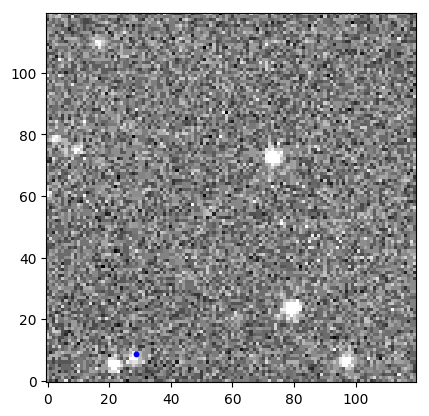

In [12]:
path_to_file = '/home/oem/Documentos/Astronomy/CRTS/Data/CV/second_object/01_06FEB01_N26056_0001_cutout_1431.fits'
hdu_list = fits.open(path_to_file)
image_data = hdu_list[0].data
w = wcs.WCS(hdu_list[0].header)

ind_crds = '172.51287 28.11336'
list_ind_crds = ind_crds.split()
ra_obj = float(list_ind_crds[0])
dec_obj = float(list_ind_crds[1])

inf_value = np.mean(image_data)- 3*np.std(image_data)
sup_value = np.mean(image_data)+ 3*np.std(image_data)
worldcrd_obj = np.array([[ra_obj, dec_obj]]) 
print('World crds OBJ:', worldcrd_obj)
pixcrd_obj = w.wcs_world2pix(worldcrd_obj, 1)
print('Pixel coordinates OBJ:',pixcrd_obj)
x_obj = pixcrd_obj[0,0]
y_obj = pixcrd_obj[0,1]

#f, (ax1, ax2) = plt.subplots(1, 2,)#,  gridspec_kw = {'width_ratios':[3, 1]})
plt.imshow(image_data, cmap='gray',origin='lower', vmin=inf_value, vmax = sup_value)
plt.scatter(x_obj, y_obj, color = 'b', s=10)

In [ ]:
#1. leer data frame por tipo de objeto
obj_type = 'SN'
num_inst = 5
#2. for i in range(0,num_inst):
#3. df_per_object.iloc[i]['Dec']
#4. df_per_object.iloc[i]['Ra']
#5  df_per_object.iloc[i]['CRTS ID']
#   download_images_per_object(df_per_object.iloc[i]['Ra'], df_per_object.iloc[i]['Dec'], obj_type,
#   df_per_object.iloc[i]['CRTS ID'])
#guardar el DF por objeto con sus ims, falta hacer un DF que incluya todos los objetos de un tipo 

